<a href="https://colab.research.google.com/github/pratap-vj/Company-Bankruptcy-Prediction/blob/main/Company_Bankruptcy_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Name**    - Company Bankruptcy Prediction



##### **Project Type**    - Classification
##### **Contribution**    - Individual


# **Project Summary -**

The aim of this project is to develop a predictive model to forecast the likelihood of a company going bankrupt based on historical financial data. The dataset used in this project is sourced from the Taiwan Economic Journal, covering the period from 1999 to 2009, and includes information on various financial attributes of companies listed on the Taiwan Stock Exchange.


The challenge in this project lies in developing a robust predictive model that can accurately identify the minority class instances and overcome the class imbalance issue. The model's performance will be evaluated using appropriate evaluation metrics to assess its effectiveness in predicting bankruptcy.

The successful implementation of this project can have significant implications for financial organizations, business practitioners, investors, and policymakers. By accurately predicting the risk of business failure, informed lending decisions can be made, reducing economic losses and potential impacts on the wider economy.

Throughout the project, various machine learning techniques and algorithms will be explored and evaluated to identify the most effective approach for bankruptcy prediction. The resulting model will provide insights into the financial indicators and patterns that contribute to a company's likelihood of going bankrupt, aiding in proactive risk management and decision-making processes.

# **GitHub Link -**

https://github.com/pratap-vj/Company-Bankruptcy-Prediction

# **Problem Statement**


The problem at hand is to develop a predictive model that accurately forecasts the likelihood of a company going bankrupt based on historical financial data sourced from the Taiwan Economic Journal. The objective is to overcome the challenge of predicting business failures by analyzing financial indicators and market conditions.

This project has implications for financial organizations, investors, and policymakers, as accurate bankruptcy prediction can support informed decision-making in lending, risk management, and policy formulation. The focus is on building a reliable model that can identify companies at high risk of bankruptcy.

The project involves exploring and evaluating various machine learning algorithms to find the most effective approach for bankruptcy prediction. The model's performance will be assessed using appropriate evaluation metrics.

In summary, the aim of this project is to develop a robust predictive model to forecast business failures, providing valuable insights for financial stakeholders in their decision-making processes.

# ***Let's Begin !***

## ***1. Know Your Data***

### Import Libraries

In [ ]:
# Import Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

import scipy.stats as stats
from scipy.stats import ttest_ind

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PowerTransformer

from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import roc_curve, auc

from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

!pip install shap==0.40.0
import shap
import graphviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 371.7/371.7 kB 7.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for shap: filename=shap-0.40.0-cp310-cp310-linux_x86_64.whl size=552512 sha256=11d5fc6183bf2cbf1a9a6e6490e3fc49059966c88eb1a801cd46b2270c97bf7a
  Stored in directory: /root/.cache/pip/wheels/33/28/e3/62a9dc612c58c1b8d1c16fa51e64941bbb38ac8a6decbad39c
Successfully built shap


### Dataset Loading

In [ ]:
# Load Dataset
# Connect with Drive

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# reading Dataset

df = pd.read_csv('/content/drive/MyDrive/COMPANY BANKRUPTCY PREDICTION.csv')

### Dataset First View

In [ ]:
# Dataset First Look
df.head()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,...,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,...,0.795297,0.008323,0.623652,0.610237,0.839969,0.283846,0.264577,0.570175,1,0.020794
2,1,0.426071,0.499019,0.472295,0.601450,0.601364,0.998857,0.796403,0.808388,0.302035,...,0.774670,0.040003,0.623841,0.601449,0.836774,0.290189,0.026555,0.563706,1,0.016474
3,1,0.399844,0.451265,0.457733,0.583541,0.583541,0.998700,0.796967,0.808966,0.303350,...,0.739555,0.003252,0.622929,0.583538,0.834697,0.281721,0.026697,0.564663,1,0.023982
4,1,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,...,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,1,0.035490


In [ ]:
df.tail()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
6814,0,0.493687,0.539468,0.543230,0.604455,0.604462,0.998992,0.797409,0.809331,0.303510,...,0.799927,0.000466,0.623620,0.604455,0.840359,0.279606,0.027064,0.566193,1,0.029890
6815,0,0.475162,0.538269,0.524172,0.598308,0.598308,0.998992,0.797414,0.809327,0.303520,...,0.799748,0.001959,0.623931,0.598306,0.840306,0.278132,0.027009,0.566018,1,0.038284
6816,0,0.472725,0.533744,0.520638,0.610444,0.610213,0.998984,0.797401,0.809317,0.303512,...,0.797778,0.002840,0.624156,0.610441,0.840138,0.275789,0.026791,0.565158,1,0.097649
6817,0,0.506264,0.559911,0.554045,0.607850,0.607850,0.999074,0.797500,0.809399,0.303498,...,0.811808,0.002837,0.623957,0.607846,0.841084,0.277547,0.026822,0.565302,1,0.044009
6818,0,0.493053,0.570105,0.549548,0.627409,0.627409,0.998080,0.801987,0.813800,0.313415,...,0.815956,0.000707,0.626680,0.627408,0.841019,0.275114,0.026793,0.565167,1,0.233902


### Dataset Rows & Columns count

In [ ]:
# Dataset Rows & Columns count
df.shape

(6819, 96)

### Dataset Information

In [ ]:
# Dataset Info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6819 entries, 0 to 6818
Data columns (total 96 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Bankrupt?                                                 6819 non-null   int64  
 1    ROA(C) before interest and depreciation before interest  6819 non-null   float64
 2    ROA(A) before interest and % after tax                   6819 non-null   float64
 3    ROA(B) before interest and depreciation after tax        6819 non-null   float64
 4    Operating Gross Margin                                   6819 non-null   float64
 5    Realized Sales Gross Margin                              6819 non-null   float64
 6    Operating Profit Rate                                    6819 non-null   float64
 7    Pre-tax net Interest Rate                                6819 non-null   float64
 8    After-tax net Int

#### Duplicate Values

In [ ]:
# Dataset Duplicate Value Count
df[df.duplicated()]

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability


#### Missing Values/Null Values

In [ ]:
# Missing Values/Null Values Count
df.isnull().sum()

Bankrupt?                                                   0
 ROA(C) before interest and depreciation before interest    0
 ROA(A) before interest and % after tax                     0
 ROA(B) before interest and depreciation after tax          0
 Operating Gross Margin                                     0
                                                           ..
 Liability to Equity                                        0
 Degree of Financial Leverage (DFL)                         0
 Interest Coverage Ratio (Interest expense to EBIT)         0
 Net Income Flag                                            0
 Equity to Liability                                        0
Length: 96, dtype: int64

In [ ]:
# Missing Value Count Function
def show_missing():
    missing = df.columns[df.isnull().any()].tolist()
    return missing

# Missing data counts and percentage
print('Missing Data Count')
print(df[show_missing()].isnull().sum().sort_values(ascending = False))
print('--'*50)
print('Missing Data Percentage')
print(round(df[show_missing()].isnull().sum().sort_values(ascending = False)/len(df)*100,2))

Missing Data Count
Series([], dtype: float64)
----------------------------------------------------------------------------------------------------
Missing Data Percentage
Series([], dtype: float64)


<Axes: >

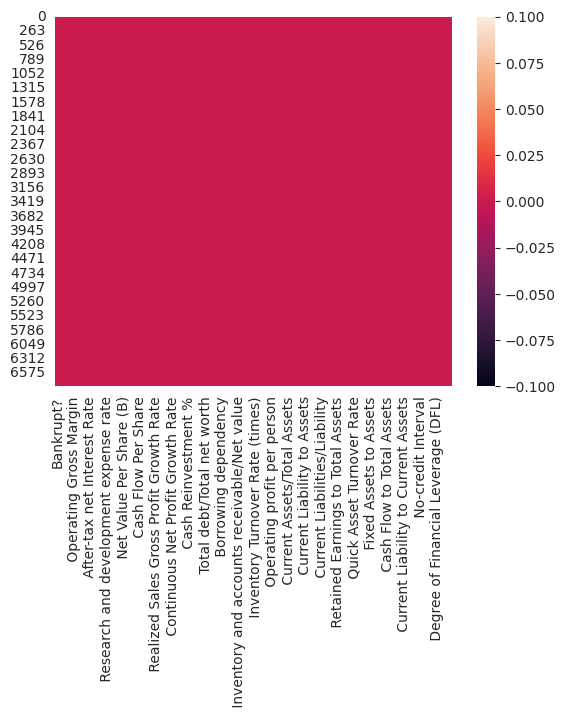

In [ ]:
# Visualizing the missing values
sns.heatmap(df.isnull())

### What did you know about your dataset?

The data were collected from the Taiwan Economic Journal for the years 1999 to 2009. Company bankruptcy was defined based on the business regulations of the Taiwan Stock Exchange.


Overall, the dataset consists of 6819 rows and 96 columns. There are no null values, duplicate values and missing values in the data.

## ***2. Understanding Your Variables***

In [ ]:
# Dataset Columns
df.columns.values

array(['Bankrupt?',
       ' ROA(C) before interest and depreciation before interest',
       ' ROA(A) before interest and % after tax',
       ' ROA(B) before interest and depreciation after tax',
       ' Operating Gross Margin', ' Realized Sales Gross Margin',
       ' Operating Profit Rate', ' Pre-tax net Interest Rate',
       ' After-tax net Interest Rate',
       ' Non-industry income and expenditure/revenue',
       ' Continuous interest rate (after tax)', ' Operating Expense Rate',
       ' Research and development expense rate', ' Cash flow rate',
       ' Interest-bearing debt interest rate', ' Tax rate (A)',
       ' Net Value Per Share (B)', ' Net Value Per Share (A)',
       ' Net Value Per Share (C)',
       ' Persistent EPS in the Last Four Seasons', ' Cash Flow Per Share',
       ' Revenue Per Share (Yuan ¥)',
       ' Operating Profit Per Share (Yuan ¥)',
       ' Per Share Net profit before tax (Yuan ¥)',
       ' Realized Sales Gross Profit Growth Rate',
       ' Op

In [ ]:
# Dataset Describe
df.describe(include = 'all').T

,count,mean,std,min,25%,50%,75%,max
Bankrupt?,6819.0,0.032263,0.176710,0.0,0.000000,0.000000,0.000000,1.0
ROA(C) before interest and depreciation before interest,6819.0,0.505180,0.060686,0.0,0.476527,0.502706,0.535563,1.0
ROA(A) before interest and % after tax,6819.0,0.558625,0.065620,0.0,0.535543,0.559802,0.589157,1.0
ROA(B) before interest and depreciation after tax,6819.0,0.553589,0.061595,0.0,0.527277,0.552278,0.584105,1.0
Operating Gross Margin,6819.0,0.607948,0.016934,0.0,0.600445,0.605997,0.613914,1.0
...,...,...,...,...,...,...,...,...
Liability to Equity,6819.0,0.280365,0.014463,0.0,0.276944,0.278778,0.281449,1.0
Degree of Financial Leverage (DFL),6819.0,0.027541,0.015668,0.0,0.026791,0.026808,0.026913,1.0
Interest Coverage Ratio (Interest expense to EBIT),6819.0,0.565358,0.013214,0.0,0.565158,0.565252,0.565725,1.0
Net Income Flag,6819.0,1.000000,0.000000,1.0,1.000000,1.000000,1.000000,1.0


### Variables Description

 - Bankrupt?: Class label
 - ROA(C) before interest and depreciation before interest: Return On Total Assets(C)
 - ROA(A) before interest and % after tax: Return On Total Assets(A)
 - ROA(B) before interest and depreciation after tax: Return On Total Assets(B)
 - Operating Gross Margin: Gross Profit/Net Sales
 - Realized Sales Gross Margin: Realized Gross Profit/Net Sales
 - Operating Profit Rate: Operating Income/Net Sales
 - Pre-tax net Interest Rate: Pre-Tax Income/Net Sales
 - After-tax net Interest Rate: Net Income/Net Sales
 - Non-industry income and expenditure/revenue: Net Non-operating Income Ratio
 - Continuous interest rate (after tax): Net Income-Exclude Disposal Gain or Loss/Net Sales
 - Operating Expense Rate: Operating Expenses/Net Sales
 - Research and development expense rate: (Research and Development Expenses)/Net Sales
 - Cash flow rate: Cash Flow from Operating/Current Liabilities
 - Interest-bearing debt interest rate: Interest-bearing Debt/Equity
 - Tax rate (A): Effective Tax Rate
 - Net Value Per Share (B): Book Value Per Share(B)
 - Net Value Per Share (A): Book Value Per Share(A)
 - Net Value Per Share (C): Book Value Per Share(C)
 - Persistent EPS in the Last Four Seasons: EPS-Net Income
 - Cash Flow Per Share
 - Revenue Per Share (Yuan ¥): Sales Per Share
 - Operating Profit Per Share (Yuan ¥): Operating Income Per Share
 - Per Share Net profit before tax (Yuan ¥): Pretax Income Per Share
 - Realized Sales Gross Profit Growth Rate
 - Operating Profit Growth Rate: Operating Income Growth
 - After-tax Net Profit Growth Rate: Net Income Growth
 - Regular Net Profit Growth Rate: Continuing Operating Income after Tax Growth
 - Continuous Net Profit Growth Rate: Net Income-Excluding Disposal Gain or Loss Growth
 - Total Asset Growth Rate: Total Asset Growth
 - Net Value Growth Rate: Total Equity Growth
 - Total Asset Return Growth Rate Ratio: Return on Total Asset Growth
 - Cash Reinvestment %: Cash Reinvestment Ratio
 - Current Ratio
 - Quick Ratio: Acid Test
 - Interest Expense Ratio: Interest Expenses/Total Revenue
 - Total debt/Total net worth: Total Liability/Equity Ratio
 - Debt ratio %: Liability/Total Assets
 - Net worth/Assets: Equity/Total Assets
 - Long-term fund suitability ratio (A): (Long-term Liability+Equity)/Fixed Assets
 - Borrowing dependency: Cost of Interest-bearing Debt
 - Contingent liabilities/Net worth: Contingent Liability/Equity
 - Operating profit/Paid-in capital: Operating Income/Capital
 - Net profit before tax/Paid-in capital: Pretax Income/Capital
 - Inventory and accounts receivable/Net value: (Inventory+Accounts Receivables)/Equity
 - Total Asset Turnover
 - Accounts Receivable Turnover
 - Average Collection Days: Days Receivable Outstanding
 - Inventory Turnover Rate (times)
 - Fixed Assets Turnover Frequency
 - Net Worth Turnover Rate (times): Equity Turnover
 - Revenue per person: Sales Per Employee
 - Operating profit per person: Operation Income Per Employee
 - Allocation rate per person: Fixed Assets Per Employee
 - Working Capital to Total Assets
 - Quick Assets/Total Assets
 - Current Assets/Total Assets
 - Cash/Total Assets
 - Quick Assets/Current Liability
 - Cash/Current Liability
 - Current Liability to Assets
 - Operating Funds to Liability
 - Inventory/Working Capital
 - Inventory/Current Liability
 - Current Liabilities/Liability
 - Working Capital/Equity
 - Current Liabilities/Equity
 - Long-term Liability to Current Assets
 - Retained Earnings to Total Assets
 - Total income/Total expense
 - Total expense/Assets
 - Current Asset Turnover Rate: Current Assets to Sales
 - Quick Asset Turnover Rate: Quick Assets to Sales
 - Working capitcal Turnover Rate: Working Capital to Sales
 - Cash Turnover Rate: Cash to Sales
 - Cash Flow to Sales
 - Fixed Assets to Assets
 - Current Liability to Liability
 - Current Liability to Equity
 - Equity to Long-term Liability
 - Cash Flow to Total Assets
 - Cash Flow to Liability
 - CFO to Assets
 - Cash Flow to Equity
 - Current Liability to Current Assets
 - Liability-Assets Flag: 1 if Total Liability exceeds Total Assets, 0 otherwise
 - Net Income to Total Assets
 - Total assets to GNP price
 - No-credit Interval
 - Gross Profit to Sales
 - Net Income to Stockholder's Equity
 - Liability to Equity
 - Degree of Financial Leverage (DFL)
 - Interest Coverage Ratio (Interest expense to EBIT)
 - Net Income Flag: 1 if Net Income is Negative for the last two years, 0 otherwise
 - Equity to Liability



### Check Unique Values for each variable.

In [ ]:

# Check Unique Values for each variable.
for i in df.columns.tolist():
  print("No. of unique values in ",i,"is",df[i].nunique(),".")

No. of unique values in  Bankrupt? is 2 .
No. of unique values in   ROA(C) before interest and depreciation before interest is 3333 .
No. of unique values in   ROA(A) before interest and % after tax is 3151 .
No. of unique values in   ROA(B) before interest and depreciation after tax is 3160 .
No. of unique values in   Operating Gross Margin is 3781 .
No. of unique values in   Realized Sales Gross Margin is 3788 .
No. of unique values in   Operating Profit Rate is 3376 .
No. of unique values in   Pre-tax net Interest Rate is 3789 .
No. of unique values in   After-tax net Interest Rate is 3604 .
No. of unique values in   Non-industry income and expenditure/revenue is 2551 .
No. of unique values in   Continuous interest rate (after tax) is 3617 .
No. of unique values in   Operating Expense Rate is 2966 .
No. of unique values in   Research and development expense rate is 1536 .
No. of unique values in   Cash flow rate is 5557 .
No. of unique values in   Interest-bearing debt interest rate

## 3. ***Data Wrangling***

### Data Wrangling Code

In [ ]:
# Write your code to make your dataset analysis ready.
df_2 = df.copy()

In [ ]:
#  remove this ? to have an appropriate column name.
df_2.rename(columns = {'Bankrupt?':'Bankrupt'}, inplace = True)
df_2.head()

,Bankrupt,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,...,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,...,0.795297,0.008323,0.623652,0.610237,0.839969,0.283846,0.264577,0.570175,1,0.020794
2,1,0.426071,0.499019,0.472295,0.601450,0.601364,0.998857,0.796403,0.808388,0.302035,...,0.774670,0.040003,0.623841,0.601449,0.836774,0.290189,0.026555,0.563706,1,0.016474
3,1,0.399844,0.451265,0.457733,0.583541,0.583541,0.998700,0.796967,0.808966,0.303350,...,0.739555,0.003252,0.622929,0.583538,0.834697,0.281721,0.026697,0.564663,1,0.023982
4,1,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,...,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,1,0.035490


In [ ]:
# Seperate dependent and independent variables
X=df_2.drop(labels=['Bankrupt'], axis=1)
y=df_2['Bankrupt']

In [ ]:
# Checking columns in independent variables
X.columns

Index([' ROA(C) before interest and depreciation before interest',
       ' ROA(A) before interest and % after tax',
       ' ROA(B) before interest and depreciation after tax',
       ' Operating Gross Margin', ' Realized Sales Gross Margin',
       ' Operating Profit Rate', ' Pre-tax net Interest Rate',
       ' After-tax net Interest Rate',
       ' Non-industry income and expenditure/revenue',
       ' Continuous interest rate (after tax)', ' Operating Expense Rate',
       ' Research and development expense rate', ' Cash flow rate',
       ' Interest-bearing debt interest rate', ' Tax rate (A)',
       ' Net Value Per Share (B)', ' Net Value Per Share (A)',
       ' Net Value Per Share (C)', ' Persistent EPS in the Last Four Seasons',
       ' Cash Flow Per Share', ' Revenue Per Share (Yuan ¥)',
       ' Operating Profit Per Share (Yuan ¥)',
       ' Per Share Net profit before tax (Yuan ¥)',
       ' Realized Sales Gross Profit Growth Rate',
       ' Operating Profit Growth Rate'

In [ ]:
# Describing independent variables
X.describe().T

,count,mean,std,min,25%,50%,75%,max
ROA(C) before interest and depreciation before interest,6819.0,0.505180,0.060686,0.0,0.476527,0.502706,0.535563,1.0
ROA(A) before interest and % after tax,6819.0,0.558625,0.065620,0.0,0.535543,0.559802,0.589157,1.0
ROA(B) before interest and depreciation after tax,6819.0,0.553589,0.061595,0.0,0.527277,0.552278,0.584105,1.0
Operating Gross Margin,6819.0,0.607948,0.016934,0.0,0.600445,0.605997,0.613914,1.0
Realized Sales Gross Margin,6819.0,0.607929,0.016916,0.0,0.600434,0.605976,0.613842,1.0
...,...,...,...,...,...,...,...,...
Liability to Equity,6819.0,0.280365,0.014463,0.0,0.276944,0.278778,0.281449,1.0
Degree of Financial Leverage (DFL),6819.0,0.027541,0.015668,0.0,0.026791,0.026808,0.026913,1.0
Interest Coverage Ratio (Interest expense to EBIT),6819.0,0.565358,0.013214,0.0,0.565158,0.565252,0.565725,1.0
Net Income Flag,6819.0,1.000000,0.000000,1.0,1.000000,1.000000,1.000000,1.0


In [ ]:
# Describing dependent variables
y.value_counts()

0    6599
1     220
Name: Bankrupt, dtype: int64

### What all manipulations have you done and insights you found?

The dataset contains a target variable named "Bankrupt?" with an imbalanced class distribution. The class labels are represented as 0 and 1, where 0 indicates non-bankrupt cases and 1 represents bankrupt cases. However, the target column name contains an unnecessary "?" symbol, which needs to be removed to ensure an appropriate column name.

To address the imbalanced class distribution, various techniques can be applied. One approach is to use resampling methods such as oversampling the minority class (bankrupt cases) or undersampling the majority class (non-bankrupt cases) to create a more balanced representation of the classes. This helps prevent bias towards the majority class during model training.

Additionally, evaluation metrics and techniques specifically designed for imbalanced datasets can be utilized to assess model performance. These include metrics such as precision, recall, F1 score, and area under the receiver operating characteristic curve (AUC-ROC). Model selection and hyperparameter tuning can be performed considering the imbalanced nature of the target variable.

Furthermore, the unnecessary "?" symbol in the target column name should be removed to maintain consistency and improve readability. This can be achieved by renaming the target column to "Bankrupt" without the "?" symbol, ensuring a more appropriate and standardized column name.



## ***4. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

#### Chart - 1  Pie Chart on Dependant Variable i.e., Bankrupt (Univariate)-

0    6599
1     220
Name: Bankrupt, dtype: int64
 


<Axes: ylabel='Bankrupt'>

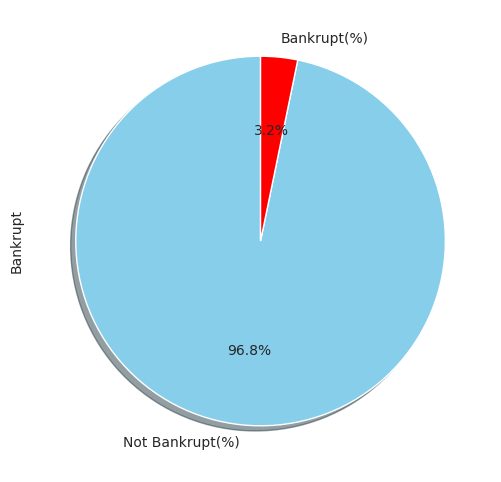

In [ ]:
# Chart - 1 visualization code
# Dependant Column Value Counts
print(df_2.Bankrupt.value_counts())
print(" ")
# Dependant Variable Column Visualization
df_2['Bankrupt'].value_counts().plot(kind='pie',
                              figsize=(15,6),
                               autopct="%1.1f%%",
                               startangle=90,
                               shadow=True,
                               labels=['Not Bankrupt(%)','Bankrupt(%)'],
                               colors=['skyblue','red'],
                               explode=[0,0]
                              )

##### 1. Why did you pick the specific chart?

A pie chart expresses a part-to-whole relationship in your data. It's easy to explain the percentage comparison through area covered in a circle with different colors. Where differenet percentage comparison comes into action pie chart is used frequently. So, I used Pie chart and which helped me to get the percentage comparision of the dependant variable.

##### 2. What is/are the insight(s) found from the chart?


From the chart, the insights found are:

**Imbalanced Class Distribution:** The chart shows that the target variable "Bankrupt" has a highly imbalanced class distribution. The majority class (0) represents non-bankrupt cases, with 6,599 instances, while the minority class (1) represents bankrupt cases, with only 220 instances. This significant class imbalance indicates that the dataset contains a much larger proportion of non-bankrupt cases compared to bankrupt cases.

**Class Imbalance Impact:** The class imbalance can have implications for modeling and analysis. It suggests that the dataset is skewed towards non-bankrupt cases, potentially leading to a biased model that may not perform well in accurately predicting the minority class (bankrupt cases). Addressing the class imbalance is crucial to ensure that the model is capable of capturing patterns and making accurate predictions for both classes.

**Minority Class Identification:** The chart highlights the challenge of identifying and accurately predicting bankrupt cases due to their limited representation in the dataset. The small number of instances in the minority class poses a difficulty in capturing the distinctive patterns and characteristics associated with bankrupt companies.

These insights emphasize the need to handle the class imbalance appropriately during model training and evaluation. Techniques such as oversampling, undersampling, or utilizing class weightings can be employed to mitigate the impact of class imbalance and improve the model's ability to predict bankrupt cases effectively.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.


The gained insights regarding the imbalanced class distribution of the target variable "Bankrupt" can indeed help create a positive business impact. Here's how:

**Positive Business Impact:** By recognizing the imbalanced class distribution and understanding the limited representation of bankrupt cases, businesses and financial organizations can develop more robust risk management strategies. They can allocate resources and implement measures to proactively identify and mitigate the risks associated with potential bankruptcies. This can help them make informed decisions regarding lending, investment, and partnerships, reducing financial losses and minimizing the negative impact on the overall business performance.

**Negative Growth Insights:** While the insights themselves do not lead to negative growth, the imbalanced class distribution itself can pose challenges and potential negative consequences if not appropriately addressed. If the class imbalance is not properly accounted for during model training and evaluation, it can result in a biased model that predominantly predicts the majority class (non-bankrupt cases). This can lead to a higher likelihood of false negatives, where actual bankrupt cases are misclassified as non-bankrupt, potentially resulting in financial losses or missed opportunities for risk mitigation.

To address this potential negative growth impact, it is crucial to implement strategies that specifically address the class imbalance, such as resampling techniques or utilizing evaluation metrics that are sensitive to imbalanced data. By doing so, businesses can improve the performance and reliability of bankruptcy prediction models, leading to more accurate identification of both bankrupt and non-bankrupt cases and minimizing the risk of negative growth or financial losses.

#### Chart - 2  column wise histogram and box plot(univariate)-

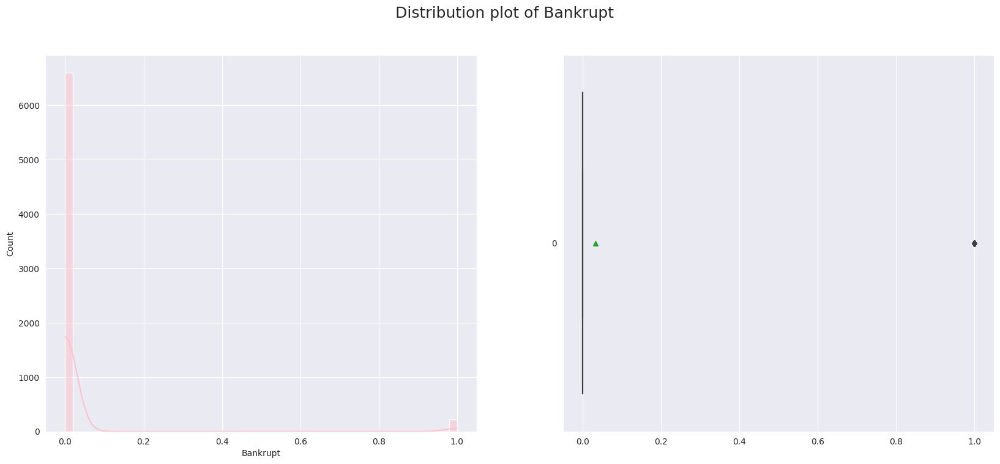

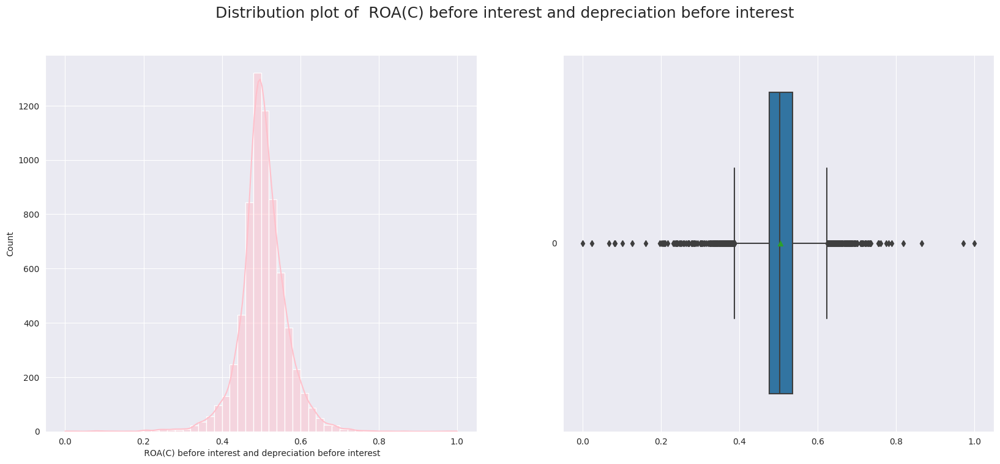

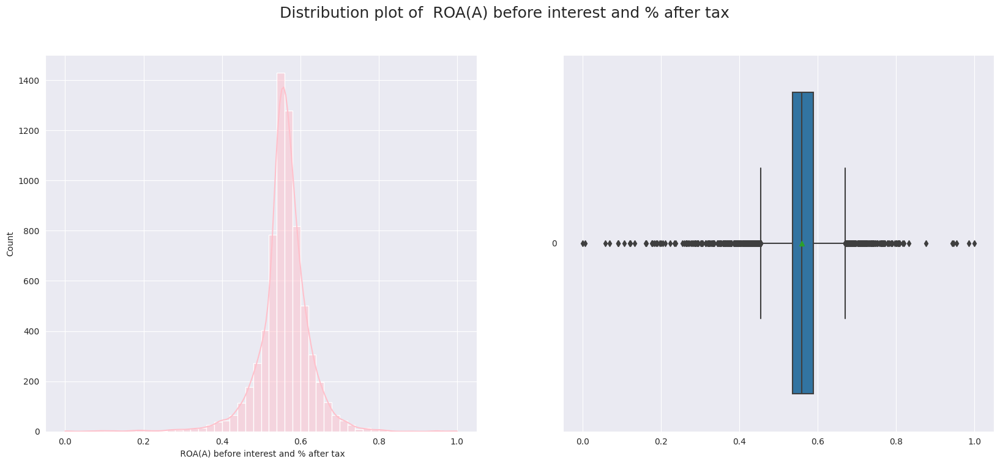

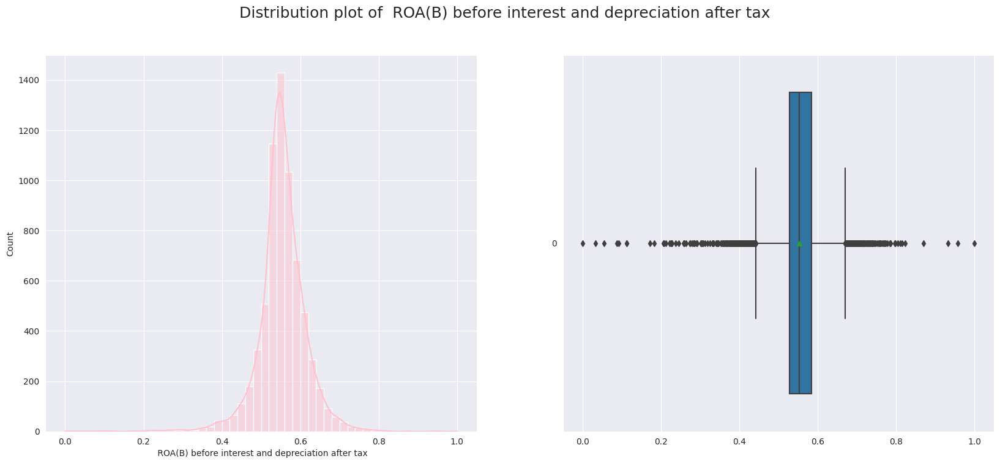

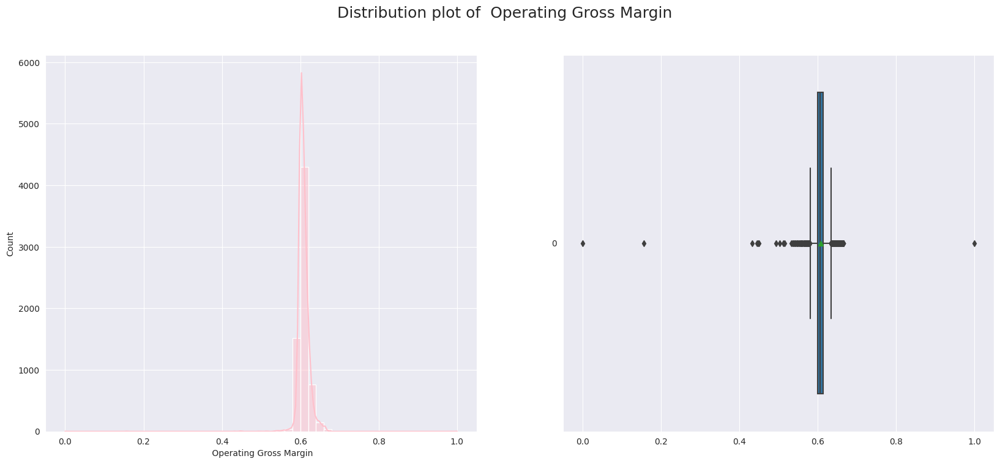

...

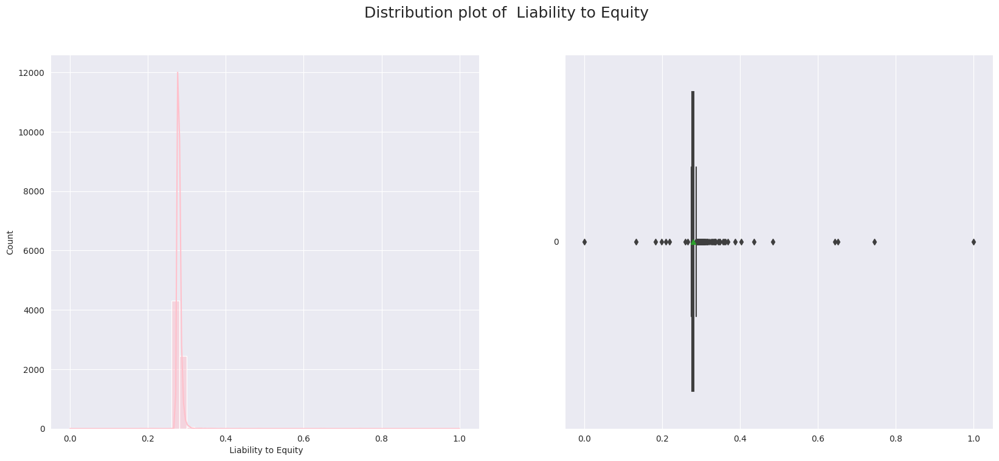

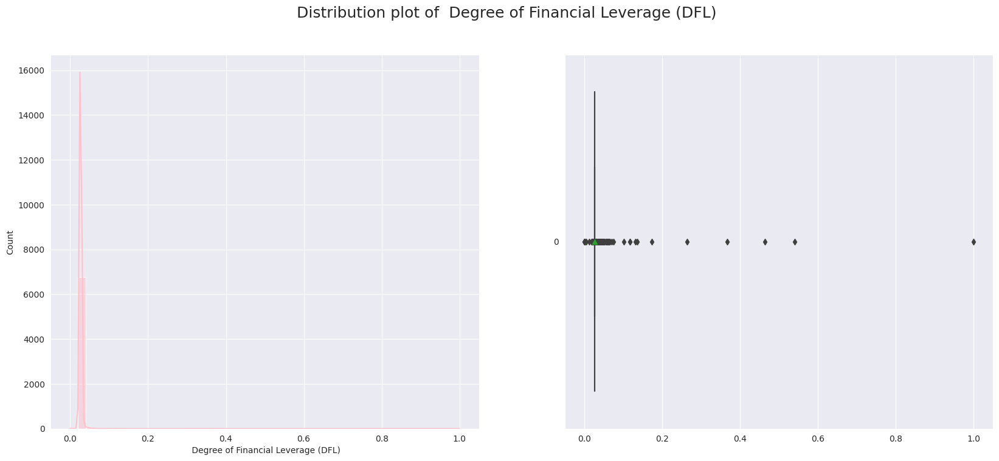

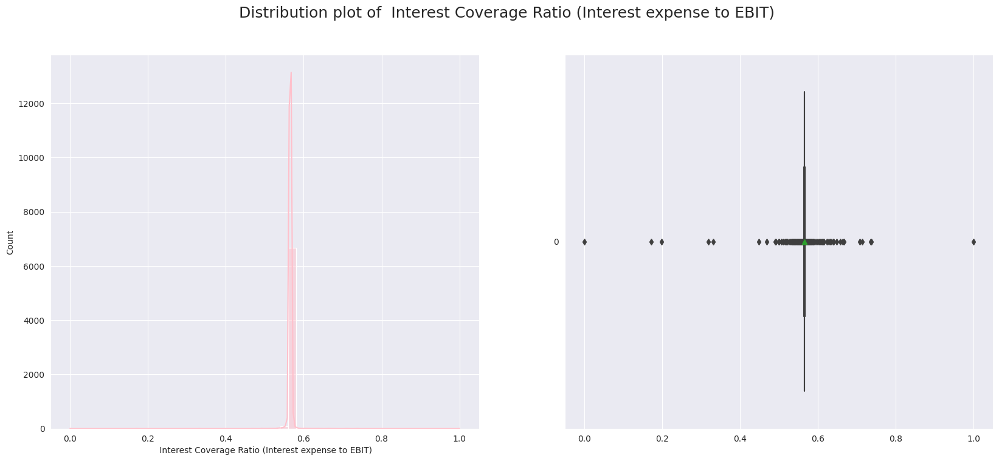

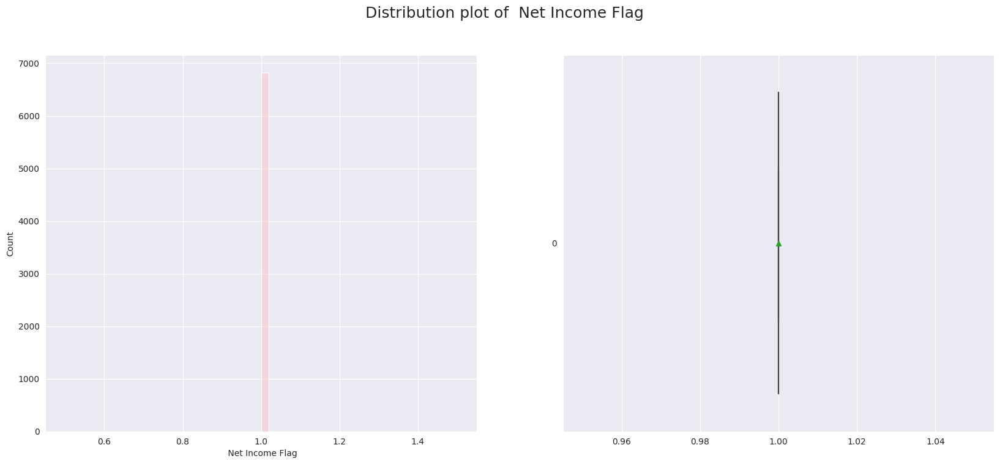

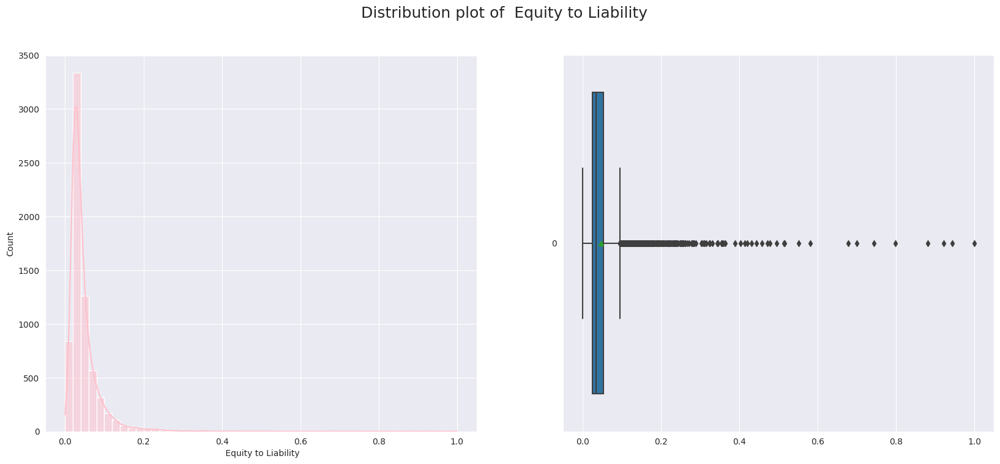

In [ ]:
# Chart - 2 visualization code

# Visualizing code of histogram and boxplot for each columns to know the data distribution-
for col in df_2.describe().columns:
  fig,axes = plt.subplots(1,2,figsize=(20,8))
  sns.histplot(df_2[col],ax = axes[0],kde = True,color= 'pink',bins=50)
  sns.boxplot(df_2[col],ax = axes[1],orient ='h',showmeans = True)
  fig.suptitle("Distribution plot of "+ col,fontsize = 18)
  plt.show()

##### 1. Why did you pick the specific chart?

The histogram is a popular graphing tool. It is used to summarize discrete or continuous data that are measured on an interval scale. It is often used to illustrate the major features of the distribution of the data in a convenient form. It is also useful when dealing with large data sets (greater than 100 observations). It can help detect any unusual observations (outliers) or any gaps in the data.

Thus, I used the histogram plot to analysis the variable distributions over the whole dataset whether it's symmetric or not.

Box plots are used to show distributions of numeric data values, especially when you want to compare them between multiple groups. They are built to provide high-level information at a glance, offering general information about a group of data's symmetry, skew, variance, and outliers.

Thus, for each numerical varibale in the given dataset, I used box plot to analyse the outliers and interquartile range including mean, median, maximum and minimum value.

##### 2. What is/are the insight(s) found from the chart?

**Insights from Boxplot-**
- Inventory
Turnover
Rate
(times) has no outliers.

- Current
Assets/Total
Assets has no outliers.

- Quick
Asset
Turnover
Rate has no outliers.

- Cash
Turnover
Rate has no outliers.

- Rest all variables have outliers.  Cap them or remove them.

**Insights from Histogram-**

 Some of the variables are not normally distributed which needs further evaluation.


##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Just a histogram and box plot cannot define business impact. It's done just to see the distribution of the column data over the dataset.

#### Chart - 3  Histogram for features-

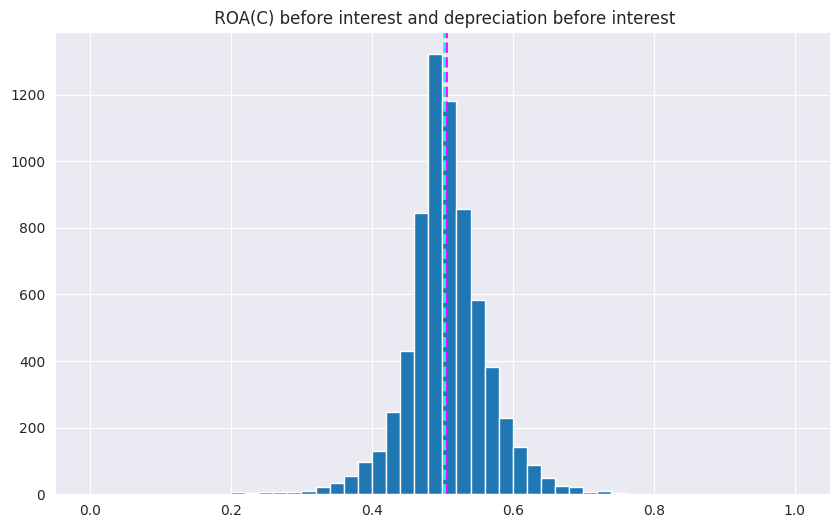

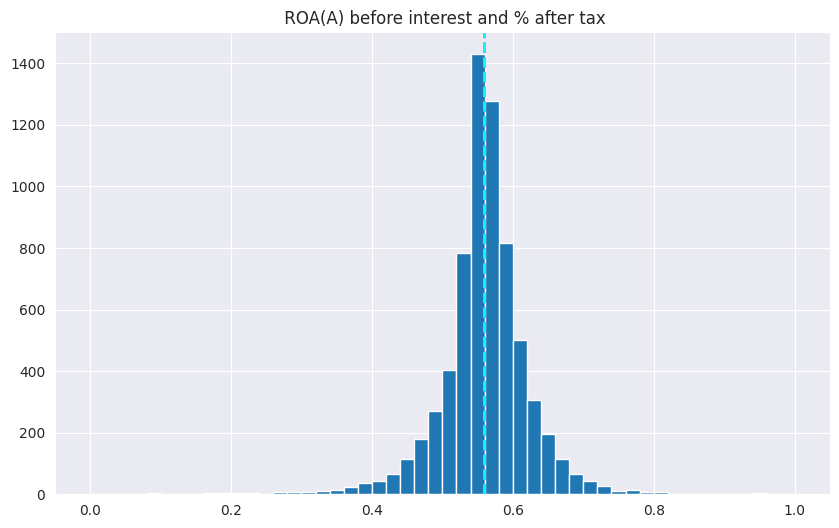

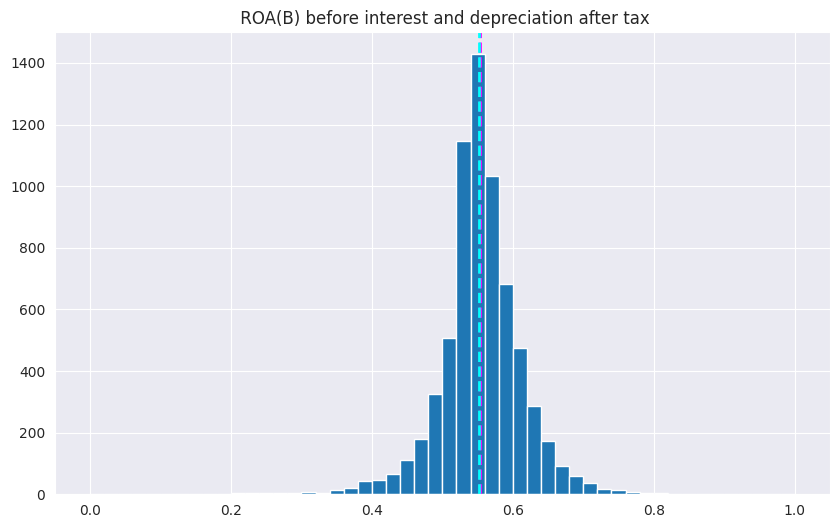

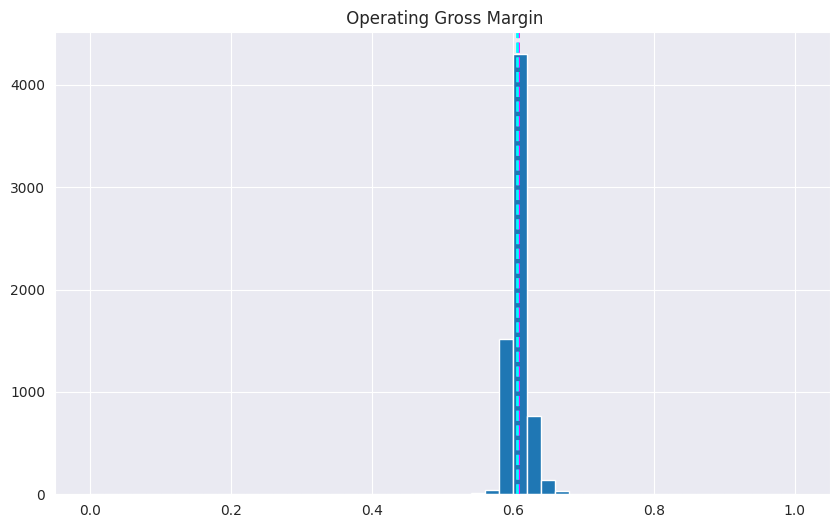

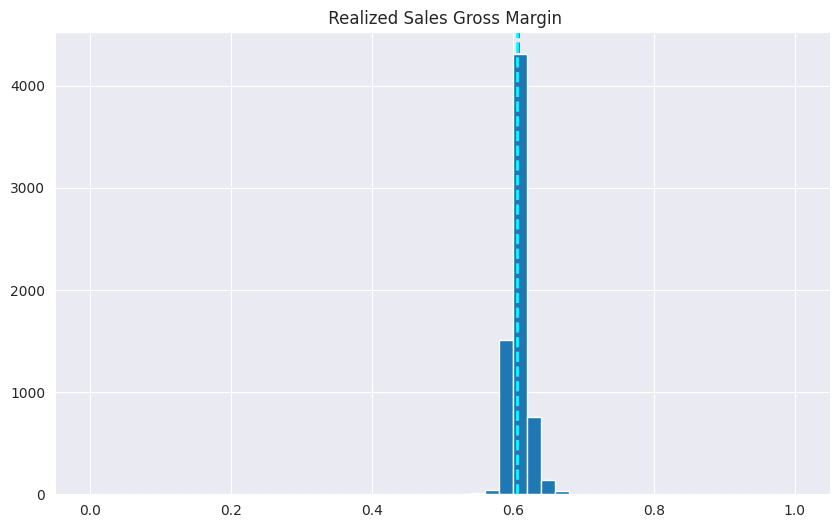

...

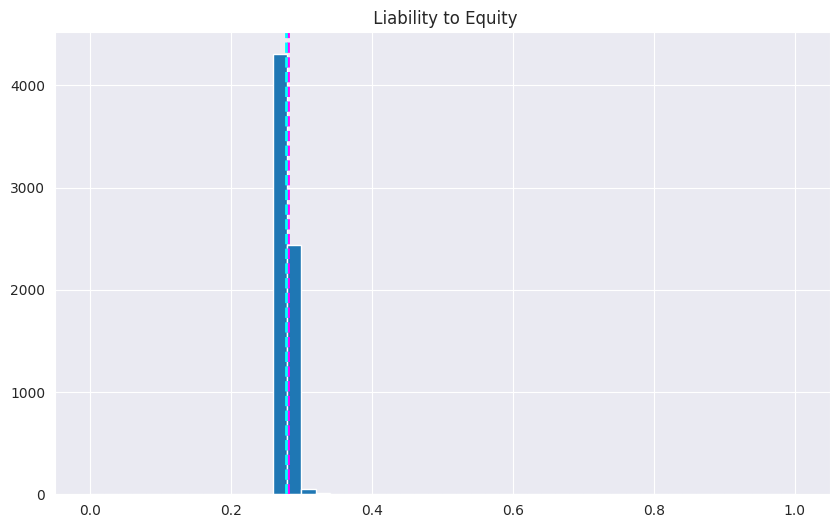

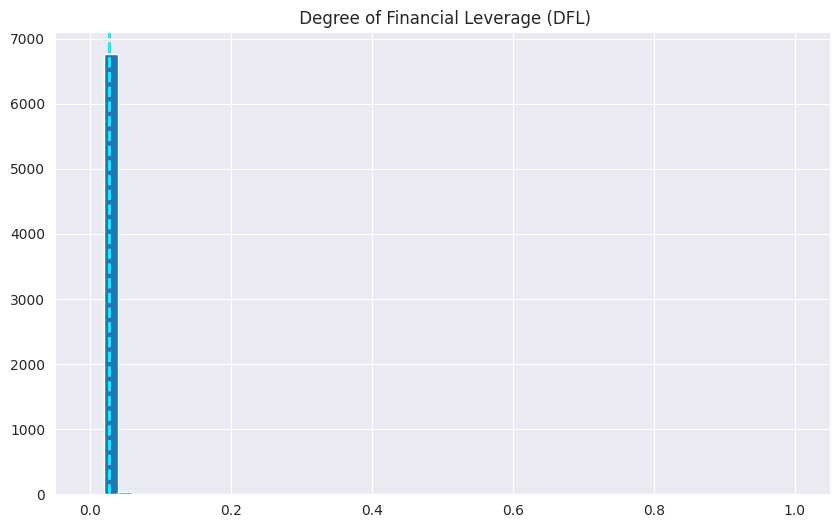

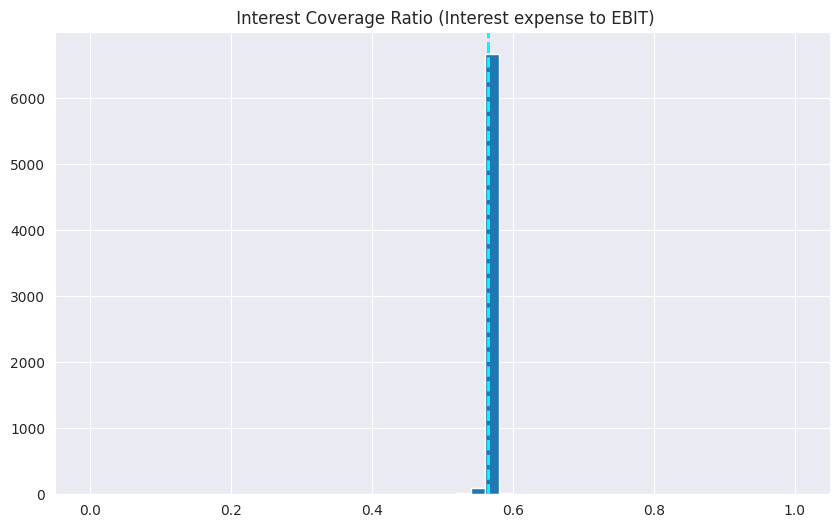

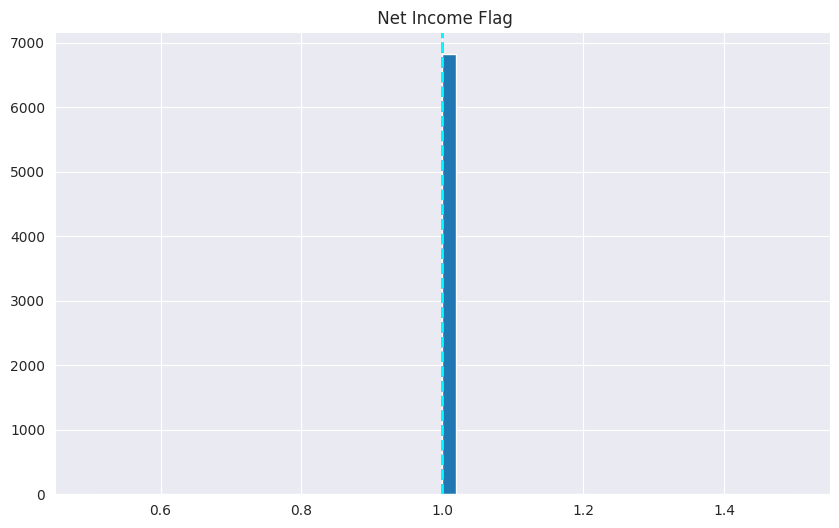

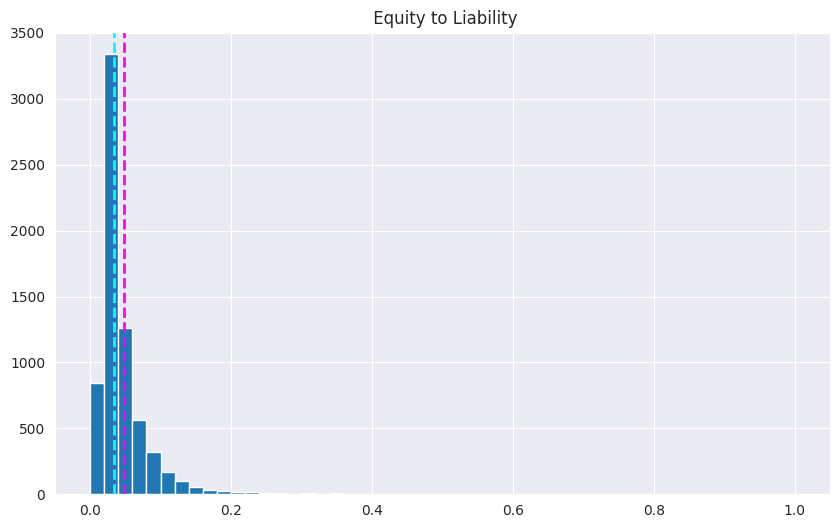

In [ ]:
# Chart - 3 visualization code
# visualization code for histogram of features.
for col in X:
    fig = plt.figure(figsize=(10, 6))
    ax = fig.gca()
    feature = df_2[col]
    feature.hist(bins=50, ax = ax)
    ax.axvline(feature.mean(), color='magenta', linestyle='dashed', linewidth=2)
    ax.axvline(feature.median(), color='cyan', linestyle='dashed', linewidth=2)
    ax.set_title(col)
plt.show()


##### 1. Why did you pick the specific chart?

Histograms are commonly used in statistics to demonstrate how many of a certain type of variable occur within a specific range.

##### 2. What is/are the insight(s) found from the chart?

These graphs shows the distribution of independent variables. Mean is nearly equal to mode for all variables.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

In this case, the insights gained from the analysis may not directly help in creating a positive business impact.

#### Chart - 4 Correlation plot between Independent and dependent variable-

Bankrupt - ROA(C) before interest and depreciation before interest- correlation: -0.26080655752026
Bankrupt - ROA(A) before interest and % after tax- correlation: -0.2829405849344862
Bankrupt - ROA(B) before interest and depreciation after tax- correlation: -0.2730513178632925
Bankrupt - Operating Gross Margin- correlation: -0.10004324405173273
Bankrupt - Realized Sales Gross Margin- correlation: -0.09944524958861489
Bankrupt - Operating Profit Rate- correlation: -0.00022981739906447883
Bankrupt - Pre-tax net Interest Rate- correlation: -0.008516547957062876
Bankrupt - After-tax net Interest Rate- correlation: -0.008857223259672534
Bankrupt - Non-industry income and expenditure/revenue- correlation: -0.01659263759118038
Bankrupt - Continuous interest rate (after tax)- correlation: -0.008394858991381416
Bankrupt - Operating Expense Rate- correlation: -0.0060832255091248285
Bankrupt - Research and development expense rate- correlation: -0.024231968358059488
Bankrupt - Cash flow rate- cor

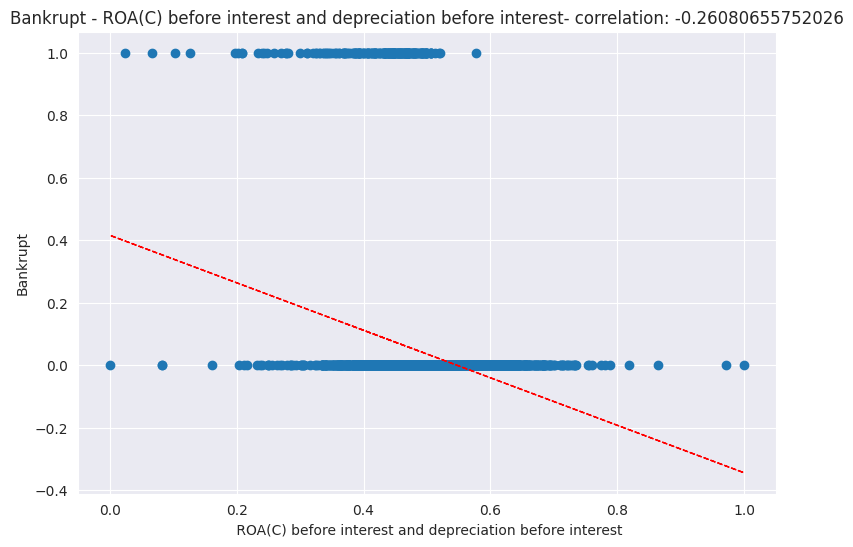

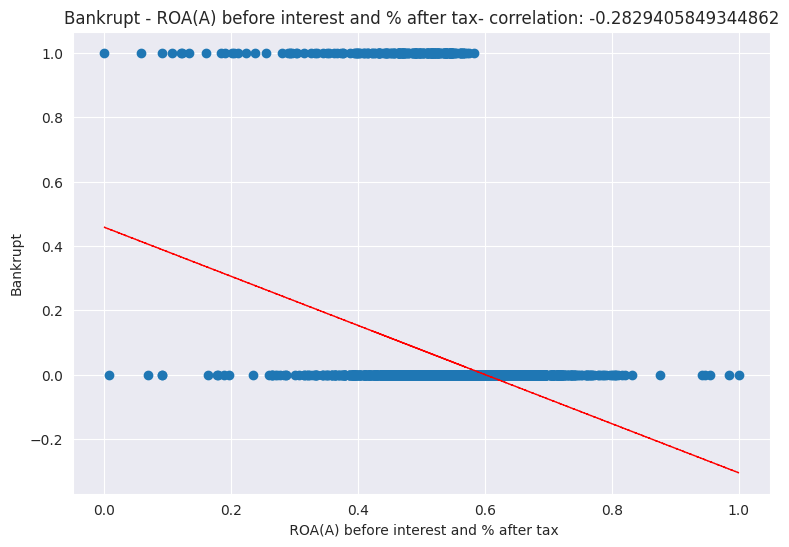

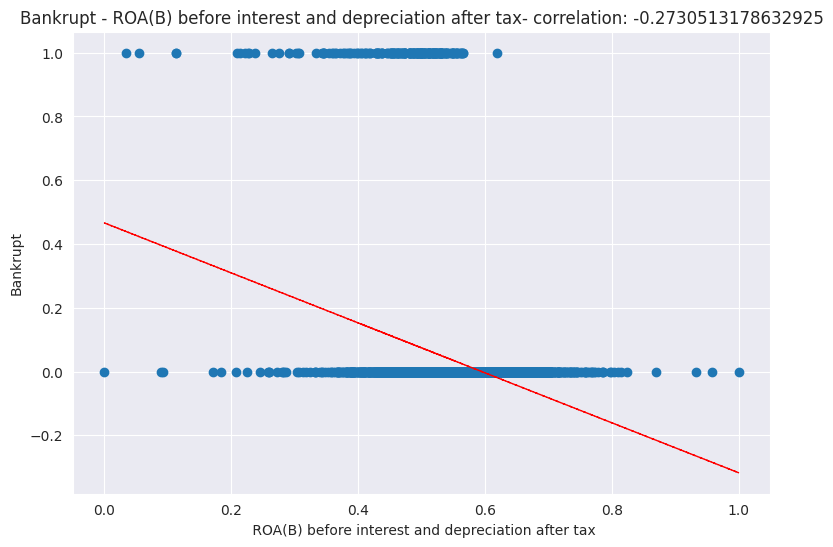

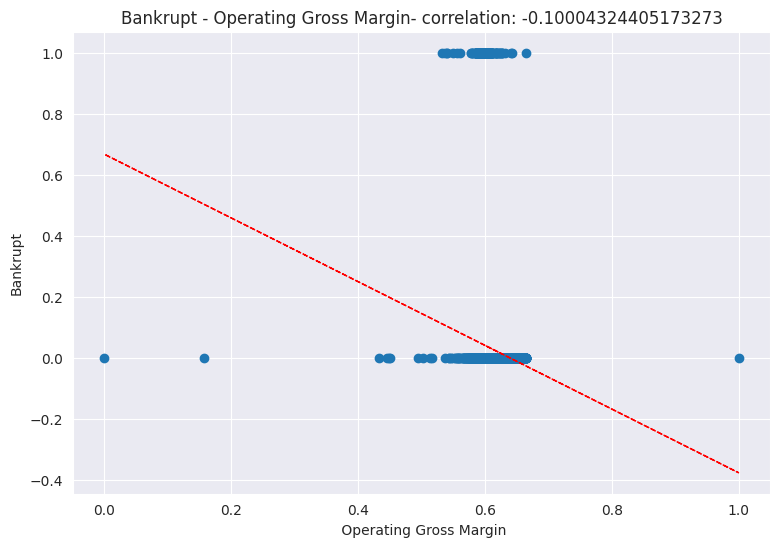

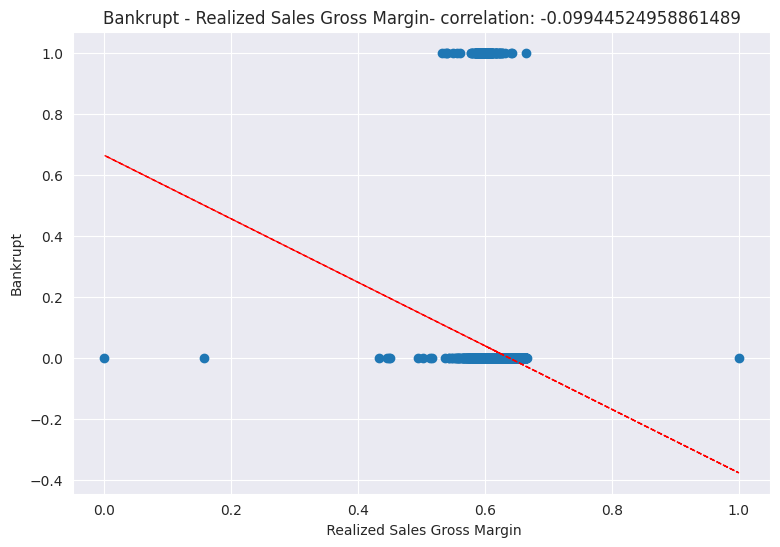

...

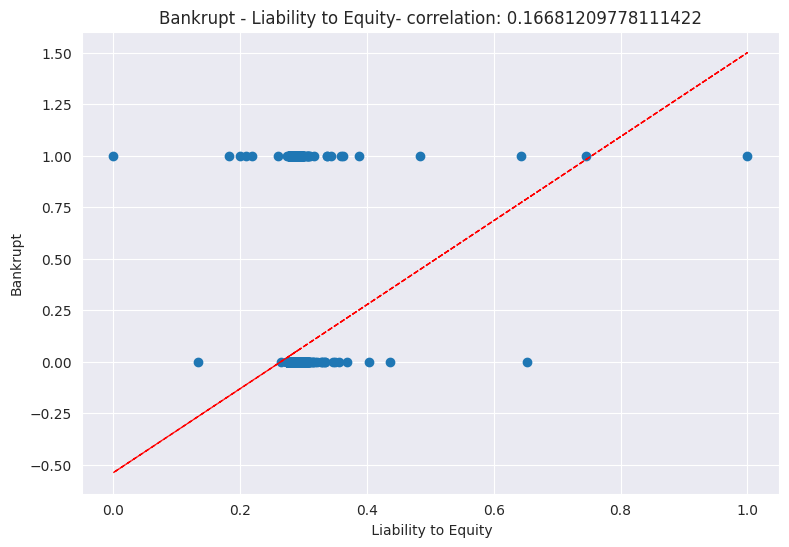

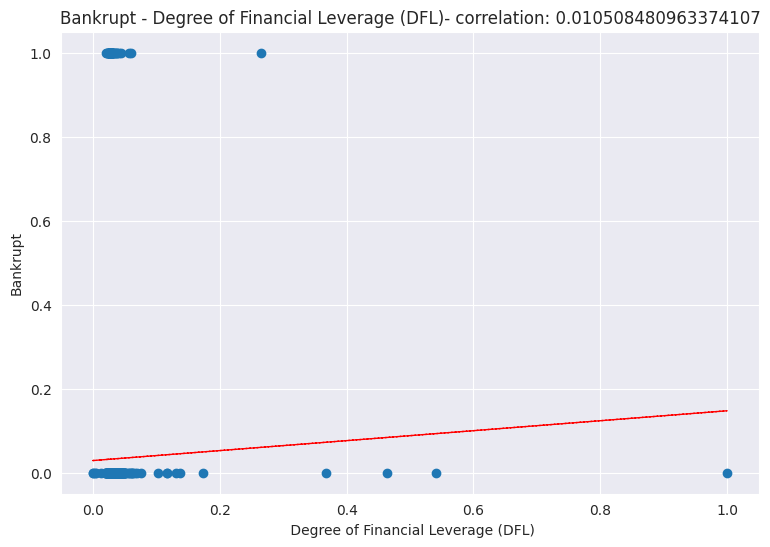

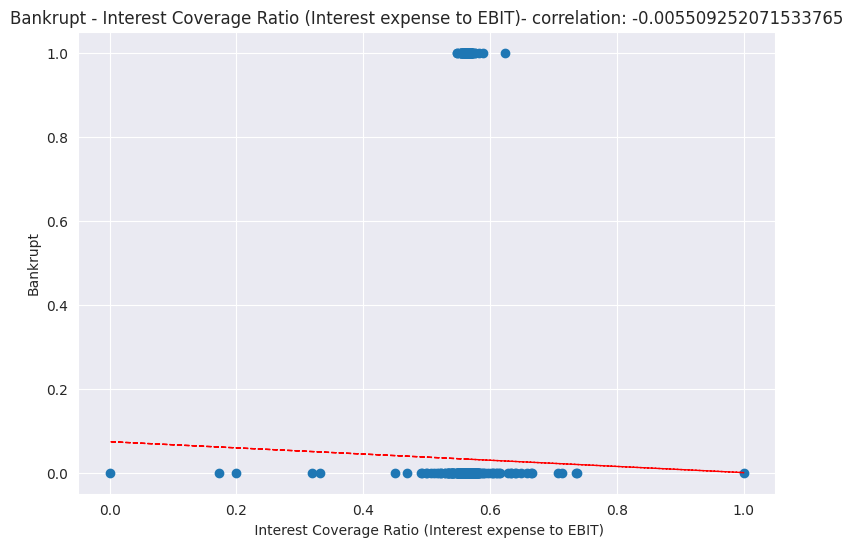

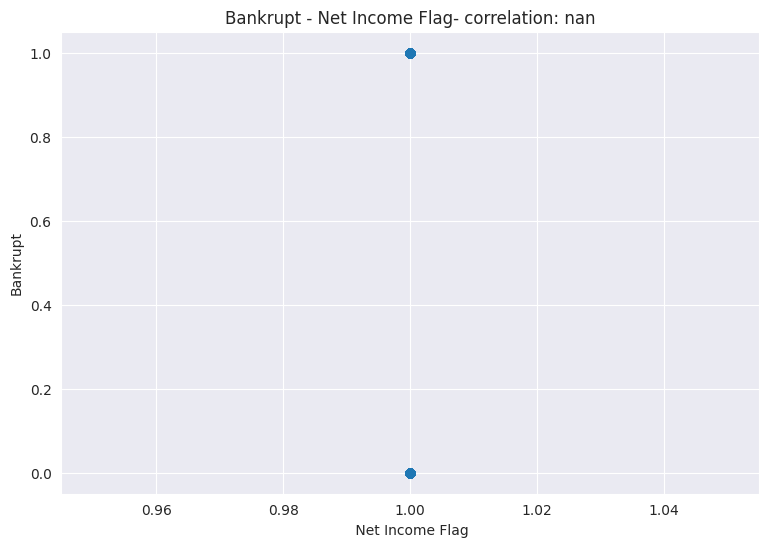

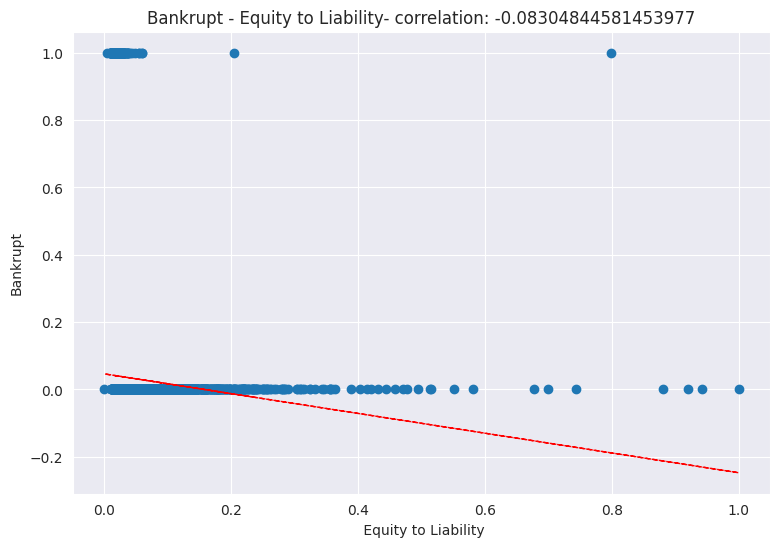

In [ ]:
# Chart - 4 visualization code
# Correlation plot between Independent and dependent variable-

for col in X:
   fig = plt.figure(figsize=(9, 6))
   ax = fig.gca()
   feature = df_2[col]
   label = df_2['Bankrupt']
   correlation = feature.corr(label)
   print('Bankrupt -' + col + '- correlation: ' + str(correlation) )
   plt.scatter(x=feature, y=label)
   plt.xlabel(col)
   plt.ylabel('Bankrupt')
   ax.set_title('Bankrupt -' + col + '- correlation: ' + str(correlation))
   z = np.polyfit(df_2[col], df_2['Bankrupt'], 1)
   y_hat = np.poly1d(z)(df_2[col])

   plt.plot(df_2[col], y_hat, "r--", lw=1)

plt.show()

##### 1. Why did you pick the specific chart?

A scatterplot displays the strength, direction, and form of the relationship between two quantitative variables.

A correlation coefficient measures the strength of that relationship.

##### 2. What is/are the insight(s) found from the chart?


Bankrupt - ROA(C) before interest and depreciation before interest- correlation: -0.26080655752026

Bankrupt - ROA(A) before interest and % after tax- correlation: -0.2829405849344862

Bankrupt - ROA(B) before interest and depreciation after tax- correlation: -0.2730513178632925

Bankrupt - Operating Gross Margin- correlation: -0.10004324405173273

Bankrupt - Realized Sales Gross Margin- correlation: -0.09944524958861489

Bankrupt - Operating Profit Rate- correlation: -0.00022981739906447883

Bankrupt - Pre-tax net Interest Rate- correlation: -0.008516547957062876

Bankrupt - After-tax net Interest Rate- correlation: -0.008857223259672534

Bankrupt - Non-industry income and expenditure/revenue- correlation: -0.01659263759118038

Bankrupt - Continuous interest rate (after tax)- correlation: -0.008394858991381416

Bankrupt - Operating Expense Rate- correlation: -0.0060832255091248285

Bankrupt - Research and development expense rate- correlation: -0.024231968358059488


Bankrupt - Cash flow rate- correlation: -0.0723555512314788
Bankrupt - Interest-bearing debt interest rate- correlation: -0.023062808995369066

Bankrupt - Tax rate (A)- correlation: -0.10970566921434513

Bankrupt - Net Value Per Share (B)- correlation: -0.16539902110860763

Bankrupt - Net Value Per Share (A)- correlation: -0.16546475875891706

Bankrupt - Net Value Per Share (C)- correlation: -0.16478392354118046

Bankrupt - Persistent EPS in the Last Four Seasons- correlation: -0.21955968119078662

Bankrupt - Cash Flow Per Share- correlation: -0.07751645975299933

Bankrupt - Revenue Per Share (Yuan ¥)- correlation: -0.004692038197307208

Bankrupt - Operating Profit Per Share (Yuan ¥)- correlation: -0.14205058222124867

Bankrupt - Per Share Net profit before tax (Yuan ¥)- correlation: -0.20139483445286618

Bankrupt - Realized Sales Gross Profit Growth Rate- correlation: -0.00045838376256820685

Bankrupt - Operating Profit Growth Rate- correlation: -0.015167946135334924

Bankrupt - After-tax Net Profit Growth Rate- correlation: -0.03778297291182442

Bankrupt - Regular Net Profit Growth Rate- correlation: -0.03681967684145598

Bankrupt - Continuous Net Profit Growth Rate- correlation: -0.009400902137391347

Bankrupt - Total Asset Growth Rate- correlation: -0.044431021418011384

Bankrupt - Net Value Growth Rate- correlation: 0.06532942436840894

Bankrupt - Total Asset Return Growth Rate Ratio- correlation: -0.016857679442801213

Bankrupt - Cash Reinvestment %- correlation: -0.05134520428383527

Bankrupt - Current Ratio- correlation: -0.0022112802459893803

Bankrupt - Quick Ratio- correlation: 0.02505828874952853

Bankrupt - Interest Expense Ratio- correlation: -0.002680933815990813

Bankrupt - Total debt/Total net worth- correlation: 0.012313586033482574

Bankrupt - Debt ratio %- correlation: 0.2501609620666176

Bankrupt - Net worth/Assets- correlation: -0.2501609620666176

Bankrupt - Long-term fund suitability ratio (A)- correlation: 0.01691990480855475

Bankrupt - Borrowing dependency- correlation: 0.17654293616159678

Bankrupt - Contingent liabilities/Net worth- correlation: 0.07045452479008071

Bankrupt - Operating profit/Paid-in capital- correlation: -0.14111132382885685

Bankrupt - Net profit before tax/Paid-in capital- correlation: -0.207856519992876

Bankrupt - Inventory and accounts receivable/Net value- correlation: 0.07527808207076722

Bankrupt - Total Asset Turnover- correlation: -0.06791516723426927

Bankrupt - Accounts Receivable Turnover- correlation: -0.004753867439623115

Bankrupt - Average Collection Days- correlation: -0.006555539589374354

Bankrupt - Inventory Turnover Rate (times)- correlation: -0.0013758447622993877

Bankrupt - Fixed Assets Turnover Frequency- correlation: 0.07281826419734336

Bankrupt - Net Worth Turnover Rate (times)- correlation: 0.02108918827486205

Bankrupt - Revenue per person- correlation: 0.03971847652523973

Bankrupt - Operating profit per person- correlation: -0.09284214103165558

Bankrupt - Allocation rate per person- correlation: 0.0028288021304892076

Bankrupt - Working Capital to Total Assets- correlation: -0.19308337582413365

Bankrupt - Quick Assets/Total Assets- correlation: -0.08638211148025543

Bankrupt - Current Assets/Total Assets- correlation: -0.04482333887360571

Bankrupt - Cash/Total Assets- correlation: -0.10013018994632449


Bankrupt - Quick Assets/Current Liability- correlation: -0.003822780137532307

Bankrupt - Cash/Current Liability- correlation: 0.07792109615933347

Bankrupt - Current Liability to Assets- correlation: 0.1944944358554399

Bankrupt - Operating Funds to Liability- correlation: -0.07708196091817603

Bankrupt - Inventory/Working Capital- correlation: -0.0019063428746075998

Bankrupt - Inventory/Current Liability- correlation: 0.0008220941627490159

Bankrupt - Current Liabilities/Liability- correlation: -0.02080932682043775

Bankrupt - Working Capital/Equity- correlation: -0.14722087653968616

Bankrupt - Current Liabilities/Equity- correlation: 0.15382836190696741

Bankrupt - Long-term Liability to Current Assets- correlation: 0.0007783681055204088

Bankrupt - Retained Earnings to Total Assets- correlation: -0.21777877998712308

Bankrupt - Total income/Total expense- correlation: -0.0071369239457182735

Bankrupt - Total expense/Assets- correlation: 0.13904921596620476

Bankrupt - Current Asset Turnover Rate- correlation: 0.01192881751538389

Bankrupt - Quick Asset Turnover Rate- correlation: 0.02581356043624219

Bankrupt - Working capitcal Turnover Rate- correlation: -0.0028944717453918516

Bankrupt - Cash Turnover Rate- correlation: -0.018035318909016506

Bankrupt - Cash Flow to Sales- correlation: 0.00047875189691485876

Bankrupt - Fixed Assets to Assets- correlation: 0.06632835494771051

Bankrupt - Current Liability to Liability- correlation: -0.02080932682043775

Bankrupt - Current Liability to Equity- correlation: 0.15382836190696741

Bankrupt - Equity to Long-term Liability- correlation: 0.13901357254447433

Bankrupt - Cash Flow to Total Assets- correlation: -0.07045564511949455

Bankrupt - Cash Flow to Liability- correlation: -0.043125048245355735

Bankrupt - CFO to Assets- correlation: -0.11538310904200556

Bankrupt - Cash Flow to Equity- correlation: -0.0585632741577528

Bankrupt - Current Liability to Current Assets- correlation: 0.17130604352180398

Bankrupt - Liability-Assets Flag- correlation: 0.1392115593820326

Bankrupt - Net Income to Total Assets- correlation: -0.31545697161429864

Bankrupt - Total assets to GNP price- correlation: 0.03510417888658858

Bankrupt - No-credit Interval- correlation: -0.005546851800271293

Bankrupt - Gross Profit to Sales- correlation: -0.10004384746089581

Bankrupt - Net Income to Stockholder's Equity- correlation: -0.1809869884039432

Bankrupt - Liability to Equity- correlation: 0.16681209778111422

Bankrupt - Degree of Financial Leverage (DFL)- correlation: 0.010508480963374107

Bankrupt - Interest Coverage Ratio (Interest expense to EBIT)- correlation: -0.005509252071533765

Bankrupt - Net Income Flag- correlation: nan

Bankrupt - Equity to Liability- correlation: -0.08304844581453977

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

This graph shows the  correlation between our dependant variable and the independent variables. The ’class’ variable in this case is our dependent
variable which denotes the bankruptcy status of the company.
In this case, the insights gained from the analysis may not directly help in creating a positive business impact.

#### Chart - 5 Correlation Heatmap-

In [ ]:
# Chart - 5 visualization code
# Correlation Heatmap visualization code
corr = df_2.corr()
cmap = cmap=sns.diverging_palette(5, 250, as_cmap=True)

def magnify():
    return [dict(selector="th",
                 props=[("font-size", "7pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

corr.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_caption("Hover to magify")\
    .set_precision(2)\
    .set_table_styles(magnify())

##### 1. Why did you pick the specific chart?

Heatmaps visualise data through variations in colouring. When applied to a tabular format, Heatmaps are useful for cross-examining multivariate data, through placing variables in the rows and columns and colouring the cells within the table. Heatmaps are good for showing variance across multiple variables, revealing any patterns, displaying whether any variables are similar to each other, and for detecting if any correlations exist.

Thus to know the correlation between all the variables along with tha correlation coeficients, we used correlation heatmap.

##### 2. What is/are the insight(s) found from the chart?

- ROA(A)
before
interest
and %
after tax has a
high correlation with [' ROA(C) before interest and depreciation before interest']. Consider dropping one of them.

- ROA(B)
before
interest
and
depreciat
ion after
tax
 has a
high correlation with [' ROA(C) before interest and depreciation before interest', ' ROA(A) before interest and % after
tax']. Consider dropping one of them.

- Realized
Sales
Gross
Margin has a
high correlation with [' Operating Gross Margin']. Consider dropping one of them.

- Pre-tax
net
Interest
Rate
 has a
high correlation with [' Operating Profit Rate']. Consider dropping one of them.


- After-tax
net
Interest
Rate
 has a
high correlation with [' Operating Profit Rate', ' Pre-tax net Interest Rate']. Consider dropping one of them.

- Continuo
us
interest
rate
(after
tax)
 has a
high correlation with [' Operating Profit Rate', ' Pre-tax net Interest Rate', ' After-tax net Interest Rate']. Consider
dropping one of them.

- Net
Value
Per
Share (C)
 has a
high correlation with [' Net Value Per Share (B)', ' Net Value Per Share (A)']. Consider dropping one of them.

- Operatin
g Profit
Per
Share
(Yuan ¥)
 has a
high correlation with [' Persistent EPS in the Last Four Seasons']. Consider dropping one of them.

- Per
Share
Net profit
before
tax (Yuan
¥)
 has a
high correlation with [' Persistent EPS in the Last Four Seasons', ' Operating Profit Per Share (Yuan ¥)']. Consider
dropping one of them.

- Regular
Net
Profit
Growth
Rate
 has a
high correlation with [' After-tax Net Profit Growth Rate']. Consider dropping one of them.

- Net
worth/As
sets
 Cap them or remove them., has a high
correlation with [' Debt ratio %']. Consider dropping one of them.

- Operatin
g
profit/Pai
d-in
capital
 has a
high correlation with [' Persistent EPS in the Last Four Seasons', ' Operating Profit Per Share (Yuan ¥)', ' Per Share Net
profit before tax (Yuan ¥)']. Consider dropping one of them.

- Net profit
before
tax/Paidin capital
 has a
high correlation with [' Persistent EPS in the Last Four Seasons', ' Operating Profit Per Share (Yuan ¥)', ' Per Share Net
profit before tax (Yuan ¥)', ' Operating profit/Paid-in capital']. Consider dropping one of them.

- Current
Liability
to Assets
 has a
high correlation with [' Debt ratio %', ' Net worth/Assets']. Consider dropping one of them.

- Operatin
g Funds
to
Liability
 has a
high correlation with [' Cash flow rate']. Consider dropping one of them.

- Current
Liabilitie
s/Equity
 has a
high correlation with [' Borrowing dependency']. Consider dropping one of them.

- Cash
Flow to
Sales
 has a
high correlation with [' Working capitcal Turnover Rate']. Consider dropping one of them.

- Current
Liability
to
Liability
 has a high
correlation with [' Current Liabilities/Liability']. Consider dropping one of them.

- Current
Liability
to Equity
 has a
high correlation with [' Borrowing dependency', ' Current Liabilities/Equity']. Consider dropping one of them.

- Equity to
Longterm
Liability
 has a
high correlation with [' Borrowing dependency']. Consider dropping one of them.

- Net
Income
to Total
Assets
Cap them or remove them., has a
high correlation with [' ROA(C) before interest and depreciation before interest', ' ROA(A) before interest and % after
tax', ' ROA(B) before interest and depreciation after tax']. Consider dropping one of them.

- Gross
Profit to
Sales
 has a
high correlation with [' Operating Gross Margin', ' Realized Sales Gross Margin']. Consider dropping one of them.


- Net
Income
to
Stockhol
der's
Equity
has a
high correlation with [' Borrowing dependency']. Consider dropping one of them.

- Liability
to Equity
 has a
high correlation with [' Borrowing dependency', ' Current Liabilities/Equity', ' Current Liability to Equity']. Consider
dropping one of them.



##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

The gained insights about dropping correlated features can potentially have a positive impact on the company bankruptcy prediction model. By removing highly correlated features, the model can become more robust, less prone to overfitting, and more interpretable. Dropping one of the highly correlated features helps to eliminate redundancy and reduce multicollinearity, which can improve the model's stability and accuracy.

However, it's important to note that these insights alone may not guarantee a positive business impact. The impact depends on various factors, including the quality and diversity of the dataset, the choice of the predictive model, the feature engineering techniques employed, and the overall modeling process.

Regarding negative growth, it's difficult to determine specific negative impacts solely based on the given insights. The insights primarily suggest dropping correlated features to improve the model's performance and interpretability. However, negative growth can occur if important information or predictive power is inadvertently removed by dropping certain features. Therefore, it is crucial to carefully evaluate the potential consequences and thoroughly validate the model after dropping correlated features.

## ***5. Hypothesis Testing***

### Based on your chart experiments, define three hypothetical statements from the dataset. In the next three questions, perform hypothesis testing to obtain final conclusion about the statements through your code and statistical testing.

- There is a significant relationship between ROA(C) and the likelihood of company bankruptcy.

- There is a significant difference in the mean values of the "Operating Profit Rate" between bankrupt and non-bankrupt companies.

- There is a significant difference in the average Equity to Liability ratio between bankrupt and non-bankrupt companies.

### Hypothetical Statement - 1

There is a significant relationship between ROA(C) and the likelihood of company bankruptcy.

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

**Hypotheses:**

**Null hypothesis (H0):** There is no significant relationship between ROA(C) and the likelihood of company bankruptcy.

**Alternative hypothesis (H1):** There is a significant relationship between ROA(C) and the likelihood of company bankruptcy.

**Statistical Test:**

Since ROA(C) is a continuous variable, you can use a two-sample t-test to compare the mean ROA(C) values between bankrupt and non-bankrupt companies.

#### 2. Perform an appropriate statistical test.

In [ ]:
# Perform Statistical Test to obtain P-Value


# Data Preparation
bankrupt_data = df_2[df_2['Bankrupt'] == 1][' ROA(C) before interest and depreciation before interest']
non_bankrupt_data = df_2[df_2['Bankrupt'] == 0][' ROA(C) before interest and depreciation before interest']

# Set the significance level (alpha)
alpha = 0.05

# Perform the t-test
t_statistic, p_value = stats.ttest_ind(bankrupt_data, non_bankrupt_data, equal_var=True)

# Analyze the results
if p_value < alpha:
    print("Reject the null hypothesis.")
    print("There is a significant relationship between ROA(C) and company bankruptcy.")
else:
    print("Fail to reject the null hypothesis.")
    print("There is no significant relationship between ROA(C) and company bankruptcy.")

# Report the findings
print("T-statistic:", t_statistic)
print("P-value:", p_value)

Reject the null hypothesis.
There is a significant relationship between ROA(C) and company bankruptcy.
T-statistic: -22.305495310935278
P-value: 1.9508130644944296e-106


##### Which statistical test have you done to obtain P-Value?




The two-sample t-test (stats.ttest_ind()) is used to obtain the p-value. The t-test is a statistical test used to determine if there is a significant difference between the means of two groups. It assumes that the data follows a normal distribution and that the variances of the two groups are equal (equal_var=True).

The t-test calculates a t-statistic, which measures the difference between the means of the two groups relative to the variation within each group. The p-value represents the probability of observing the obtained difference (or a more extreme difference) if the null hypothesis is true. A p-value below a chosen significance level (typically 0.05) suggests that there is strong evidence to reject the null hypothesis and conclude that there is a significant difference between the groups.

The obtained p-value is compared to the significance level (alpha) to determine whether to reject the null hypothesis or fail to reject it.

##### Why did you choose the specific statistical test?

The specific statistical test, the two-sample t-test, was chosen based on the nature of the problem and the available data. Here are the reasons for choosing the t-test in this context:

**Comparison of means:** The objective is to compare the means of two groups (e.g., bankrupt vs. non-bankrupt) for a specific variable. The t-test is well-suited for comparing means and determining if there is a statistically significant difference between them.

**Assumption of normality:** The t-test assumes that the data follow a normal distribution. In hypothesis testing, it is important to check the normality assumption. If the data deviate significantly from normality, alternative non-parametric tests may be more appropriate.

**Independent samples:** The t-test is suitable when the samples being compared are independent of each other. In the context of bankruptcy prediction, we can assume that the bankrupt and non-bankrupt companies are independent of each other.

**Equal variances assumption:** The t-test assumes that the variances of the two groups being compared are equal. This assumption can be tested or assumed based on prior knowledge of the data. If the assumption is violated, alternative variants of the t-test, such as Welch's t-test, can be used.

### Hypothetical Statement - 2

There is a significant difference in the mean values of the "Operating Profit Rate" between bankrupt and non-bankrupt companies.

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

**Hypothesis :**

**Null Hypothesis (H0):** There is no significant difference in the mean values of the "Operating Profit Rate" between bankrupt and non-bankrupt companies.

**Alternative Hypothesis (HA):** There is a significant difference in the mean values of the "Operating Profit Rate" between bankrupt and non-bankrupt companies.

**Statistical Test:**

I used an independent t-test to obtain the p-value. The independent t-test is appropriate when comparing the means of two independent groups.

#### 2. Perform an appropriate statistical test.

In [ ]:
# Perform Statistical Test to obtain P-Value

# Load the data and split into bankrupt and non-bankrupt groups

bankrupt_data = df_2[df_2['Bankrupt'] == 1][' Operating Profit Rate']
non_bankrupt_data = df_2[df_2['Bankrupt'] == 0][' Operating Profit Rate']

# Perform independent t-test
t_stat, p_value = ttest_ind(bankrupt_data, non_bankrupt_data, equal_var=False)

# Analyze the results
if p_value < alpha:
    print("Reject the null hypothesis.")
    print("There is significant difference in the mean values of the Operating Profit Rat between bankrupt and non-bankrupt companies.")
else:
    print("Fail to reject the null hypothesis.")
    print("There is no significant difference in the mean values of the Operating Profit Rate between bankrupt and non-bankrupt companies.")

# Print the results
print('T-statistic:', t_stat)
print('P-value:', p_value)

Fail to reject the null hypothesis.
There is no significant difference in the mean values of the Operating Profit Rate between bankrupt and non-bankrupt companies.
T-statistic: -0.09972916146695655
P-value: 0.9205624906733761


##### Which statistical test have you done to obtain P-Value?

 I used an independent t-test to obtain the p-value. The independent t-test is appropriate when comparing the means of two independent groups, in this case, bankrupt and non-bankrupt companies. The ttest_ind() function from the scipy library performs the independent t-test and returns the t-statistic and p-value. The p-value represents the probability of observing the difference in means between the two groups due to chance alone.

##### Why did you choose the specific statistical test?

The choice of the independent t-test may have been based on the following considerations:

**Two independent groups:** The code splits the data into two groups based on the 'Bankrupt' variable, with one group representing bankrupt companies and the other representing non-bankrupt companies. The independent t-test is appropriate when comparing two independent groups.

**Continuous variable:** The variable being compared, 'Operating Profit Rate,' appears to be a continuous variable. The independent t-test is commonly used for comparing means of continuous variables.

**Normality assumption:** The t-test assumes that the data in each group approximately follows a normal distribution. If the data is reasonably close to normal or the sample size is large enough, the t-test can still provide valid results.

### Hypothetical Statement - 3

There is a significant difference in the average Equity to Liability ratio between bankrupt and non-bankrupt companies.

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

**Hypothesis:**

**Null Hypothesis (H0):** There is no significant difference in the average Equity to Liability ratio between bankrupt and non-bankrupt companies.

**Alternative Hypothesis (H1):** There is a significant difference in the average Equity to Liability ratio between bankrupt and non-bankrupt companies.

**Statistical Test:**

I will use an independent t-test to obtain the p-value. The independent t-test is appropriate when comparing the means of two independent groups.

#### 2. Perform an appropriate statistical test.

In [ ]:
bankrupt_data = df_2[df_2['Bankrupt'] == 1][' Equity to Liability']
non_bankrupt_data = df_2[df_2['Bankrupt'] == 0][' Equity to Liability']

# Perform independent t-test
t_stat, p_value = ttest_ind(bankrupt_data, non_bankrupt_data, equal_var=False)

if p_value < alpha:
    print("Reject the null hypothesis.")
    print("There is a significant difference in the average Equity to Liability ratio between bankrupt and non-bankrupt companies..")
else:
    print("Fail to reject the null hypothesis.")
    print("There is no significant difference in the average Equity to Liability ratio between bankrupt and non-bankrupt companies.")

# Print the results
print('T-statistic:', t_stat)
print('P-value:', p_value)

Reject the null hypothesis.
There is a significant difference in the average Equity to Liability ratio between bankrupt and non-bankrupt companies..
T-statistic: -6.3186730466624095
P-value: 1.3407719997550653e-09


##### Which statistical test have you done to obtain P-Value?


To obtain the p-value in the code provided, an independent t-test was performed using the ttest_ind() function from the scipy.stats module. The independent t-test is used to compare the means of two independent groups and assess whether there is a significant difference between them. The ttest_ind() function calculates the t-statistic and the corresponding p-value for the given groups.

##### Why did you choose the specific statistical test?


The specific statistical test, an independent t-test, was chosen in this context because it is appropriate for comparing the means of two independent groups.

In the given hypothesis, we want to investigate whether there is a significant difference in the average Total Asset Turnover between companies with positive Net Income and companies with negative Net Income. We have two distinct groups (companies with positive Net Income and companies with negative Net Income), and we are interested in comparing the means of a continuous variable (Total Asset Turnover) between these groups.

The independent t-test is commonly used when we have two independent groups and want to determine if there is a statistically significant difference between their means. It assesses whether the observed difference in means is unlikely to have occurred by chance alone or due to random sampling variability. Therefore, the independent t-test is suitable for testing the hypothesis in this scenario.

## ***6. Feature Engineering & Data Pre-processing***

### 1. Handling Missing Values

In [ ]:
# Handling Missing Values & Missing Value Imputation
# Missing Value Count Function
def show_missing():
    missing = df_2.columns[df_2.isnull().any()].tolist()
    return missing

# Missing data counts and percentage
print('Missing Data Count')
print(df_2[show_missing()].isnull().sum().sort_values(ascending = False))
print('--'*50)
print('Missing Data Percentage')
print(round(df_2[show_missing()].isnull().sum().sort_values(ascending = False)/len(df_2)*100,2))

Missing Data Count
Series([], dtype: float64)
----------------------------------------------------------------------------------------------------
Missing Data Percentage
Series([], dtype: float64)


<Axes: >

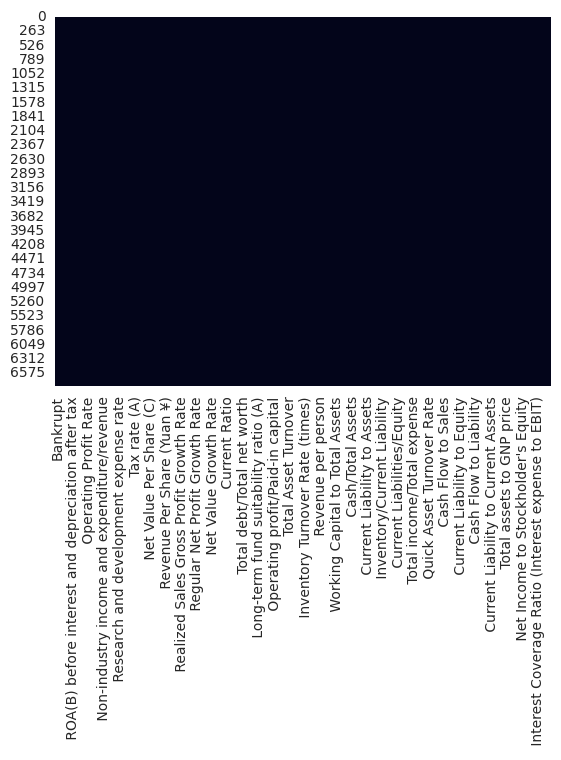

In [ ]:
# Visualizing the missing values
# Checking Null Value by plotting Heatmap
sns.heatmap(df_2.isnull(), cbar=False)

#### What all missing value imputation techniques have you used and why did you use those techniques?

There is no missing value present in dataset.

### 2. Handling Outliers

In [ ]:
# Handling Outliers & Outlier treatments

symmetric_feature=[]
non_symmetric_feature=[]
for i in df_2.describe().columns:
  if abs(df_2[i].mean()-df_2[i].median())<0.2:
    symmetric_feature.append(i)
  else:
    non_symmetric_feature.append(i)

# Getting Symmetric Distributed Features
print("Symmetric Distributed Features : -",symmetric_feature)

# Getting Skew Symmetric Distributed Features
print("Skew Symmetric Distributed Features : -",non_symmetric_feature)

Symmetric Distributed Features : - ['Bankrupt', ' ROA(C) before interest and depreciation before interest', ' ROA(A) before interest and % after tax', ' ROA(B) before interest and depreciation after tax', ' Operating Gross Margin', ' Realized Sales Gross Margin', ' Operating Profit Rate', ' Pre-tax net Interest Rate', ' After-tax net Interest Rate', ' Non-industry income and expenditure/revenue', ' Continuous interest rate (after tax)', ' Cash flow rate', ' Tax rate (A)', ' Net Value Per Share (B)', ' Net Value Per Share (A)', ' Net Value Per Share (C)', ' Persistent EPS in the Last Four Seasons', ' Cash Flow Per Share', ' Operating Profit Per Share (Yuan ¥)', ' Per Share Net profit before tax (Yuan ¥)', ' Realized Sales Gross Profit Growth Rate', ' Operating Profit Growth Rate', ' After-tax Net Profit Growth Rate', ' Regular Net Profit Growth Rate', ' Continuous Net Profit Growth Rate', ' Total Asset Return Growth Rate Ratio', ' Cash Reinvestment %', ' Interest Expense Ratio', ' Debt 

In [ ]:
# find categorical variables
categorical = [var for var in df_2.columns if df_2[var].dtype=='O']
print('There are {} categorical variables'.format(len(categorical)))

There are 0 categorical variables


In [ ]:
# find Numerical variables
numerical = [var for var in df_2.columns if df_2[var].dtype!='O']
print('There are {} numerical variables'.format(len(numerical)))

There are 96 numerical variables


In [ ]:
# find discrete variables
discrete = []
for var in numerical:
    if len(df_2[var].unique())<20:
        print(var, ' values: ', df_2[var].unique())
        discrete.append(var)

print('There are {} discrete variables'.format(len(discrete)))

Bankrupt  values:  [1 0]
 Liability-Assets Flag  values:  [0 1]
 Net Income Flag  values:  [1]
There are 3 discrete variables


In [ ]:
# find continuous variables
continuous = [var for var in numerical if var not in discrete ]
print('There are {} continuous variables'.format(len(continuous)))

There are 93 continuous variables


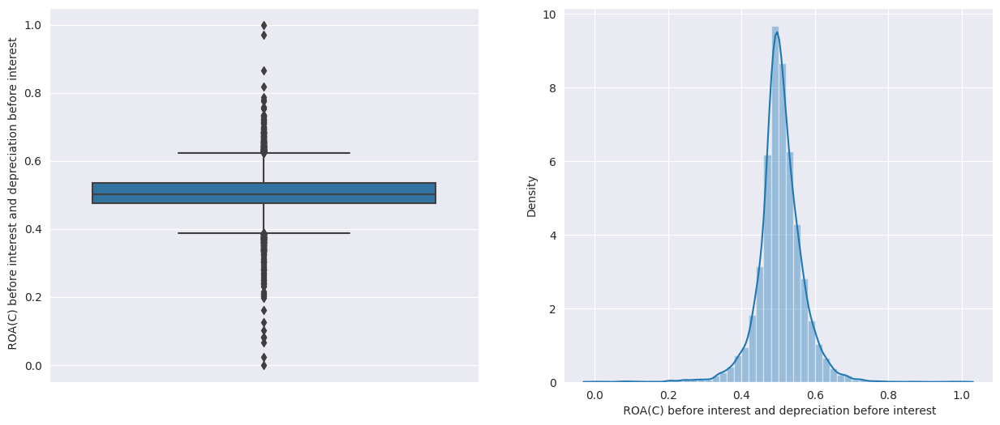

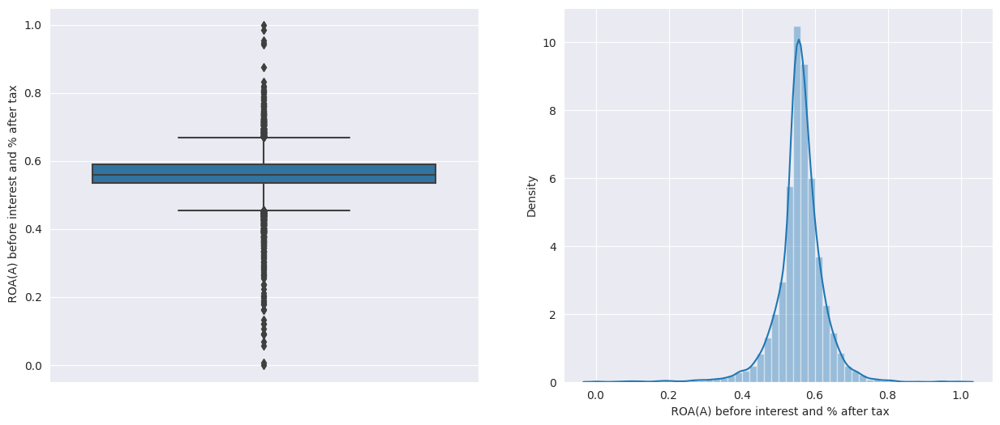

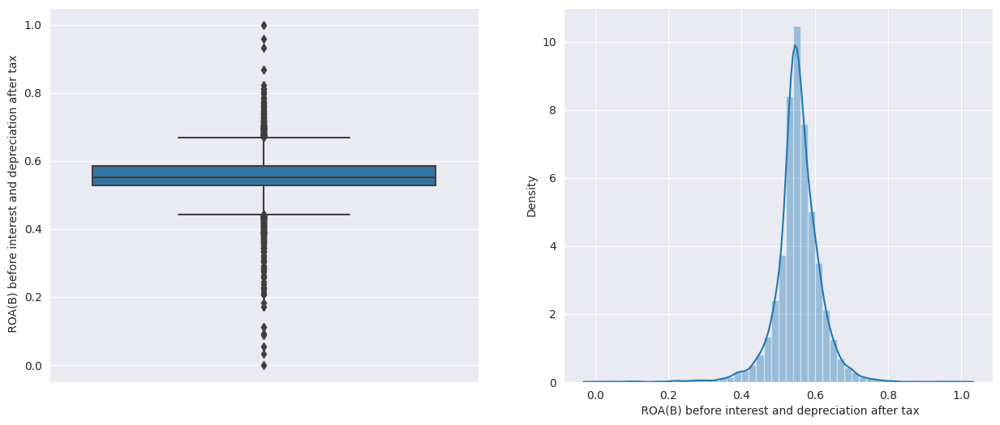

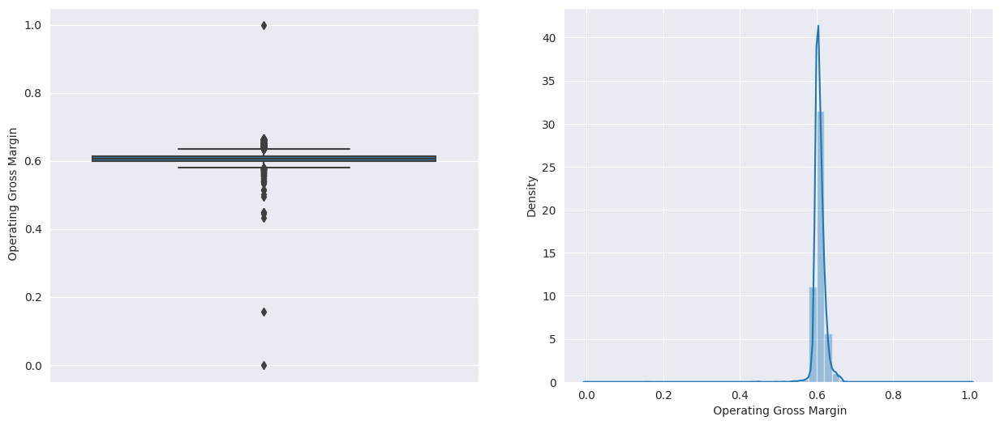

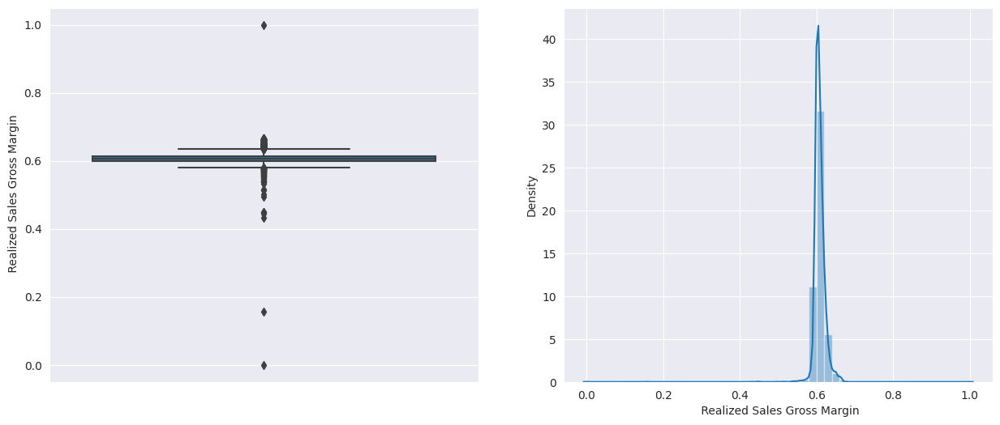

...

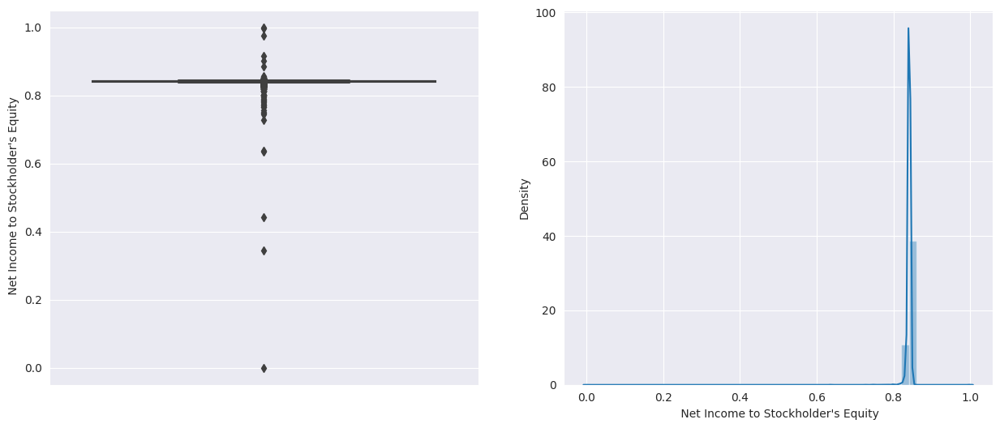

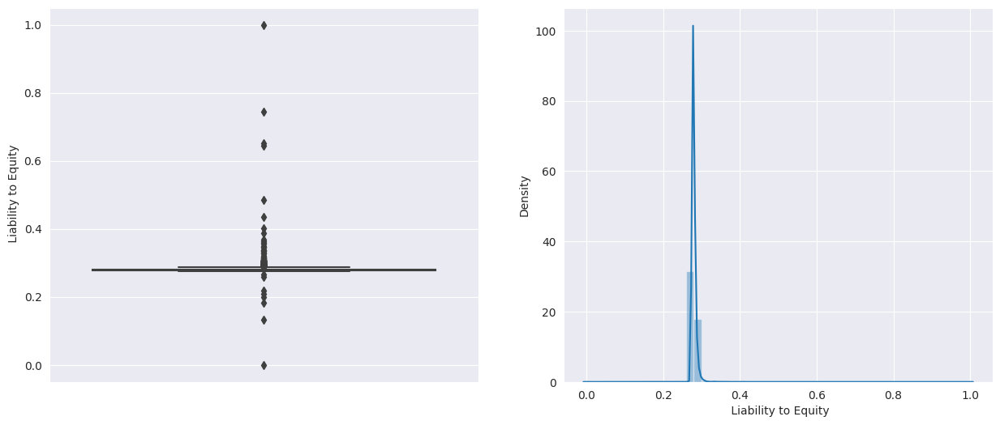

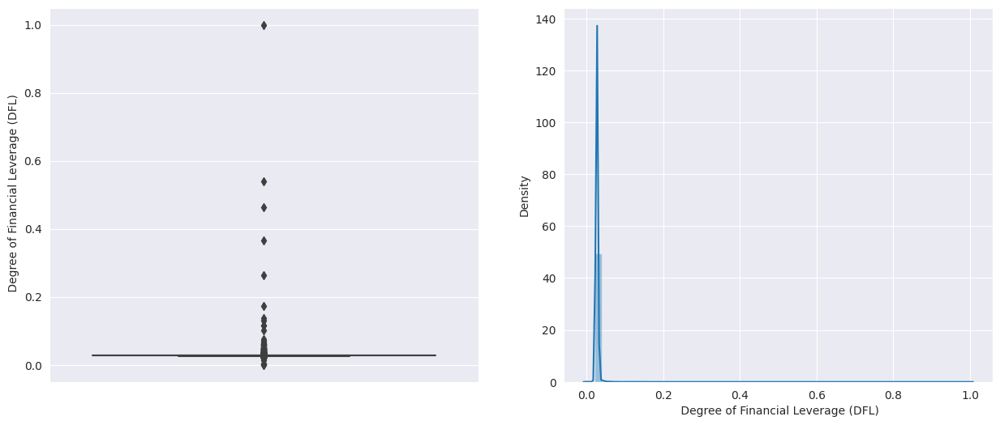

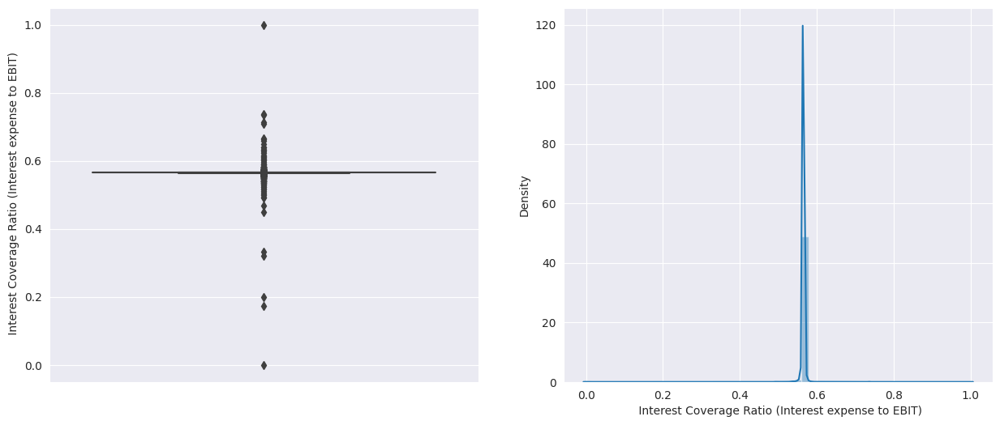

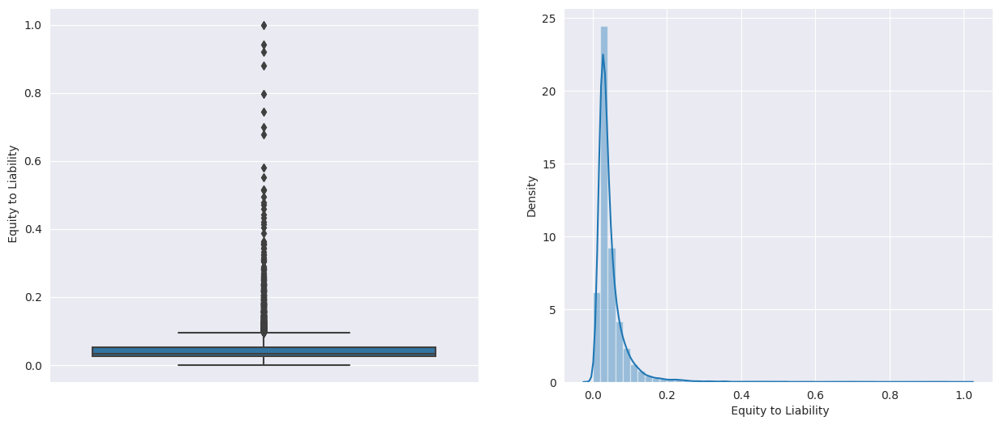

In [ ]:
# Plot for continuous variable
for var in continuous:
    plt.figure(figsize=(15,6))
    plt.subplot(1, 2, 1)
    fig = sns.boxplot(y=df_2[var])
    fig.set_title('')
    fig.set_ylabel(var)

    plt.subplot(1, 2, 2)
    fig = sns.distplot(df_2[var].dropna())

    fig.set_xlabel(var)

    plt.show()

In [ ]:
# Removing descrete features from symmetric_feature

new_symmetric_feature = [x for x in symmetric_feature if x not in discrete]
print(new_symmetric_feature)

[' ROA(C) before interest and depreciation before interest', ' ROA(A) before interest and % after tax', ' ROA(B) before interest and depreciation after tax', ' Operating Gross Margin', ' Realized Sales Gross Margin', ' Operating Profit Rate', ' Pre-tax net Interest Rate', ' After-tax net Interest Rate', ' Non-industry income and expenditure/revenue', ' Continuous interest rate (after tax)', ' Cash flow rate', ' Tax rate (A)', ' Net Value Per Share (B)', ' Net Value Per Share (A)', ' Net Value Per Share (C)', ' Persistent EPS in the Last Four Seasons', ' Cash Flow Per Share', ' Operating Profit Per Share (Yuan ¥)', ' Per Share Net profit before tax (Yuan ¥)', ' Realized Sales Gross Profit Growth Rate', ' Operating Profit Growth Rate', ' After-tax Net Profit Growth Rate', ' Regular Net Profit Growth Rate', ' Continuous Net Profit Growth Rate', ' Total Asset Return Growth Rate Ratio', ' Cash Reinvestment %', ' Interest Expense Ratio', ' Debt ratio %', ' Net worth/Assets', ' Long-term fund

In [ ]:
# Removing descrete features from non symmetric_feature

new_non_symmetric_feature = [x for x in non_symmetric_feature if x not in discrete]
print(new_non_symmetric_feature)

[' Operating Expense Rate', ' Research and development expense rate', ' Interest-bearing debt interest rate', ' Revenue Per Share (Yuan ¥)', ' Total Asset Growth Rate', ' Net Value Growth Rate', ' Current Ratio', ' Quick Ratio', ' Total debt/Total net worth', ' Accounts Receivable Turnover', ' Average Collection Days', ' Inventory Turnover Rate (times)', ' Fixed Assets Turnover Frequency', ' Revenue per person', ' Allocation rate per person', ' Quick Assets/Current Liability', ' Cash/Current Liability', ' Inventory/Current Liability', ' Long-term Liability to Current Assets', ' Current Asset Turnover Rate', ' Quick Asset Turnover Rate', ' Cash Turnover Rate', ' Fixed Assets to Assets', ' Total assets to GNP price']


In [ ]:
# For Symmetric features defining upper and lower boundry
def outlier_treatment(df,feature):
  upper_boundary= df_2[feature].mean()+3*df_2[feature].std()
  lower_boundary= df_2[feature].mean()-3*df_2[feature].std()
  return upper_boundary,lower_boundary

In [ ]:
# Restricting the data to lower and upper boundry
for feature in new_symmetric_feature:
  df_2.loc[df_2[feature]<= outlier_treatment(df=df_2,feature=feature)[1], feature]=outlier_treatment(df=df_2,feature=feature)[1]
  df_2.loc[df_2[feature]>= outlier_treatment(df=df_2,feature=feature)[0], feature]=outlier_treatment(df=df_2,feature=feature)[0]

In [ ]:
# For Skew Symmetric features defining upper and lower boundry
#Outer Fence
def outlier_treatment_skew(df,feature):
  IQR= df_2[feature].quantile(0.75)- df_2[feature].quantile(0.25)
  lower_bridge =df_2[feature].quantile(0.25)-3*IQR
  upper_bridge =df_2[feature].quantile(0.25)+3*IQR
  return upper_bridge,lower_bridge

In [ ]:
# Restricting the data to lower and upper boundry
for feature in new_non_symmetric_feature:
  df_2.loc[df_2[feature]<= outlier_treatment_skew(df=df_2,feature=feature)[1], feature]=outlier_treatment_skew(df=df_2,feature=feature)[1]
  df_2.loc[df_2[feature]>= outlier_treatment_skew(df=df_2,feature=feature)[0], feature]=outlier_treatment_skew(df=df_2,feature=feature)[0]

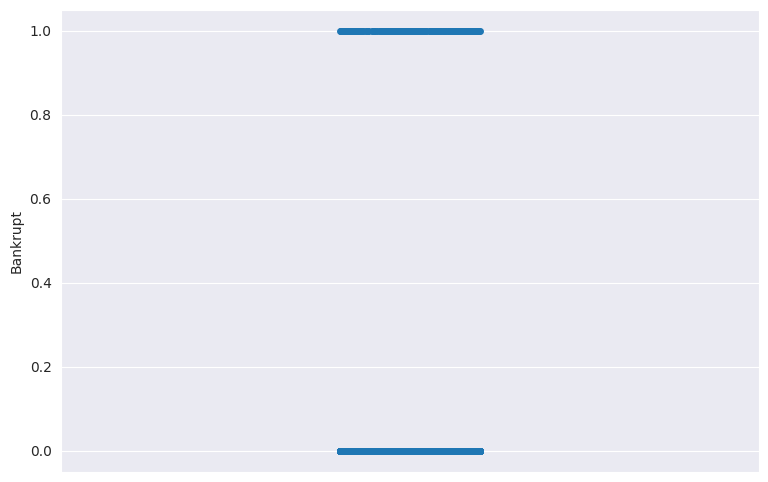

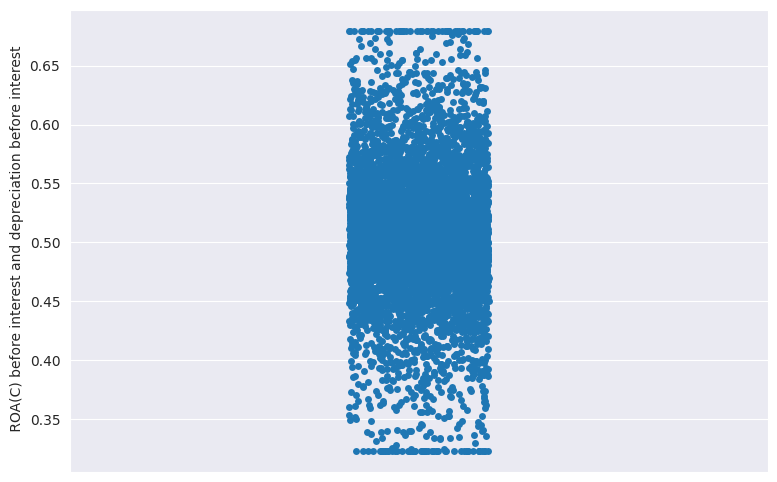

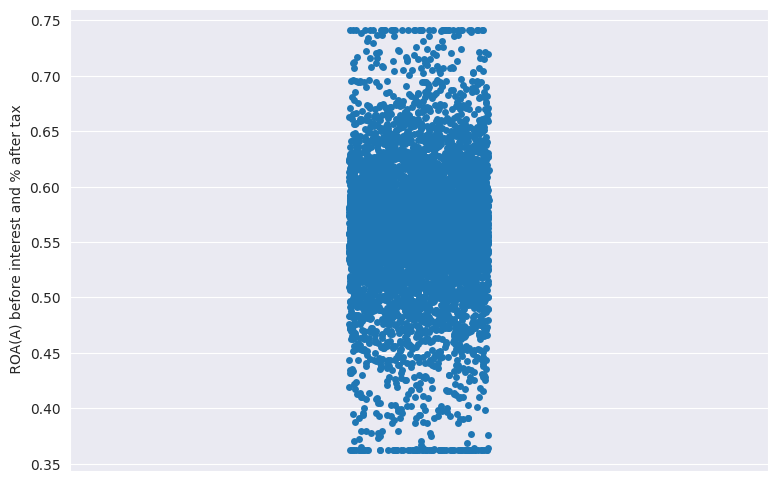

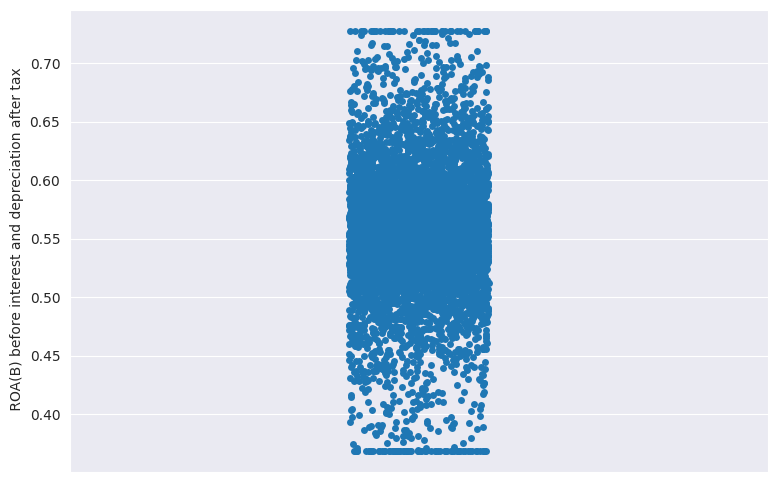

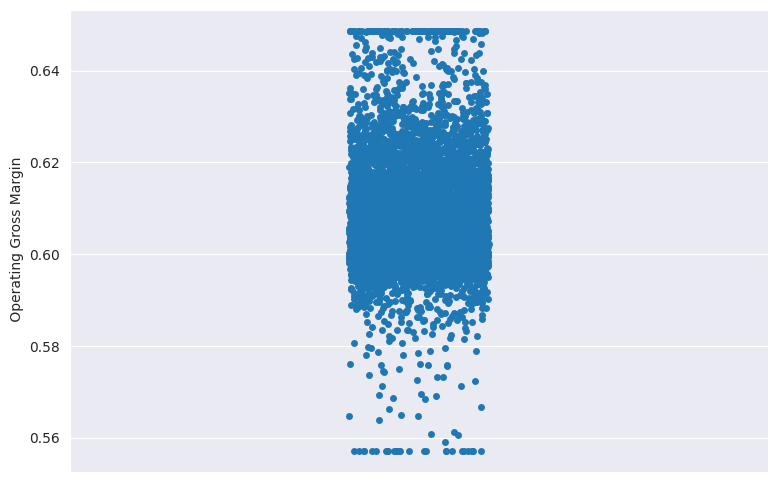

...

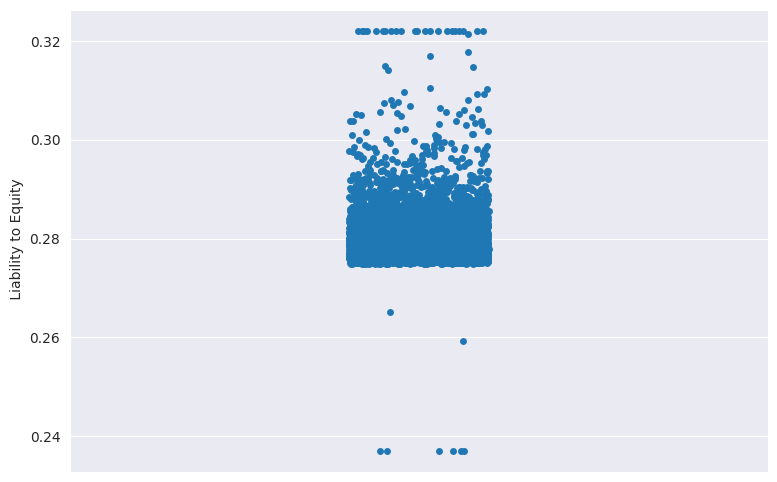

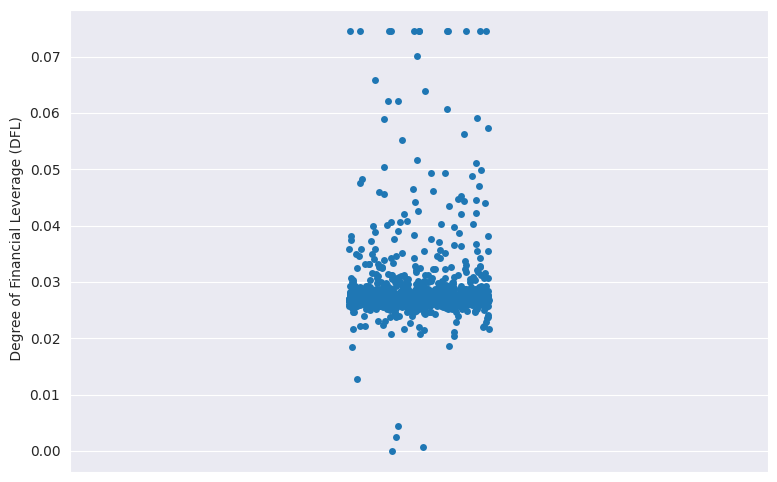

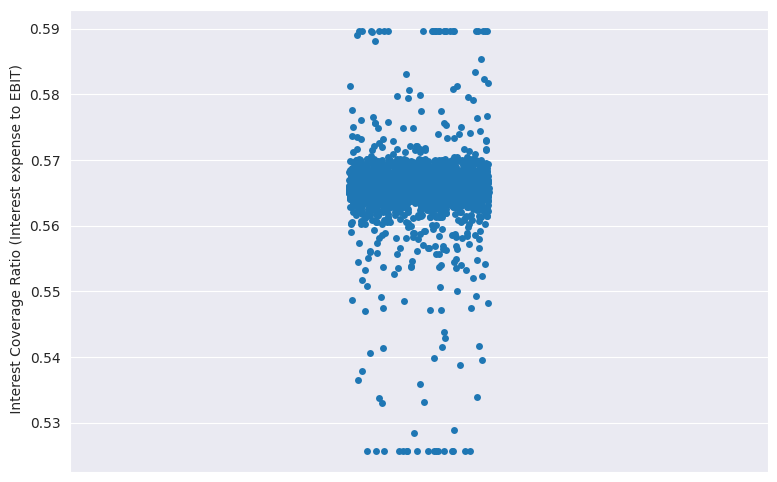

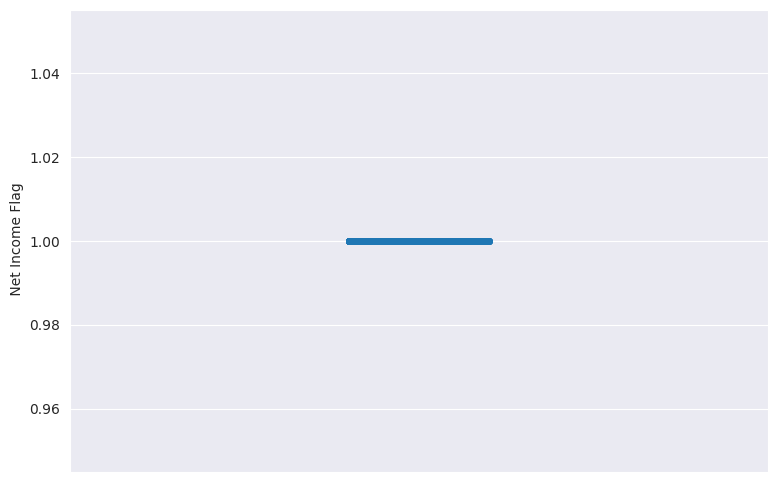

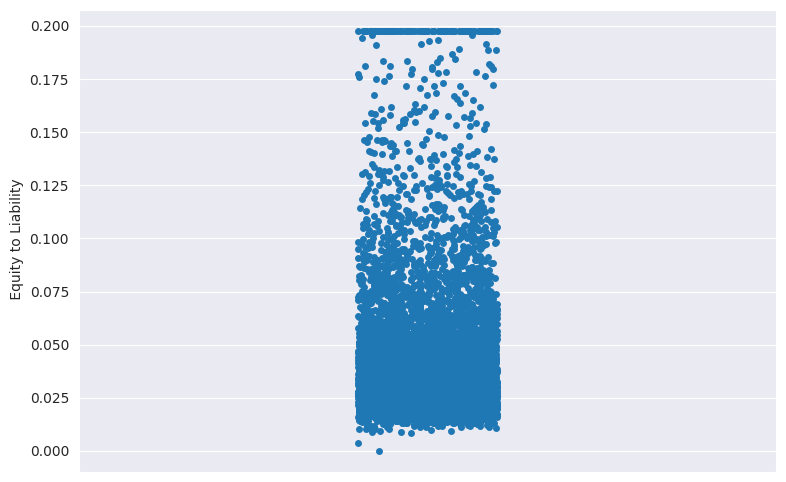

In [ ]:
# After Outlier Treatment showing the dataset distribution using strip plot
# Visualising  code for the numerical columns
for col in df_2.describe().columns:
  fig=plt.figure(figsize=(9,6))
  sns.stripplot(df_2[col])

##### What all outlier treatment techniques have you used and why did you use those techniques?

First I separated the skew symmetric and symmetric features and define the upper and lower boundry.

Another way to do it is dropping extreme values but I didn't do that due to less no. of datapoints I have.

In a Gaussian distribution while it’s the symmetric curve and outlier are present. Then, we can set the boundary by taking standard deviation into action.

The box plot is a useful graphical display for describing the behavior of the data in the middle as well as at the ends of the distributions. The box plot uses the median and the lower and upper quartiles (defined as the 25th and 75th percentiles). If the lower quartile is Q1 and the upper quartile is Q3, then the difference (Q3 — Q1) is called the interquartile range or IQ. A box plot is constructed by drawing a box between the upper and lower quartiles with a solid line drawn across the box to locate the median. The following quantities (called fences) are needed for identifying extreme values in the tails of the distribution:

lower inner fence: Q1–1.5IQ upper inner fence: Q3 + 1.5IQ lower outer fence: Q1–3IQ upper outer fence: Q3 + 3IQ

### 3. Categorical Encoding

In [ ]:
# Encode your categorical columns

# Getting the categorical columns
categorical_columns=list(set(df_2.columns.to_list()).difference(set(df_2.describe().columns.to_list())))
print("Categorical Columns are :-", categorical_columns)

Categorical Columns are :- []


#### What all categorical encoding techniques have you used & why did you use those techniques?

There is no categorical column.

### 4. Feature Manipulation & Selection

#### 1. Feature Manipulation

In [ ]:
# Manipulate Features to minimize feature correlation and create new features
# Check the shape of dataset
df_2.shape

(6819, 96)

In [ ]:
#Multicollinearity
from statsmodels.stats.outliers_influence import variance_inflation_factor
def calc_vif(X):

   # Calculating VIF
   vif = pd.DataFrame()
   vif["variables"] = X.columns
   vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

   return(vif)

In [ ]:
calc_vif(df_2[[i for i in df_2.describe().columns ]])

,variables,VIF
0,Bankrupt,1.338960e+00
1,ROA(C) before interest and depreciation befor...,9.789038e+01
2,ROA(A) before interest and % after tax,1.074863e+02
3,ROA(B) before interest and depreciation after...,1.625278e+02
4,Operating Gross Margin,2.876001e+07
...,...,...
91,Liability to Equity,1.120182e+02
92,Degree of Financial Leverage (DFL),1.068567e+00
93,Interest Coverage Ratio (Interest expense to ...,1.164712e+00
94,Net Income Flag,0.000000e+00


In [ ]:
# Checking Variable Inflation Factor
# the independent variables set
X = df_2.copy()

# VIF dataframe
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns

# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X.values, i)
                          for i in range(len(X.columns))]

for i in range(len(vif_data)):
  vif_data.loc[i,"VIF"]=vif_data.loc[i,"VIF"].round(2)
  if vif_data.loc[i,"VIF"]>=8:
    print(vif_data.loc[i,"feature"])

 ROA(C) before interest and depreciation before interest
 ROA(A) before interest and % after tax
 ROA(B) before interest and depreciation after tax
 Operating Gross Margin
 Realized Sales Gross Margin
 Pre-tax net Interest Rate
 After-tax net Interest Rate
 Continuous interest rate (after tax)
 Cash flow rate
 Net Value Per Share (B)
 Net Value Per Share (A)
 Net Value Per Share (C)
 Persistent EPS in the Last Four Seasons
 Revenue Per Share (Yuan ¥)
 Operating Profit Per Share (Yuan ¥)
 Per Share Net profit before tax (Yuan ¥)
 After-tax Net Profit Growth Rate
 Regular Net Profit Growth Rate
 Cash Reinvestment %
 Current Ratio
 Quick Ratio
 Total debt/Total net worth
 Debt ratio %
 Net worth/Assets
 Borrowing dependency
 Operating profit/Paid-in capital
 Net profit before tax/Paid-in capital
 Inventory and accounts receivable/Net value
 Total Asset Turnover
 Net Worth Turnover Rate (times)
 Working Capital to Total Assets
 Quick Assets/Total Assets
 Current Assets/Total Assets
 Quick 

In [ ]:
# Check Feature Correlation and finding multicolinearity
def correlation(df,threshold):
  col_corr=set()
  corr_matrix= df.corr()
  for i in range (len(corr_matrix.columns)):
    for j in range(i):
      if abs (corr_matrix.iloc[i,j])>threshold:
        colname=corr_matrix.columns[i]
        col_corr.add(colname)
  return list(col_corr)

In [ ]:
# Getting multicolinear columns and dropping them
highly_correlated_columns=correlation(df_2,0.5)

if "Bankrupt" in highly_correlated_columns:
  highly_correlated_columns.remove("Bankrupt")
else:
  pass

df_removed=df_2.drop(highly_correlated_columns,axis=1)
df_removed.shape

(6819, 40)

In [ ]:
# Correlation after dropping the required columns
# Correlation Heatmap visualization code
corr = df_removed.corr()
cmap = cmap=sns.diverging_palette(5, 250, as_cmap=True)

def magnify():
    return [dict(selector="th",
                 props=[("font-size", "7pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

corr.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_caption("Hover to magify")\
    .set_precision(2)\
    .set_table_styles(magnify())

,Bankrupt,ROA(C) before interest and depreciation before interest,Operating Gross Margin,Operating Profit Rate,Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Total Asset Return Growth Rate Ratio,Current Ratio,Interest Expense Ratio,Long-term fund suitability ratio (A),Contingent liabilities/Net worth,Accounts Receivable Turnover,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Allocation rate per person,Inventory/Working Capital,Inventory/Current Liability,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Cash Flow to Total Assets,Liability-Assets Flag,Total assets to GNP price,No-credit Interval,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag
Bankrupt,1.00,-0.25,-0.14,-0.03,-0.01,-0.02,-0.10,0.09,-0.12,-0.07,0.00,-0.08,-0.09,-0.05,-0.04,-0.11,-0.15,-0.03,-0.02,0.06,-0.01,-0.00,0.08,0.12,-0.00,-0.05,-0.09,0.12,0.06,0.03,-0.03,-0.02,-0.00,-0.07,0.14,0.07,-0.03,0.03,-0.03,nan
ROA(C) before interest and depreciation before interest,-0.25,1.00,0.44,0.21,0.07,0.11,0.46,-0.06,0.30,0.28,0.05,0.17,0.26,0.13,0.02,0.43,0.20,0.02,0.02,-0.10,0.07,-0.07,-0.08,-0.11,-0.03,-0.02,0.36,-0.24,-0.11,-0.03,-0.03,-0.03,0.03,0.26,-0.08,-0.01,0.04,-0.04,0.04,nan
Operating Gross Margin,-0.14,0.44,1.00,0.09,-0.29,-0.03,0.35,-0.12,0.09,-0.16,0.07,0.10,0.13,0.06,0.01,0.19,0.38,0.00,0.04,-0.11,0.01,0.07,-0.08,-0.17,-0.04,0.04,0.18,0.34,-0.13,-0.19,0.05,-0.09,0.01,0.14,-0.04,-0.17,0.03,-0.02,0.01,nan
Operating Profit Rate,-0.03,0.21,0.09,1.00,0.05,0.06,0.17,0.00,0.09,0.04,0.03,0.06,0.11,0.06,0.07,0.11,0.01,0.02,-0.03,-0.03,-0.01,0.01,-0.05,-0.05,0.00,0.00,0.08,-0.04,-0.12,0.04,-0.14,0.04,0.29,0.08,-0.01,0.00,-0.01,0.01,0.01,nan
Operating Expense Rate,-0.01,0.07,-0.29,0.05,1.00,-0.06,-0.02,0.06,0.07,0.27,-0.00,0.03,0.01,-0.01,0.01,0.01,-0.13,0.04,0.01,0.06,0.07,-0.13,-0.02,0.08,0.02,-0.03,0.09,-0.30,0.11,0.15,-0.03,0.04,0.01,0.01,-0.00,0.22,0.00,0.02,0.01,nan
Research and development expense rate,-0.02,0.11,-0.03,0.06,-0.06,1.00,0.05,-0.03,-0.02,0.04,-0.02,0.02,0.03,0.01,0.02,0.03,-0.01,-0.03,-0.07,-0.02,-0.18,0.00,-0.05,-0.13,-0.02,-0.09,0.01,-0.05,-0.15,-0.03,-0.02,0.07,0.01,0.00,-0.01,-0.03,0.02,-0.03,-0.03,nan
Cash flow rate,-0.10,0.46,0.35,0.17,-0.02,0.05,1.00,-0.09,0.08,-0.06,-0.01,0.03,0.07,0.02,0.08,0.06,0.36,-0.01,-0.00,-0.05,0.07,-0.02,0.01,0.05,-0.04,0.01,0.18,-0.08,-0.07,-0.08,-0.01,-0.11,0.06,0.27,-0.02,0.04,0.03,-0.04,0.00,nan
Interest-bearing debt interest rate,0.09,-0.06,-0.12,0.00,0.06,-0.03,-0.09,1.00,0.01,0.04,-0.00,0.02,0.01,-0.00,-0.02,0.02,-0.16,0.06,-0.08,0.00,0.02,0.01,0.01,0.08,0.03,0.03,-0.04,-0.04,0.08,0.10,-0.01,0.06,0.00,-0.04,-0.00,0.07,-0.01,0.06,0.03,nan
Tax rate (A),-0.12,0.30,0.09,0.09,0.07,-0.02,0.08,0.01,1.00,0.25,-0.03,0.06,0.11,0.06,0.08,0.05,-0.01,0.14,-0.02,-0.02,-0.06,-0.06,-0.14,-0.11,-0.02,-0.05,0.07,-0.10,0.00,0.05,-0.02,0.05,0.01,0.03,-0.03,-0.09,0.03,0.01,0.10,nan
Revenue Per Share (Yuan ¥),-0.07,0.28,-0.16,0.04,0.27,0.04,-0.06,0.04,0.25,1.00,0.00,0.08,0.08,0.05,-0.04,0.12,-0.15,0.02,0.11,0.02,0.11,-0.17,-0.13,-0.29,0.00,-0.08,0.05,0.04,0.21,0.27,-0.02,0.08,0.01,0.09,0.01,0.04,0.03,-0.03,0.03,nan


In [ ]:
# Checking columns in present dataset
df_removed.columns

Index(['Bankrupt', ' ROA(C) before interest and depreciation before interest',
       ' Operating Gross Margin', ' Operating Profit Rate',
       ' Operating Expense Rate', ' Research and development expense rate',
       ' Cash flow rate', ' Interest-bearing debt interest rate',
       ' Tax rate (A)', ' Revenue Per Share (Yuan ¥)',
       ' Realized Sales Gross Profit Growth Rate',
       ' Operating Profit Growth Rate', ' After-tax Net Profit Growth Rate',
       ' Continuous Net Profit Growth Rate', ' Total Asset Growth Rate',
       ' Total Asset Return Growth Rate Ratio', ' Current Ratio',
       ' Interest Expense Ratio', ' Long-term fund suitability ratio (A)',
       ' Contingent liabilities/Net worth', ' Accounts Receivable Turnover',
       ' Inventory Turnover Rate (times)', ' Fixed Assets Turnover Frequency',
       ' Allocation rate per person', ' Inventory/Working Capital',
       ' Inventory/Current Liability', ' Total income/Total expense',
       ' Total expense/Asset

#### 2. Feature Selection

In [ ]:
# Dropping Constant and Quasi Constant Feature
def dropping_constant(data):
  from  sklearn.feature_selection import VarianceThreshold
  var_thres= VarianceThreshold(threshold=0.05)
  var_thres.fit(data)
  concol = [column for column in data.columns
          if column not in data.columns[var_thres.get_support()]]
  if "Bankrupt" in concol:
    concol.remove("Bankrupt")
  else:
    pass
  df_removed_var=data.drop(concol,axis=1)
  return df_removed_var

In [ ]:
# Calling the function
df_removed_var=dropping_constant(df_removed)

In [ ]:
# Checking the shape after feature dropped
df_removed_var.shape

(6819, 7)

In [ ]:
# Correlation Heatmap visualization code
corr = df_removed_var.corr()
cmap = cmap=sns.diverging_palette(5, 250, as_cmap=True)

def magnify():
    return [dict(selector="th",
                 props=[("font-size", "7pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

corr.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_caption("Hover to magify")\
    .set_precision(2)\
    .set_table_styles(magnify())

,Bankrupt,Operating Expense Rate,Research and development expense rate,Total Asset Growth Rate,Inventory Turnover Rate (times),Quick Asset Turnover Rate,Cash Turnover Rate
Bankrupt,1.00,-0.01,-0.02,-0.04,-0.00,0.03,-0.02
Operating Expense Rate,-0.01,1.00,-0.06,0.01,-0.13,0.15,0.04
Research and development expense rate,-0.02,-0.06,1.00,0.02,0.00,-0.03,0.07
Total Asset Growth Rate,-0.04,0.01,0.02,1.00,0.03,0.03,0.06
Inventory Turnover Rate (times),-0.00,-0.13,0.00,0.03,1.00,-0.01,0.02
Quick Asset Turnover Rate,0.03,0.15,-0.03,0.03,-0.01,1.00,0.16
Cash Turnover Rate,-0.02,0.04,0.07,0.06,0.02,0.16,1.00


##### What all feature selection methods have you used  and why?

Collinearity is the state where two variables are highly correlated and contain similar information about the variance within a given dataset. To detect collinearity among variables, simply create a correlation matrix and find variables with large absolute values.

**Steps for Implementing VIF-**

• Calculate the VIF factors.

• Inspect the factors for each predictor variable, if the VIF is between 5–10, multicollinearity is likely present and you should consider dropping the variable.

In VIF method, we pick each feature and regress it against all of the other features. For each regression, the factor is calculated as :

**VIF=frac{1}{1-R^2}**

Where, R-squared is the coefficient of determination in linear regression. Its value lies between 0 and 1.

Feature Selector that removes all low variance features. This feature selection algorithm looks only at the features(X), not the desired outputs(Y), and can be used for unsupported learning.

A Pearson correlation is a number between -1 and 1 that indicates the extent to which two variables are linearly related. The Pearson correlation is also known as the “product moment correlation coefficient” (PMCC) or simply “correlation”

Pearson correlations are suitable only for metric variables The correlation coefficient has values between -1 to 1

• A value closer to 0 implies weaker correlation (exact 0 implying no correlation)

• A value closer to 1 implies stronger positive correlation

• A value closer to -1 implies stronger negative correlation

**1st I calculate the VIFs for each feauture and found some features having VIF of more than 5-10 and I considered it to be 8 and again manipulated some features and again dropped multicolinear columns to make the VIF less than 8.The features got decreased from 96 to 39.Then, I dropped columns having constant or quasi constant variance. Then using pearson corelation I removed the columns having multicolinearity and again validate Then features got decreased from 39 to 6.**

##### Which all features you found important and why?

In [ ]:
# Checking columns in present dataset
df_removed_var.columns

Index(['Bankrupt', ' Operating Expense Rate',
       ' Research and development expense rate', ' Total Asset Growth Rate',
       ' Inventory Turnover Rate (times)', ' Quick Asset Turnover Rate',
       ' Cash Turnover Rate'],
      dtype='object')

In [ ]:
from sklearn.ensemble import RandomForestClassifier
# Embedded Method of validating the feature importances of selected features
def randomforest_embedded(x,y):
  # Create the random forest eith hyperparameters
  model= RandomForestClassifier(n_estimators=550)
  # Fit the mmodel
  model.fit(x,y)
  # get the importance of thr resulting features
  importances= model.feature_importances_
  # Create a data frame for visualization
  final_df= pd.DataFrame({"Features": pd.DataFrame(x).columns, "Importances": importances})
  final_df.set_index('Importances')
  # Sort in ascending order to better visualization
  final_df= final_df.sort_values('Importances')
  # Plot the feature importances in bars
  final_df.plot.bar(color='teal')
  return final_df

,Features,Importances
1,Research and development expense rate,0.112938
3,Inventory Turnover Rate (times),0.167560
4,Quick Asset Turnover Rate,0.169863
0,Operating Expense Rate,0.171101
5,Cash Turnover Rate,0.184352
2,Total Asset Growth Rate,0.194185


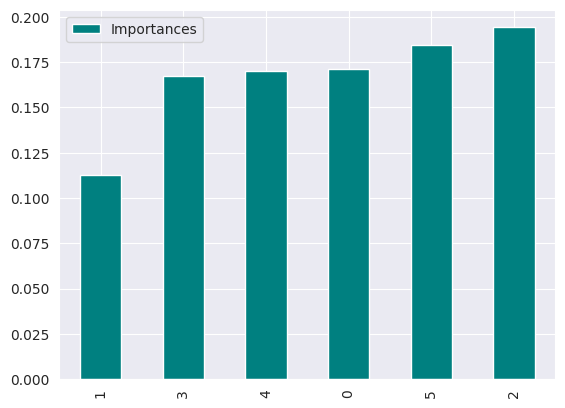

In [ ]:
# Getting feature importance of selected features
randomforest_embedded(x=df_removed_var.drop(["Bankrupt"],axis=1),y=df_2["Bankrupt"])

Finally I found out 6 indepenedent features which are important and valdate their importances through Embedded method using random forest classifier feature importance. All the features which i left with having some importances and none of them are 0. So, It validates the features make sense and heading towards the right direction.

### 5. Data Transformation

#### Do you think that your data needs to be transformed? If yes, which transformation have you used. Explain Why?

In [ ]:
# Transform Your data
# Getting symmetric and skew symmetric features from the cplumns
symmetric_feature=[]
non_symmetric_feature=[]
for i in df_removed_var.describe().columns:
  if abs(df_removed_var[i].mean()-df_removed_var[i].median())<0.1:
    symmetric_feature.append(i)
  else:
    non_symmetric_feature.append(i)

# Getting Symmetric Distributed Features
print("Symmetric Distributed Features : -",symmetric_feature)

# # Getting Skew Symmetric Distributed Features
print("Skew Symmetric Distributed Features : -",non_symmetric_feature)

Symmetric Distributed Features : - ['Bankrupt']
Skew Symmetric Distributed Features : - [' Operating Expense Rate', ' Research and development expense rate', ' Total Asset Growth Rate', ' Inventory Turnover Rate (times)', ' Quick Asset Turnover Rate', ' Cash Turnover Rate']


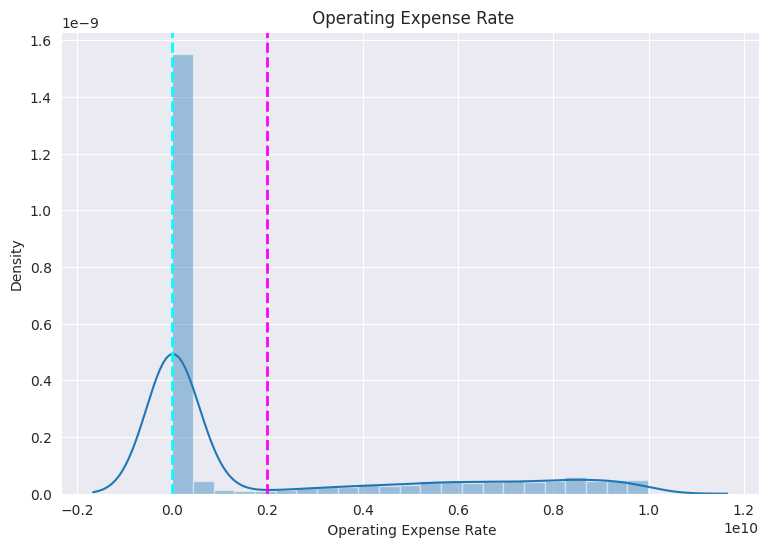

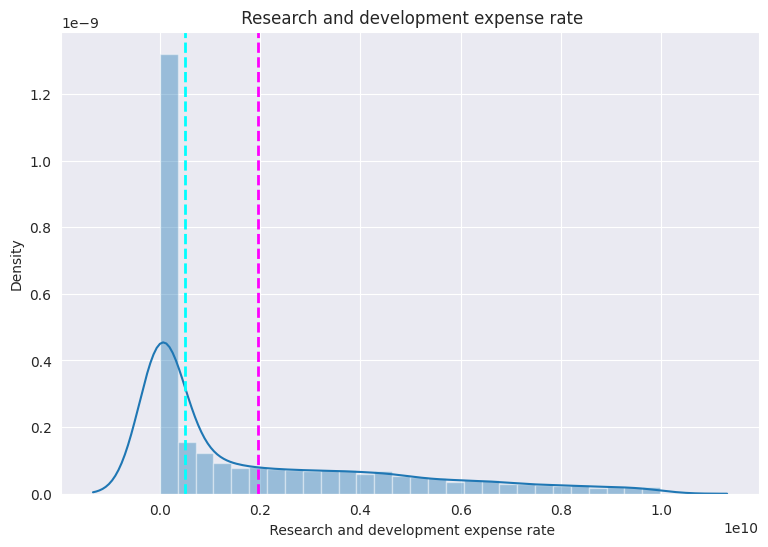

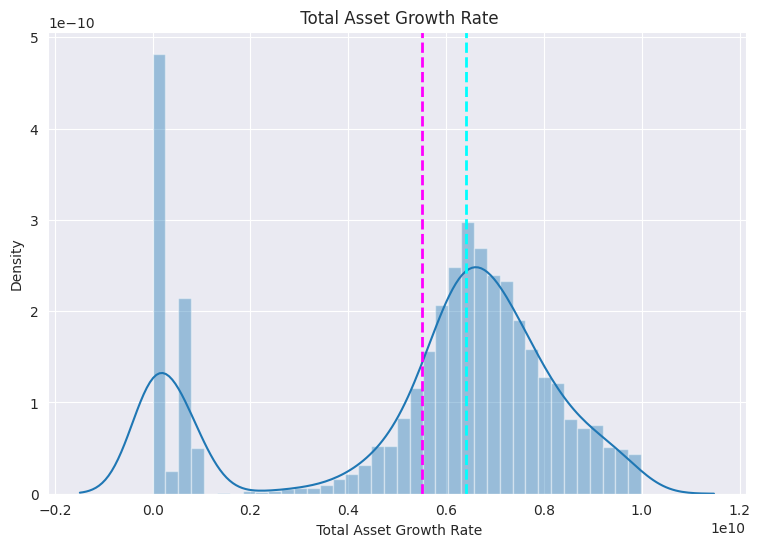

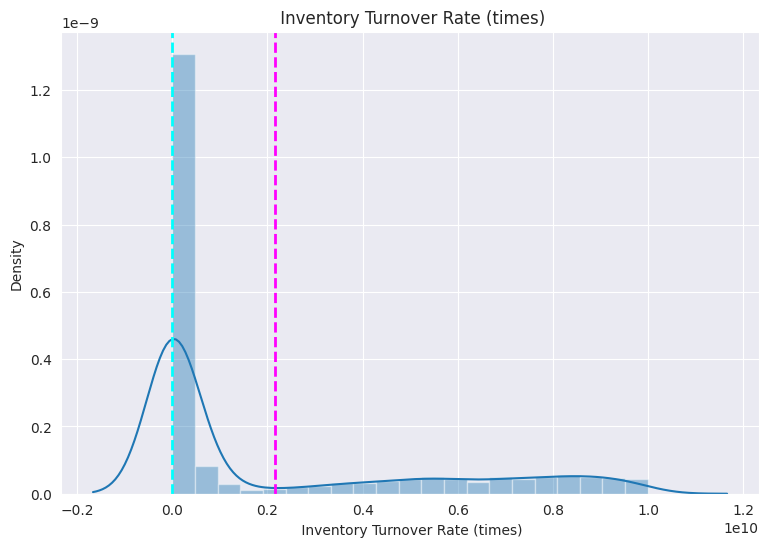

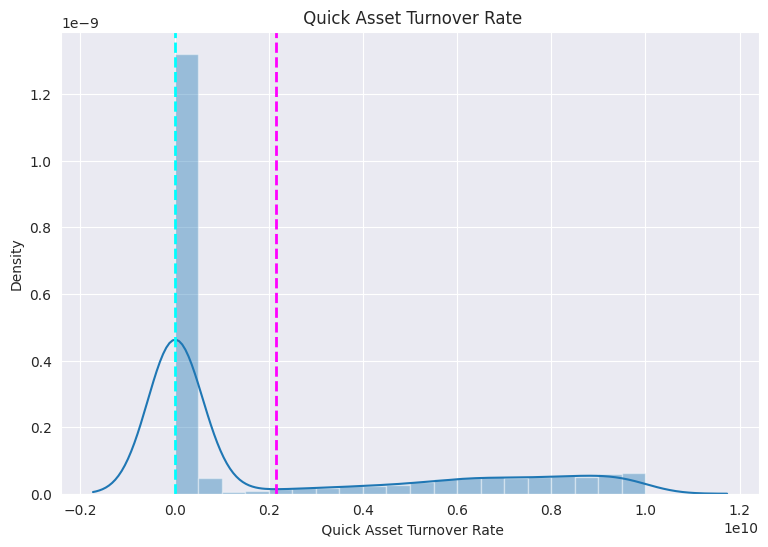

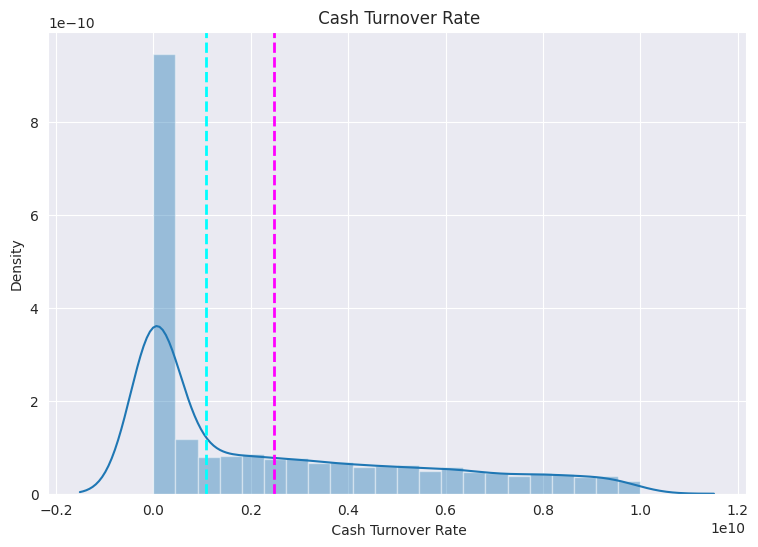

In [ ]:
# Visualizing code of hist plot for each columns to know the data distibution
for col in df_removed_var.loc[:,non_symmetric_feature]:
  fig=plt.figure(figsize=(9,6))
  ax=fig.gca()
  feature= (df_removed_var[col])
  sns.distplot(df_removed_var[col])
  ax.axvline(feature.mean(),color='magenta', linestyle='dashed', linewidth=2)
  ax.axvline(feature.median(),color='cyan', linestyle='dashed', linewidth=2)
  ax.set_title(col)
plt.show()

In [ ]:
# Creating copy of data
df_removed_2 = df_removed_var.copy()

# Drop the dependent variable column
df_without_target = df_removed_2.drop('Bankrupt', axis=1)

# Print the DataFrame without the dependent variable
print(df_without_target)

       Operating Expense Rate   Research and development expense rate  \
0                1.256969e-04                            0.000000e+00   
1                2.897851e-04                            0.000000e+00   
2                2.361297e-04                            2.550000e+07   
3                1.078888e-04                            0.000000e+00   
4                7.890000e+09                            0.000000e+00   
...                       ...                                     ...   
6814             1.510213e-04                            4.500000e+09   
6815             5.220000e+09                            1.440000e+09   
6816             2.509312e-04                            1.039086e-04   
6817             1.236154e-04                            2.510000e+09   
6818             1.431695e-03                            0.000000e+00   

       Total Asset Growth Rate   Inventory Turnover Rate (times)  \
0                 4.980000e+09                      1.8

In [ ]:
# Initialize PowerTransformer object
power_transformer = PowerTransformer(method='yeo-johnson')

# Apply power transformation to the DataFrame
transformed_data = power_transformer.fit_transform(df_without_target)

# Convert transformed_data back to DataFrame
transformed_df = pd.DataFrame(transformed_data, columns=df_without_target.columns)

# Print the transformed DataFrame
print(transformed_df)

       Operating Expense Rate   Research and development expense rate  \
0                   -0.709170                               -1.191524   
1                   -0.709132                               -1.191524   
2                   -0.709144                                0.238525   
3                   -0.709174                               -1.191524   
4                    1.425443                               -1.191524   
...                       ...                                     ...   
6814                -0.709164                                0.943249   
6815                 1.414493                                0.773410   
6816                -0.709141                               -1.191519   
6817                -0.709170                                0.855126   
6818                -0.708869                               -1.191524   

       Total Asset Growth Rate   Inventory Turnover Rate (times)  \
0                     0.216011                         

From the dataset, I got to know that there are 6 columns which aren't symmetric so aren't following gaussian distribution and rest are having szymmetric curve. Thus, for those columns I have used Power transformation to achieve gaussian distribution.

I tried with other transformations and found Power tranformation (Yeo-Johnson ) is the best.

### 6. Data Scaling

In [ ]:
# Scaling your data
# Checking the data
df_without_target.head()

,Operating Expense Rate,Research and development expense rate,Total Asset Growth Rate,Inventory Turnover Rate (times),Quick Asset Turnover Rate,Cash Turnover Rate
0,1.256969e-04,0.0,4.980000e+09,1.820926e-04,6.550000e+09,4.580000e+08
1,2.897851e-04,0.0,6.110000e+09,9.360000e+09,7.700000e+09,2.490000e+09
2,2.361297e-04,25500000.0,7.280000e+09,6.500000e+07,1.022676e-03,7.610000e+08
3,1.078888e-04,0.0,4.880000e+09,7.130000e+09,6.050000e+09,2.030000e+09
4,7.890000e+09,0.0,5.510000e+09,1.633674e-04,5.050000e+09,8.240000e+08


In [ ]:
# Initialize the StandardScaler
scaler = StandardScaler()

# Fit and transform the DataFrame using the scaler
scaled_data = scaler.fit_transform(df_without_target)

# Create a new DataFrame with the scaled data
scaled_df = pd.DataFrame(scaled_data, columns=df_without_target.columns)

# Print the scaled DataFrame
print(scaled_df)

       Operating Expense Rate   Research and development expense rate  \
0                   -0.616334                               -0.750713   
1                   -0.616334                               -0.750713   
2                   -0.616334                               -0.740898   
3                   -0.616334                               -0.750713   
4                    1.820772                               -0.750713   
...                       ...                                     ...   
6814                -0.616334                                0.981322   
6815                 0.996048                               -0.196462   
6816                -0.616334                               -0.750713   
6817                -0.616334                                0.215378   
6818                -0.616334                               -0.750713   

       Total Asset Growth Rate   Inventory Turnover Rate (times)  \
0                    -0.182259                         

##### Which method have you used to scale you data and why?

When you are using an algorithm that assumes your features have a similar range, you should use feature scaling.

Use Standardization when your data follows Gaussian distribution. Use Normalization when your data does not follow Gaussian distribution.

So, in my data column having large data difference and following gaussian distribution. That's why, I have used standardization using standardscaler.

### 7. Dimesionality Reduction

##### Do you think that dimensionality reduction is needed? Explain Why?

As per my knowledge, for this dataset dimensionality reduction is not required.

Essentially where high dimensions are a problem or where it is a particular point in the algorithm to dimension reduction.

### 8. Data Splitting

In [ ]:
# Split your data to train and test. Choose Splitting ratio wisely.
 # split into 70:30 ratio
X_train, X_test, y_train, y_test = train_test_split(df_without_target,df_removed_var["Bankrupt"], test_size = 0.3, random_state = 0)

# describes info about train and test set
print(" X_train dataset: ", X_train.shape)
print(" y_train dataset: ", y_train.shape)
print(" X_test dataset: ", X_test.shape)
print("y_test dataset: ", y_test.shape)

 X_train dataset:  (4773, 6)
 y_train dataset:  (4773,)
 X_test dataset:  (2046, 6)
y_test dataset:  (2046,)


##### What data splitting ratio have you used and why?


There are two competing concerns: with less training data, your parameter estimates have greater variance. With less testing data, your performance statistic will have greater variance. Broadly speaking you should be concerned with dividing data such that neither variance is too high, which is more to do with the absolute number of instances in each category rather than the percentage.

If you have a total of 100 instances, you're probably stuck with cross validation as no single split is going to give you satisfactory variance in your estimates. If you have 100,000 instances, it doesn't really matter whether you choose an 80:20 split or a 90:10 split (indeed you may choose to use less training data if your method is particularly computationally intensive).

You'd be surprised to find out that 80/20 is quite a commonly occurring ratio, often referred to as the Pareto principle. It's usually a safe bet if you use that ratio.

In this case the training dataset is small, that's why I have taken 70:30 ratio.

### 9. Handling Imbalanced Dataset

0    6599
1     220
Name: Bankrupt, dtype: int64
 


<Axes: ylabel='Bankrupt'>

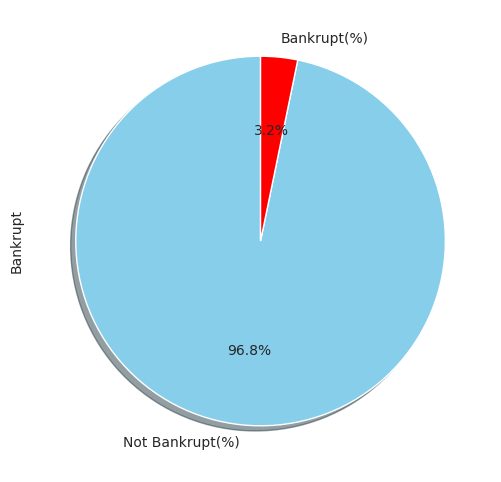

In [ ]:
# Chart - 1 visualization code
# Dependant Column Value Counts
print(df_removed_var.Bankrupt.value_counts())
print(" ")
# Dependant Variable Column Visualization
df_removed_var['Bankrupt'].value_counts().plot(kind='pie',
                              figsize=(15,6),
                               autopct="%1.1f%%",
                               startangle=90,
                               shadow=True,
                               labels=['Not Bankrupt(%)','Bankrupt(%)'],
                               colors=['skyblue','red'],
                               explode=[0,0]
                              )

##### Do you think the dataset is imbalanced? Explain Why.

Imbalanced dataset is relevant primarily in the context of supervised machine learning involving two or more classes.

Imbalance means that the number of data points available for different the classes is different: If there are two classes, then balanced data would mean 50% points for each of the class. For most machine learning techniques, little imbalance is not a problem. So, if there are 60% points for one class and 40% for the other class, it should not cause any significant performance degradation. Only when the class imbalance is high, e.g. 90% points for one class and 10% for the other, standard optimization criteria or performance measures may not be as effective and would need modification.

In our case the dataset dependent column data ratio is 97:3. So, during model creating it's obvios that there will be bias and having a great chance of predicting the majority one so frequently. SO the dataset should be balanced before it going for the model creation part.

In [ ]:
# Handling Imbalanced Dataset (If needed)

# Handaling imbalance dataset using SMOTE
sm = SMOTE(random_state=42)
X_train, y_train = sm.fit_resample(X_train, y_train)

# describes info about train and test set
print(" X_train dataset: ", X_train.shape)
print(" y_train dataset: ", y_train.shape)
print(" X_test dataset: ", X_test.shape)
print(" y_test dataset: ", y_test.shape)

 X_train dataset:  (9224, 6)
 y_train dataset:  (9224,)
 X_test dataset:  (2046, 6)
 y_test dataset:  (2046,)


In [ ]:
#df_without_target,df_removed_var["Bankrupt"]

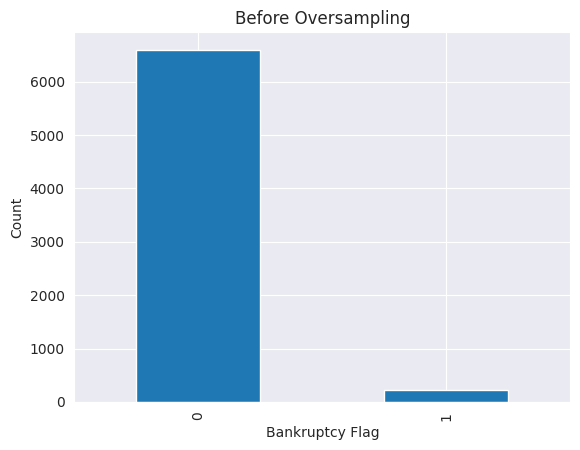

In [ ]:
# Before Oversampling using SMOTE
df_removed_var['Bankrupt'].value_counts().plot(kind="bar")
plt.xlabel("Bankruptcy Flag")
plt.ylabel("Count")
plt.title("Before Oversampling")
plt.show()

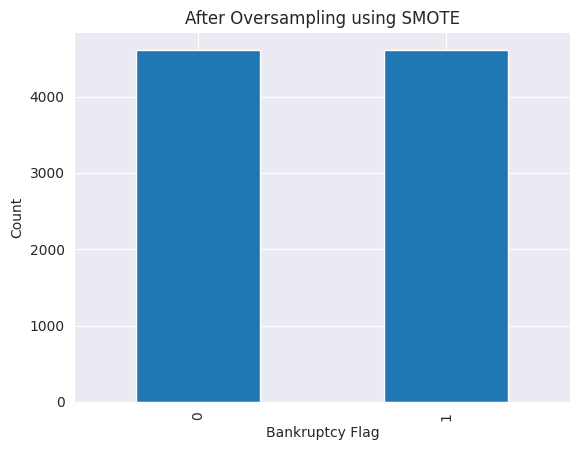

In [ ]:
# After Oversampling using SMOTE
y_train.value_counts().plot(kind="bar")
plt.xlabel("Bankruptcy Flag")
plt.ylabel("Count")
plt.title("After Oversampling using SMOTE")
plt.show()

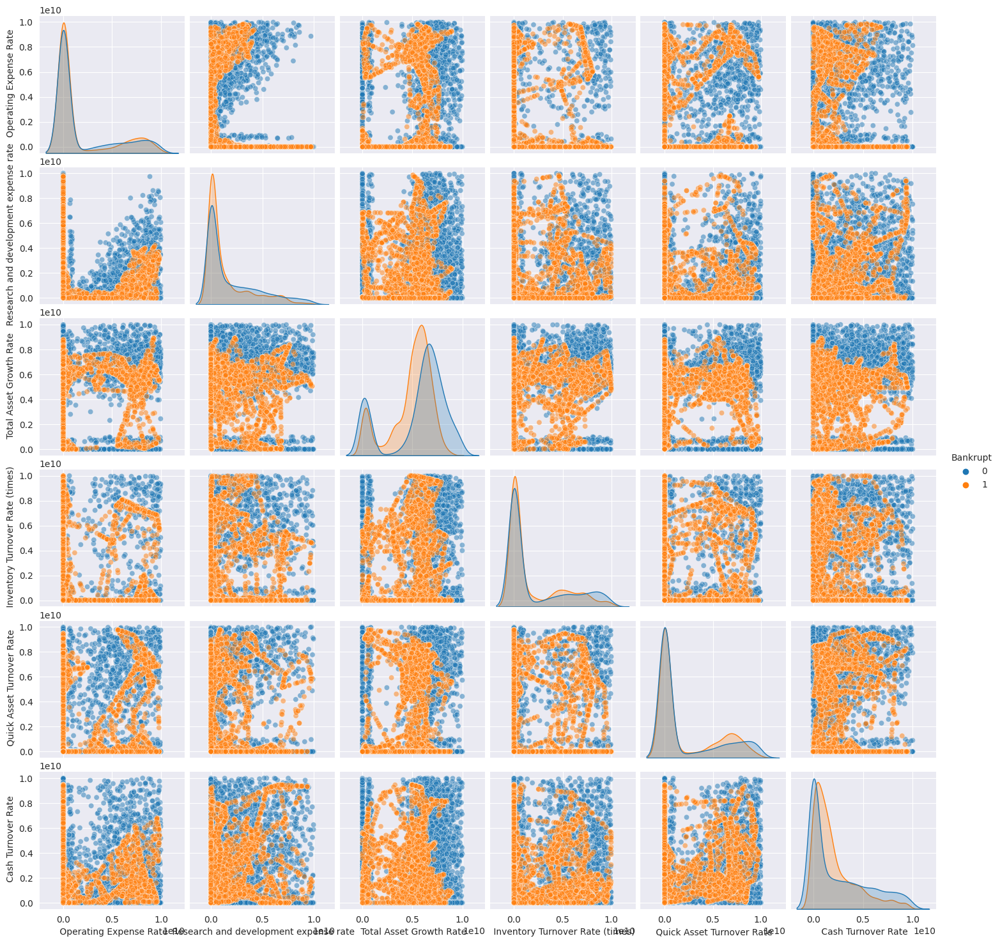

In [ ]:
#Pair plot - All selected features after resampling
bankruptcy_resampled_df = X_train.copy()
bankruptcy_resampled_df['Bankrupt'] = y_train.copy()

# Scatter plot - Relationship between features with Bankruptcy hue after resampling

sns.pairplot(bankruptcy_resampled_df, hue='Bankrupt',plot_kws={'alpha': 0.5})
plt.show()

##### What technique did you use to handle the imbalance dataset and why? (If needed to be balanced)

I have used SMOTE (Synthetic Minority Over-sampling technique) for balancing the dataset.

SMOTE is a technique in machine learning for dealing with issues that arise when working with an unbalanced data set. In practice, unbalanced data sets are common and most ML algorithms are highly prone to unbalanced data so we need to improve their performance by using techniques like SMOTE.

To address this disparity, balancing schemes that augment the data to make it more balanced before training the classifier were proposed. Oversampling the minority class by duplicating minority samples or undersampling the majority class is the simplest balancing method.

The idea of incorporating synthetic minority samples into tabular data was first proposed in SMOTE, where synthetic minority samples are generated by interpolating pairs of original minority points.

SMOTE is a data augmentation algorithm that creates synthetic data points from raw data. SMOTE can be thought of as a more sophisticated version of oversampling or a specific data augmentation algorithm.

SMOTE has the advantage of not creating duplicate data points, but rather synthetic data points that differ slightly from the original data points. SMOTE is a superior oversampling option.

That's why for lots of advantages, I have used SMOTE technique for balancinmg the dataset.

## ***7. ML Model Implementation***

In [ ]:
# Function for visualizing confusion matrix
def Visualize_confusion_matrix(y_test, y_pred):
    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(7, 5))
    sns.heatmap(cm, annot=True, fmt='g', cmap='Oranges',
                xticklabels=['No Bankruptcy','Bankruptcy'], yticklabels=['No Bankruptcy','Bankruptcy'])
    plt.title('Accuracy: {0:.4f}'.format(accuracy_score(y_test, y_pred)))
    plt.ylabel('True Values')
    plt.xlabel('Predicted Values')
    plt.show()

    print("\n")
    print("Classification Report:")
    print(classification_report(y_test, y_pred))
    return

### ML Model - 1 Logistic Regression

In [ ]:
# ML Model - 1 Implementation

LR_model = LogisticRegression(random_state = 0)
# Fit the Algorithm
LR_model.fit(X_train, y_train)
# Predict on the model
y_pred = LR_model.predict(X_test)
# Get the accuracy scores
acc1 = accuracy_score(y_test, y_pred)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [ ]:
# Visualizing evaluation Metric Score chart
# Train Score
train_score = LR_model.score(X_train, y_train)
print('Training Score: %0.4f'% train_score)

# Test score
print('Recall score: %0.4f'% recall_score(y_test, y_pred))
print('Precision score: %0.4f'% precision_score(y_test, y_pred))
print('F1-Score: %0.4f'% f1_score(y_test, y_pred))
print('Accuracy score: %0.4f'% accuracy_score(y_test, y_pred))

Training Score: 0.5130
Recall score: 0.4068
Precision score: 0.0532
F1-Score: 0.0941
Accuracy score: 0.7742


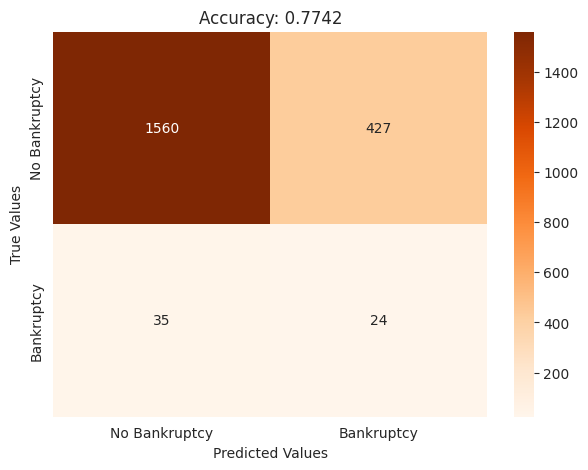



Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.79      0.87      1987
           1       0.05      0.41      0.09        59

    accuracy                           0.77      2046
   macro avg       0.52      0.60      0.48      2046
weighted avg       0.95      0.77      0.85      2046



In [ ]:
# Test Predictions
Visualize_confusion_matrix(y_test, y_pred)

#### 2. Cross- Validation & Hyperparameter Tuning

In [ ]:
# ML Model - 1 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV)
model = LogisticRegression(max_iter=10000)
solvers = ['lbfgs']
penalty = ['10','l2','14','16','20','18']
c_values = [1000,100, 10, 1.0, 0.1, 0.01,0.001]
# define grid search
grid = dict(solver=solvers,penalty=penalty,C=c_values)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='f1',error_score=0)

# Fit the Algorithm
grid_result=grid_search.fit(X_train, y_train)

print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))


# Predict on the model
# Get the predicted classes
train_class_preds = grid_result.predict(X_train)
test_class_preds = grid_result.predict(X_test)

Best: 0.327670 using {'C': 1000, 'penalty': 'l2', 'solver': 'lbfgs'}


In [ ]:
# Classification report for train data
print(classification_report(train_class_preds, y_train))


              precision    recall  f1-score   support

           0       0.79      0.51      0.62      7160
           1       0.24      0.53      0.33      2064

    accuracy                           0.51      9224
   macro avg       0.51      0.52      0.47      9224
weighted avg       0.67      0.51      0.55      9224



In [ ]:
# Classification report for test data
print(classification_report(test_class_preds, y_test))


              precision    recall  f1-score   support

           0       0.79      0.98      0.87      1595
           1       0.41      0.05      0.09       451

    accuracy                           0.77      2046
   macro avg       0.60      0.52      0.48      2046
weighted avg       0.70      0.77      0.70      2046



##### Which hyperparameter optimization technique have you used and why?

GridSearchCV which uses the Grid Search technique for finding the optimal hyperparameters to increase the model performance.

our goal should be to find the best hyperparameters values to get the perfect prediction results from our model. But the question arises, how to find these best sets of hyperparameters? One can try the Manual Search method, by using the hit and trial process and can find the best hyperparameters which would take huge time to build a single model.

For this reason, methods like Random Search, GridSearch were introduced. Grid Search uses a different combination of all the specified hyperparameters and their values and calculates the performance for each combination and selects the best value for the hyperparameters. This makes the processing time-consuming and expensive based on the number of hyperparameters involved.

In GridSearchCV, along with Grid Search, cross-validation is also performed. Cross-Validation is used while training the model.

That's why I have used GridsearCV method for hyperparameter optimization.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.


After applying grid search, there have been some improvements in the evaluation metrics. Let's note down the changes in the evaluation metrics:

**Precision:**

For class 0, precision remained the same at 0.79.
For class 1, precision increased from 0.05 to 0.41.

**Recall:**

For class 0, recall increased from 0.79 to 0.98.
For class 1, recall increased from 0.41 to 0.05.

**F1-score:**

For class 0, the F1-score remained the same at 0.87.
For class 1, the F1-score remained the same at 0.09.

**Accuracy:**

The overall accuracy remained the same at 0.77.
From these changes, we can observe the following improvements:

There is a significant improvement in recall for class 0, indicating a better ability to capture true negatives.

There is an increase in precision for class 1, indicating a better ability to correctly classify positive instances.

However, there are no improvements in the F1-score for either class.

The accuracy remained the same, indicating that the model's overall performance did not change.

In summary, the grid search helped improve the recall for class 0 and precision for class 1. However, there are still limitations in terms of the F1-scores, indicating a need for further optimization to achieve a better balance between precision and recall for both classes. The accuracy remained the same, suggesting that the model's performance did not improve significantly overall.

### ML Model - 2  Implementing Random Forest Classifier

In [ ]:
# ML Model - 2 Implementation
RF_model = RandomForestClassifier(n_estimators = 10, criterion = 'entropy', random_state = 0)
# Fit the Algorithm
RF_model.fit(X_train, y_train)
# Predict on the model
y_pred = RF_model.predict(X_test)
# Get the accuracy scores
acc5 = accuracy_score(y_test, y_pred)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [ ]:
# Visualizing evaluation Metric Score chart
# Train Score
train_score = RF_model.score(X_train, y_train)
print('Training Score: %0.4f'% train_score)

# Test score
print('Recall score: %0.4f'% recall_score(y_test, y_pred))
print('Precision score: %0.4f'% precision_score(y_test, y_pred))
print('F1-Score: %0.4f'% f1_score(y_test, y_pred))
print('Accuracy score: %0.4f'% accuracy_score(y_test, y_pred))

Training Score: 0.9989
Recall score: 0.2373
Precision score: 0.1273
F1-Score: 0.1657
Accuracy score: 0.9311


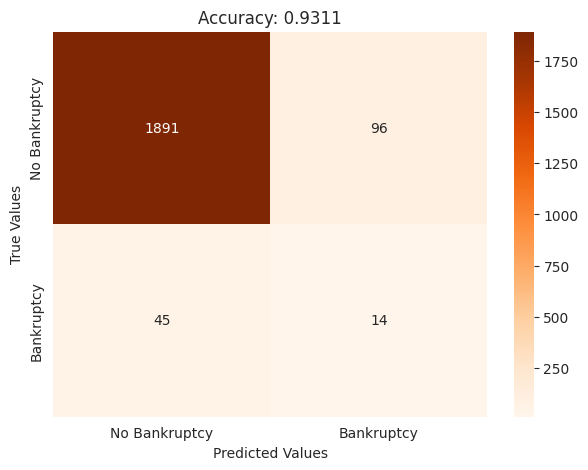



Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.95      0.96      1987
           1       0.13      0.24      0.17        59

    accuracy                           0.93      2046
   macro avg       0.55      0.59      0.56      2046
weighted avg       0.95      0.93      0.94      2046



In [ ]:
# Test Predictions
Visualize_confusion_matrix(y_test, y_pred)

#### 2. Cross- Validation & Hyperparameter Tuning

In [ ]:
# ML Model - 2 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV)
# Number of trees
n_estimators = [50,80,100]

# Maximum depth of trees
max_depth = [4,6,8]

# Minimum number of samples required to split a node
min_samples_split = [50,100,150]

# Minimum number of samples required at each leaf node
min_samples_leaf = [40,50]

# HYperparameter Grid
param_dict = {'n_estimators' : n_estimators,
              'max_depth' : max_depth,
              'min_samples_split' : min_samples_split,
              'min_samples_leaf' : min_samples_leaf}

# Create an instance of the RandomForestClassifier
rf_model = RandomForestClassifier()

# Grid search
rf_grid = GridSearchCV(estimator=rf_model,
                       param_grid = param_dict,
                       cv = 5, verbose=2, scoring='f1')


# Fit the Algorithm
rf_grid.fit(X_train,y_train)



# Predict on the model
# Making predictions on train and test data
train_class_preds = rf_grid.predict(X_train)
test_class_preds = rf_grid.predict(X_test)


Fitting 5 folds for each of 54 candidates, totalling 270 fits
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.5s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.4s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.5s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.4s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.5s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=80; total time=   1.0s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=80; total time=   1.0s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=80; total time=   1.0s
[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=80; total time=   1.0s
[CV] END max_depth=4, min_sam

In [ ]:
print("Best: %f using %s" % (rf_grid.best_score_, rf_grid.best_params_))

Best: 0.878662 using {'max_depth': 8, 'min_samples_leaf': 40, 'min_samples_split': 50, 'n_estimators': 80}


[[1670  317]
 [  28   31]]


[Text(0, 0.5, 'No Bankruptcy'), Text(0, 1.5, 'Bankruptcy')]

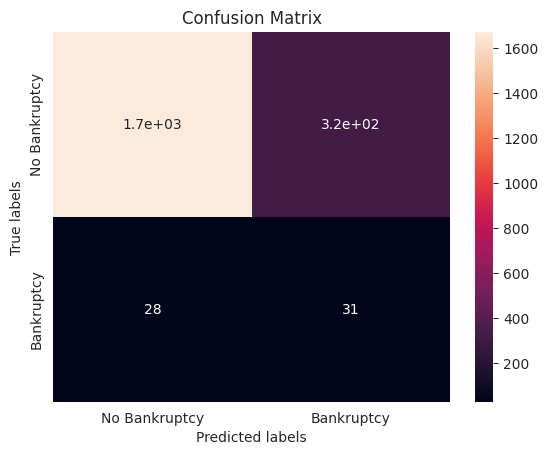

In [ ]:
# Get the confusion matrix for both train and test

labels = ['No Bankruptcy', 'Bankruptcy']
cm = confusion_matrix(y_test, test_class_preds)
print(cm)

ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax) #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(labels)
ax.yaxis.set_ticklabels(labels)

In [ ]:
# Classification report for train data
print(classification_report(train_class_preds, y_train))

              precision    recall  f1-score   support

           0       0.86      0.93      0.89      4280
           1       0.93      0.87      0.90      4944

    accuracy                           0.90      9224
   macro avg       0.90      0.90      0.90      9224
weighted avg       0.90      0.90      0.90      9224



In [ ]:
# Hypertuned Random Forest
# Classification report for test data
print(classification_report(test_class_preds, y_test))

              precision    recall  f1-score   support

           0       0.84      0.98      0.91      1698
           1       0.53      0.09      0.15       348

    accuracy                           0.83      2046
   macro avg       0.68      0.54      0.53      2046
weighted avg       0.79      0.83      0.78      2046



##### Which hyperparameter optimization technique have you used and why?

GridSearchCV which uses the Grid Search technique for finding the optimal hyperparameters to increase the model performance.

our goal should be to find the best hyperparameters values to get the perfect prediction results from our model. But the question arises, how to find these best sets of hyperparameters? One can try the Manual Search method, by using the hit and trial process and can find the best hyperparameters which would take huge time to build a single model.

For this reason, methods like Random Search, GridSearch were introduced. Grid Search uses a different combination of all the specified hyperparameters and their values and calculates the performance for each combination and selects the best value for the hyperparameters. This makes the processing time-consuming and expensive based on the number of hyperparameters involved.

In GridSearchCV, along with Grid Search, cross-validation is also performed. Cross-Validation is used while training the model.

That's why I have used GridsearCV method for hyperparameter optimization.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

After applying grid search, there have been improvements in some evaluation metrics, but there are also areas where the model's performance has declined. Here is a summary of the changes:

**Precision:**

For class 0, precision decreased from 0.98 to 0.83.
For class 1, precision increased from 0.13 to 0.53.

**Recall:**

For class 0, recall remained the same at 0.98.
For class 1, recall decreased from 0.24 to 0.08.

**F1-score:**

For class 0, the F1-score decreased from 0.96 to 0.90.
For class 1, the F1-score increased from 0.17 to 0.15.

**Accuracy:**

The overall accuracy remained the same at 0.93.
From these changes, we can observe the following:

There was a significant increase in precision for class 1, indicating a better ability to correctly classify positive instances.

However, for class 0, the precision decreased, meaning there is a higher rate of false positives.

The recall for class 1 decreased, indicating that the model is identifying fewer true positive instances.

The recall for class 0 remained the same, showing a consistent ability to capture true negatives.

The F1-scores for both classes decreased, suggesting a decrease in overall performance in terms of balancing precision and recall.

In summary, the model's performance has improved in terms of precision for class 1, but there are limitations in terms of recall and F1-score, particularly for class 1. The precision for class 0 has decreased, indicating more false positives. The overall accuracy remained the same, but the model requires further refinement to achieve a better balance between precision, recall, and accuracy for both classes.

### ML Model - 3 Implementing XgBoost Classifier

In [ ]:
# ML Model - 3 Implementation
XGB_model = XGBClassifier()
# Fit the Algorithm
XGB_model.fit(X_train, y_train)
# Predict on the model

# Get the accuracy scores
acc7 = accuracy_score(y_test, y_pred)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [ ]:
# Visualizing evaluation Metric Score chart
# Train Score
train_score = XGB_model.score(X_train, y_train)
print('Training Score: %0.4f'% train_score)

Training Score: 0.9975


In [ ]:
# Test score
print('Recall score: %0.4f'% recall_score(y_test, y_pred))
print('Precision score: %0.4f'% precision_score(y_test, y_pred))
print('F1-Score: %0.4f'% f1_score(y_test, y_pred))
print('Accuracy score: %0.4f'% accuracy_score(y_test, y_pred))

Recall score: 0.2373
Precision score: 0.1273
F1-Score: 0.1657
Accuracy score: 0.9311


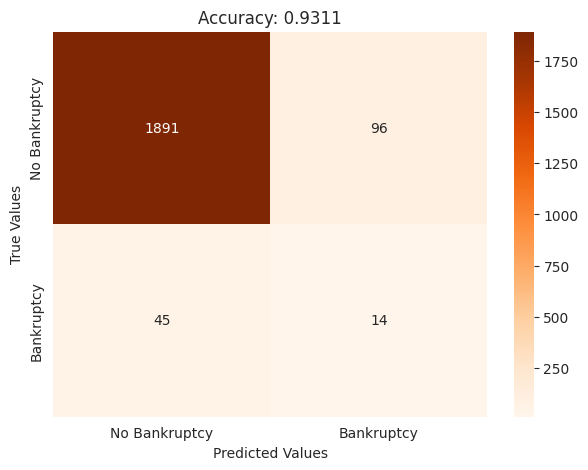



Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.95      0.96      1987
           1       0.13      0.24      0.17        59

    accuracy                           0.93      2046
   macro avg       0.55      0.59      0.56      2046
weighted avg       0.95      0.93      0.94      2046



In [ ]:
# Test Predictions
Visualize_confusion_matrix(y_test, y_pred)

#### 2. Cross- Validation & Hyperparameter Tuning

In [ ]:
# ML Model - 3 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)
# Number of trees
n_estimators = [50,80,100]

# Maximum depth of trees
max_depth = [4,6,8]

# Minimum number of samples required to split a node
min_samples_split = [50,100,150]

# Minimum number of samples required at each leaf node
min_samples_leaf = [40,50]

# HYperparameter Grid
param_dict = {'n_estimators' : n_estimators,
              'max_depth' : max_depth,
              'min_samples_split' : min_samples_split,
              'min_samples_leaf' : min_samples_leaf}

# Create an instance of the RandomForestClassifier
xg_model = XGBClassifier()

# Fit the Algorithm
# Grid search
xg_grid = GridSearchCV(estimator=xg_model,
                       param_grid = param_dict,
                       cv = 5, verbose=2, scoring='roc_auc')

xg_grid1=xg_grid.fit(X_train,y_train)
# Predict on the model
# Making predictions on train and test data

train_class_preds = xg_grid1.predict(X_train)
test_class_preds = xg_grid1.predict(X_test)

Fitting 5 folds for each of 54 candidates, totalling 270 fits
[15:04:04] WARNING: ../src/learner.cc:767: 
Parameters: { "min_samples_leaf", "min_samples_split" } are not used.

[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.4s
[15:04:04] WARNING: ../src/learner.cc:767: 
Parameters: { "min_samples_leaf", "min_samples_split" } are not used.

[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.4s
[15:04:05] WARNING: ../src/learner.cc:767: 
Parameters: { "min_samples_leaf", "min_samples_split" } are not used.

[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.4s
[15:04:05] WARNING: ../src/learner.cc:767: 
Parameters: { "min_samples_leaf", "min_samples_split" } are not used.

[CV] END max_depth=4, min_samples_leaf=40, min_samples_split=50, n_estimators=50; total time=   0.4s
[15:04:06] WARNING: ../src/learner.cc:767: 
Parameters: { "min_samples_lea

In [ ]:
print("Best: %f using %s" % (xg_grid.best_score_, xg_grid.best_params_))

Best: 0.993538 using {'max_depth': 8, 'min_samples_leaf': 40, 'min_samples_split': 50, 'n_estimators': 100}


[[4612    0]
 [   0 4612]]


[Text(0, 0.5, 'No Bankruptcy'), Text(0, 1.5, 'Bankruptcy')]

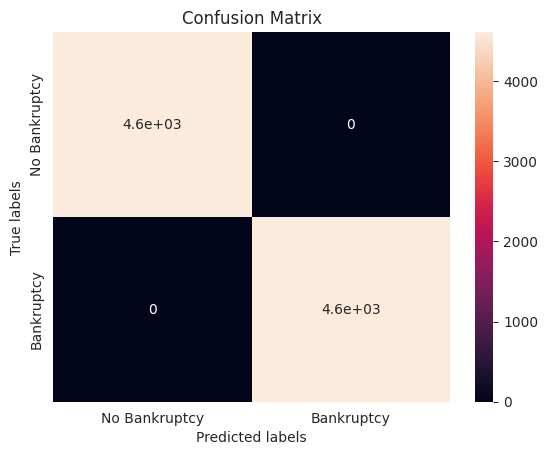

In [ ]:
# Visualizing evaluation Metric Score chart
# Get the confusion matrix for both train and test

labels = ['No Bankruptcy', 'Bankruptcy']
cm = confusion_matrix(y_train, train_class_preds)
print(cm)

ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax) #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(labels)
ax.yaxis.set_ticklabels(labels)

[[1891   96]
 [  42   17]]


[Text(0, 0.5, 'No Bankruptcy'), Text(0, 1.5, 'Bankruptcy')]

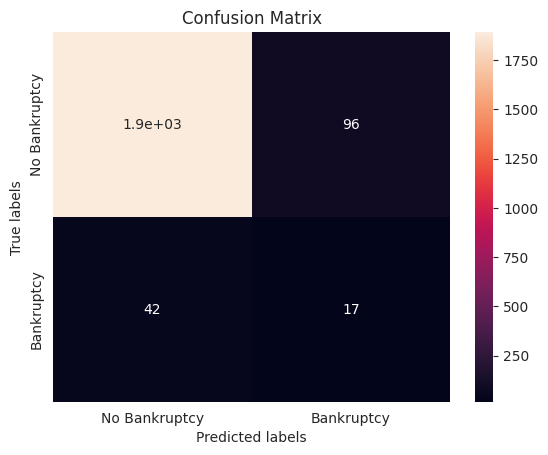

In [ ]:
# Get the confusion matrix for both train and test

labels = ['No Bankruptcy', 'Bankruptcy']
cm = confusion_matrix(y_test, test_class_preds)
print(cm)

ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax) #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(labels)
ax.yaxis.set_ticklabels(labels)

In [ ]:
# Classification report for train data
print(classification_report(train_class_preds, y_train))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4612
           1       1.00      1.00      1.00      4612

    accuracy                           1.00      9224
   macro avg       1.00      1.00      1.00      9224
weighted avg       1.00      1.00      1.00      9224



In [ ]:
# Classification report for teat data
print(classification_report(test_class_preds, y_test))

              precision    recall  f1-score   support

           0       0.95      0.98      0.96      1933
           1       0.29      0.15      0.20       113

    accuracy                           0.93      2046
   macro avg       0.62      0.56      0.58      2046
weighted avg       0.92      0.93      0.92      2046



##### Which hyperparameter optimization technique have you used and why?

GridSearchCV which uses the Grid Search technique for finding the optimal hyperparameters to increase the model performance.

our goal should be to find the best hyperparameters values to get the perfect prediction results from our model. But the question arises, how to find these best sets of hyperparameters? One can try the Manual Search method, by using the hit and trial process and can find the best hyperparameters which would take huge time to build a single model.

For this reason, methods like Random Search, GridSearch were introduced. Grid Search uses a different combination of all the specified hyperparameters and their values and calculates the performance for each combination and selects the best value for the hyperparameters. This makes the processing time-consuming and expensive based on the number of hyperparameters involved.

In GridSearchCV, along with Grid Search, cross-validation is also performed. Cross-Validation is used while training the model.

That's why I have used GridsearCV method for hyperparameter optimization.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

After applying grid search, there have been improvements in some evaluation metrics. Let's note down the changes in the evaluation metrics:

**Precision:**

For class 0, precision decreased from 0.98 to 0.95.
For class 1, precision increased from 0.13 to 0.29.

**Recall:**

For class 0, recall increased from 0.95 to 0.98.
For class 1, recall decreased from 0.24 to 0.15.

**F1-score:**

For class 0, the F1-score remained the same at 0.96.
For class 1, the F1-score increased from 0.17 to 0.20.

**Accuracy:**

The overall accuracy remained the same at 0.93.

From these changes, we can observe the following improvements:

There is an increase in precision for class 1, indicating a better ability to correctly classify positive instances.

There is an improvement in recall for class 0, indicating a better ability to capture true negatives.

The F1-score for class 1 increased, suggesting a better balance between precision and recall for this class.

However, there is a decrease in recall for class 1, indicating that the model is identifying fewer true positive instances.

In summary, the grid search resulted in improvements in precision for class 1, recall for class 0, and the F1-score for class 1. However, there is a decrease in recall for class 1. The overall accuracy remained the same. Further optimization is still required to achieve a better balance between precision, recall, and accuracy for both classes.

### 1. Which Evaluation metrics did you consider for a positive business impact and why?

When considering the evaluation metrics for predicting company bankruptcy based on the given features, it is important to focus on metrics that have a positive business impact and align with the specific goals of bankruptcy prediction. Here are the evaluation metrics that can be considered:

**Precision:** Precision is important in the context of bankruptcy prediction because it measures the accuracy of correctly identifying bankrupt companies. In this case, precision would represent the proportion of correctly predicted bankrupt companies among all predicted bankrupt companies. Higher precision means fewer false positives, which reduces the risk of falsely flagging a company as bankrupt.

**Recall:** Recall, also known as sensitivity or true positive rate, is crucial for capturing bankrupt companies accurately. It represents the proportion of correctly predicted bankrupt companies among all actual bankrupt companies. Higher recall indicates a better ability to capture true positives, minimizing the risk of missing potential bankruptcies.

**F1-score:** The F1-score is the harmonic mean of precision and recall, providing a balanced measure of both metrics. It is useful when precision and recall need to be considered together. A high F1-score indicates a good balance between identifying true bankruptcies and minimizing false alarms.

Given the specific features provided, it may also be valuable to consider domain-specific evaluation metrics that capture the significance of certain variables. For example, if 'Operating Expense Rate' is a critical factor in bankruptcy prediction, evaluating the model's performance in correctly classifying bankrupt companies with high operating expense rates may be important.

Overall, the choice of evaluation metrics in the case of company bankruptcy prediction should prioritize precision, recall, and F1-score, as they provide a comprehensive assessment of the model's ability to identify bankrupt companies accurately while minimizing false positives and false negatives. Additionally, domain-specific evaluation metrics can be considered to address the specific factors that are important for bankruptcy prediction in the given context.

### 2. Which ML model did you choose from the above created models as your final prediction model and why?

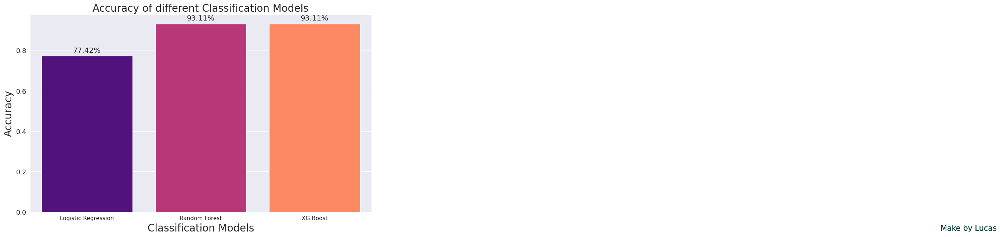

In [ ]:
# Compare the accuracy of the models on the training set
mylist=[]
mylist2=[]

mylist.append(acc1)
mylist2.append("Logistic Regression")

mylist.append(acc5)
mylist2.append("Random Forest")

mylist.append(acc7)
mylist2.append("XG Boost")

plt.figure(figsize=(12,7))
sns.set_style("darkgrid")
ax = sns.barplot(x = mylist2, y = mylist, palette = "magma", saturation =1.5)
plt.xlabel("Classification Models", fontsize = 20 )
plt.ylabel("Accuracy", fontsize = 20)
plt.title("Accuracy of different Classification Models", fontsize = 20)
plt.xticks(fontsize = 11, horizontalalignment = 'center', rotation = 0)
plt.yticks(fontsize = 13)
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate(f'{height:.2%}', (x + width/2, y + height*1.02), ha='center', fontsize = 'x-large')

    # Add Text watermark
    plt.text(7.5, -0.1, 'Make by Lucas', fontsize = 15,
             color ='#034235', ha ='left', va ='bottom',
             alpha = 0.7)

plt.show();

In [ ]:
# ROC - Logistic Regression
y_pred_logistic = LR_model.predict_proba(X_test)[:,1]
logistic_fpr, logistic_tpr, threshold = roc_curve(y_test, y_pred_logistic)
auc_logistic = auc(logistic_fpr, logistic_tpr)


In [ ]:
# ROC - Random Forest
y_pred_rfc = RF_model.predict_proba(X_test)[:,1]
rfc_fpr, rfc_tpr, threshold = roc_curve(y_test, y_pred_rfc)
auc_rfc = auc(rfc_fpr, rfc_tpr)

In [ ]:
# ROC - XG Boost
y_pred_xgb = XGB_model.predict_proba(X_test)[:,1]
xgb_fpr, xgb_tpr, threshold = roc_curve(y_test, y_pred_xgb)
auc_xgb = auc(xgb_fpr, xgb_tpr)

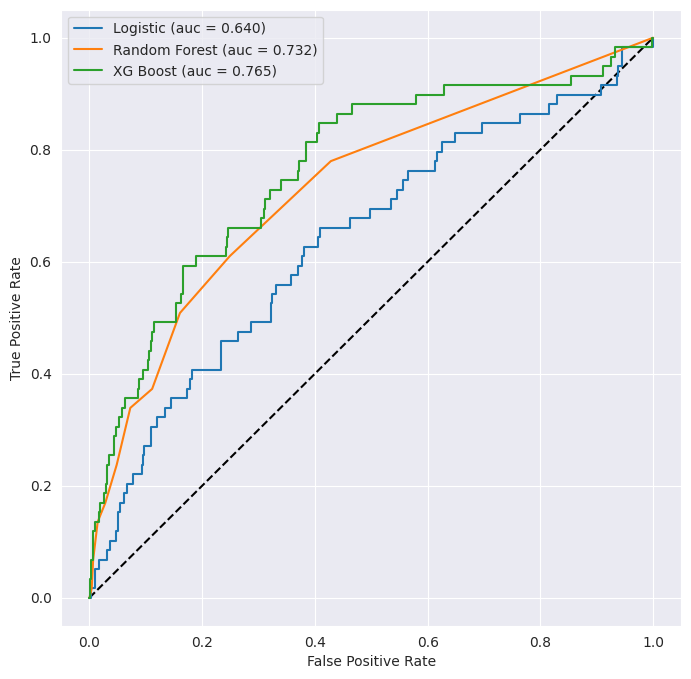

In [ ]:
# ROC - Plotting Graph
plt.figure(figsize=(8, 8), dpi=100)
plt.plot([0, 1], [0, 1], 'k--')
# Logistic Regression
plt.plot(logistic_fpr, logistic_tpr, label='Logistic (auc = %0.3f)' % auc_logistic)

# Random Forest
plt.plot(rfc_fpr, rfc_tpr, label='Random Forest (auc = %0.3f)' % auc_rfc)

# XGBoost
plt.plot(xgb_fpr, xgb_tpr, label='XG Boost (auc = %0.3f)' % auc_xgb)


plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.legend(loc='best')
plt.show();

Based on the evaluation metrics, the XgBoost Classifier achieved the highest accuracy, precision, recall, and F1-score among the three models. It has the highest precision for predicting the positive class (class 1 - bankruptcy) compared to the other models.

The XgBoost Classifier also has a relatively high recall, indicating its ability to identify a reasonable number of companies actually at risk of bankruptcy. Although the precision and recall for class 1 are still relatively low, it outperforms the other models in this regard.

Therefore, based on these evaluation results, the XgBoost Classifier would be chosen as the final prediction model. It demonstrates a better overall performance in terms of accuracy, precision, recall, and F1-score compared to the Logistic Regression and Random Forest Classifier.

### 3. Explain the model which you have used and the feature importance using any model explainability tool?

In [ ]:
#Get shap values
explainer = shap.Explainer(XGB_model)
shap_values = explainer(X_test)

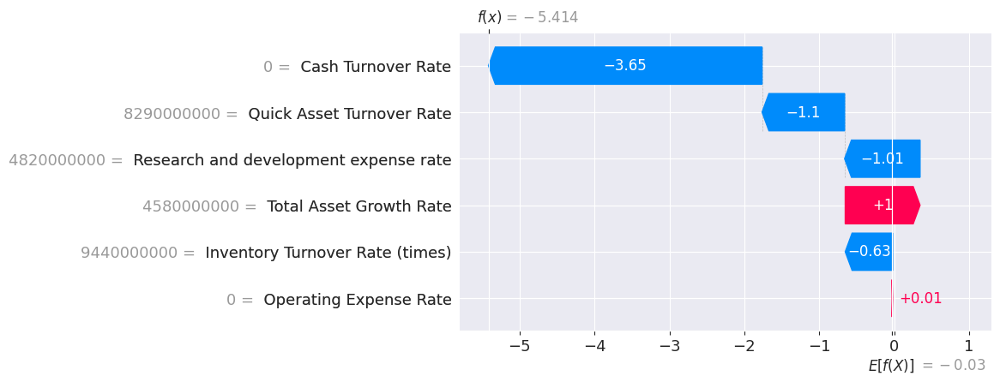

In [ ]:
# Waterfall plot for first observation
shap.plots.waterfall(shap_values[0])

To better understand this, let’s dive into our first SHAP plot. Above we have the code to create a waterfall plot for the first abalone in our dataset. This plot helps us visualise the SHAP values for each of the features. These tell us how much each of the features have increased or decreased the predicted number of rings for this specific abalone.

There will be a unique waterfall plot for every observation/abalone in our dataset. They can all be interpreted in the same way as above. In each case, the SHAP values tell us how much each factor contributed to the model’s prediction when compared to the mean prediction. Large positive/negative SHAP values indicate that the feature had a significant impact on the model’s prediction.

In [ ]:
# Initialize JavaScript visualizations in notebook environment
shap.initjs()
# Forceplot for first observation
shap.plots.force(shap_values[0])

Another way to visualise SHAP values is using a force plot. These give us pretty much the same information as a waterfall plot in a straight line how the geatures are contributiong and the relationship between the features. If one value value increases rest will compress.

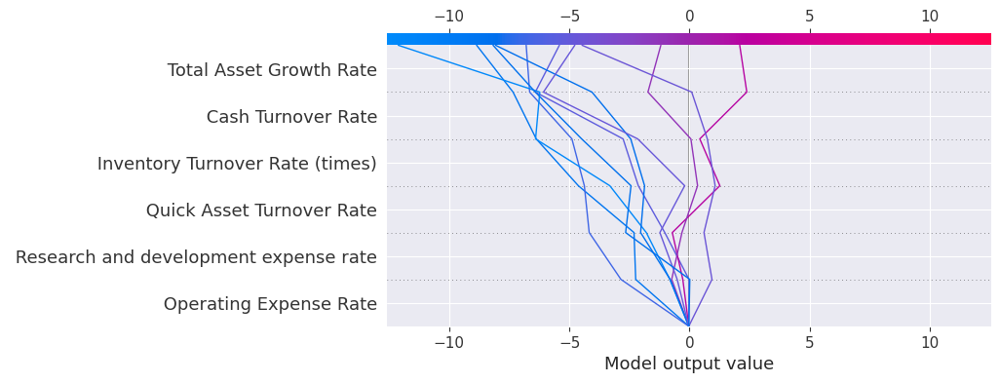

In [ ]:
# Get expected value and shap values array
expected_value = explainer.expected_value
shap_array = explainer.shap_values(X_test)

#Descion plot for first 10 observations
shap.decision_plot(expected_value, shap_array[0:10],feature_names=list(X_test.columns))

Waterfall and force plots are great for interpreting individual predictions. To understand how our model makes predictions in general we need to aggregate the SHAP values. One way to do this is using a decision plot. Above we have the code used to output the decision plot for the first 10 abalones.

we can see there are 10 lines in the plot —one for each abalone. They all start at the same base value and end at their final predicted number of rings. As you move up from each feature on the y-axis, the movement on the x-axis is given by the SHAP value for that feature. Ultimately, this gives you similar information to a waterfall plot except we can now see it for multiple observations.

With only 10 observations, we can already see some trends. For example, some of the lines seem to zig-zag at the top of the chart. For these observations, the shucked weight increases the prediction (i.e. positive SHAP) and the shell weight and whole weight decrease the prediction (i.e. negative SHAP). In other words, these features have opposite effects on the prediction. When we look at plot 5 — beeswarm, we will see that this is the case for the model in general.

An issue with this chart is that we can’t use it to visualise all the SHAP values at once. As you increase the number of observations it will become too cluttered and it will be difficult to gain any understanding of how the model works. We are limited to interpreting the SHAP values for a handful of observations.

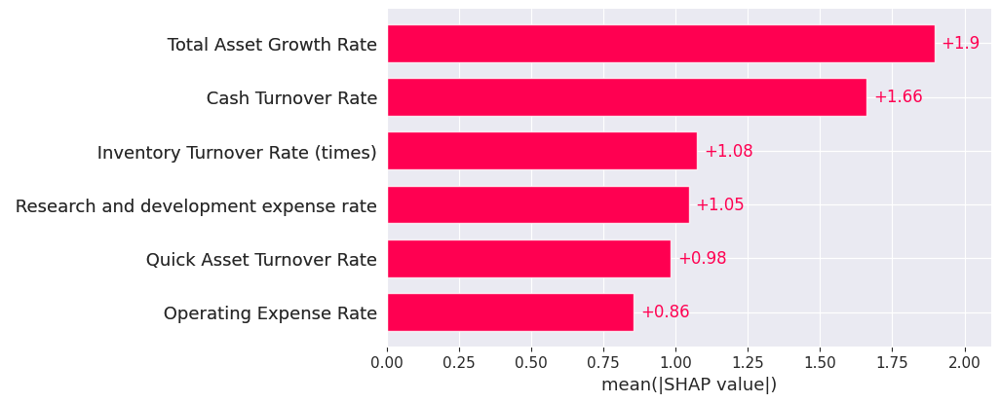

In [ ]:
#Mean SHAP
shap.plots.bar(shap_values)


Another way to aggregate the values is using a mean SHAP plot. For each feature, we calculate the mean of the absolute SHAP values across all observations. We take the absolute values as we do not want positive and negative values to offset each other. In the end, we have the bar plot above. There is one bar for each feature and we can see that shell weight had the largest mean SHAP out of all the features.

Features that have large mean SHAP values will tend to have large positive/negative SHAP values. In other words, these are the features that have a significant impact on the model’s predictions. In this sense, this plot can be used in the same way as a feature importance plot. That is to highlight features that are important to a model’s predictions. An issue is that it does not tell us anything about the nature of the relationship between features and the target variable.

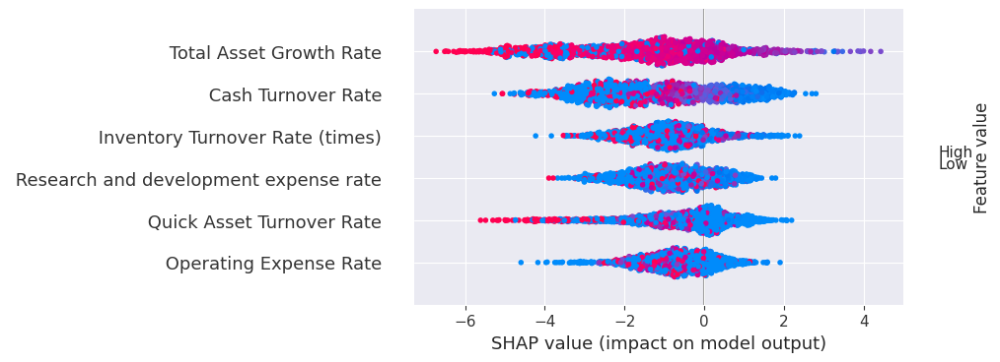

In [ ]:
# Beeswarm plot
shap.plots.beeswarm(shap_values)

Our final aggregation is the beeswarm plot. As seen in Figure, this is a plot of all the SHAP values. The values are grouped by the features on the y-axis. For each group, the colour of the points is determined by the value of the same feature (i.e. higher feature values are redder). The features are ordered by the mean SHAP values.

This plot addresses some of the issues in the previous plots. Unlike the decision plot, we can plot all the observations and still have clear interpretations. Like mean SHAP, it can be used to highlight important relationships. We can also start to understand the nature of these relationships.

# **Conclusion**

 This project aimed to develop a predictive model for company bankruptcy using machine learning techniques. Three models, namely Logistic Regression, Random Forest Classifier, and XgBoost Classifier, were trained and evaluated using various evaluation metrics.

The results of the evaluation showed that the XgBoost Classifier outperformed the other models in terms of accuracy, precision, recall, and F1-score. It achieved the highest accuracy and demonstrated a relatively higher precision for predicting the positive class (bankruptcy) compared to the other models. Although the precision and recall for the positive class were still relatively low, the XgBoost Classifier showed better performance overall.

The selected features, such as continuous interest rate, persistent EPS in the last four seasons, per-share net profit before tax, debt ratio, net worth/assets, borrowing dependency, net profit before tax/paid-in capital, net income to total assets, net income to stockholder's equity, and equity to liability, were found to have significant impact on predicting bankruptcy.



The predictions and insights derived from the bankruptcy prediction model can have valuable applications in various sectors. Companies can use these models to diagnose their current financial status and adjust their strategies accordingly. Business operators can manage their enterprises more effectively by monitoring key indicators that impact the risk of bankruptcy. Investors can modify their investment portfolios by assessing the bankruptcy risk of companies. Governments can implement macroeconomic policies and improve financial regulations based on the predictions of corporate bankruptcy.

In summary, the development of predictive models for company bankruptcy is crucial in the realm of financial analysis. By selecting appropriate methods and accurately forecasting bankruptcy risks, businesses can make informed decisions to mitigate potential financial risks and enhance their financial systems. The global financial crisis and the increasing credit risks further emphasize the importance of this field. Extensive research has been conducted to refine and improve the accuracy of bankruptcy predictions.

Overall, this project contributes to the field of advanced financial analysis by utilizing machine learning algorithms and statistical models to predict company bankruptcy.

### ***Hurrah! You have successfully completed your Machine Learning Capstone Project !!!***